In [1]:
import pynq
from pynq import Overlay
from pynq.lib import DMA
from pynq import Xlnk
from pynq import Interrupt
# from pynq import FFTDriver
# from pynq import FIRDriver

import numpy as np
import matplotlib
import math
import pandas as pd
from matplotlib import pyplot as plt
import asyncio
import scipy
from scipy.io import wavfile
from scipy.io import loadmat
import csv
from scipy.signal import lfilter, freqz, firwin
from scipy import signal, stats
import sys
import pandas as pd
sys.path.insert(0, '/home/xilinx/mne-python/')
import mne
import cffi
import timeit
import time

Welcome to the HW Accerlerated Brain to Computer Interface notebook created by Luke Slemon as part of their Engineering Final Year Project.
The purpose of this notebook is to demonstrate the PYNQ Framework's ability to operate in the field of Brain to Computer Interfaces.

** BCI System on Chip **
<img src="BCI_Top_Level1.jpg"/>
This top levels holds the central ZYNQ IP block which these very Python cells are executed.

There are also an FFT Hierarchy block which holds the FFT Channels of the System, and an FIR Hierarchy block which holds the FIR Channels.

The following cell of code holds the BCI Overlay class, which is an extended version of the Pynq Overlay used to handle the communications between the PS and the PL.
This Overlay has specific methods for running the processing steps necessary for detecting SSVEPs within the EEG data. 

In [2]:
from pynq import Overlay

"""
The BCI Overlay is a class designed to abstract the lower level hardware for programmers looking to harnace the
inherent acceleration offered by digital hardware.

The Overlay is the main entry point to the system. 
"""

class BCI_Overlay(Overlay):
    
    """
    Extracts the EEG and channel names from the MAMEM SSVEP database
    and creates a pandas dataframe
    """
    def matfile_to_dataframe(self, matfile):
        channel_names = np.array([])
        labels = matfile["info"][0][0][9][0]

        for i in labels:
            channel_names = np.append(channel_names, i[0])

        return pd.DataFrame(matfile["eeg"], channel_names).transpose(), matfile["info"][0][0][17][0][0]
    
    """
    Entry point to configure the Fast Fourier Transform IP blocks
    """
    def configure_HW_FFT(self, forwards, scaling_sched, NFFT, f_samp):
        self.FFT_Hierarchy.configure_FFT(forwards, scaling_sched, NFFT, f_samp)
        
        leds_location = self.ip_dict["axi_gpio_0"]
        self.leds = pynq.lib.AxiGPIO(leds_location).channel1
        self.led_class_values = np.array([1,2,4,8,15])
        
    """
    Entry point to configure the FIR Filter IP blocks using filter coefficients corresponding
    to the low_cut, high_cut, and f_samp parameters.
    """
    def configure_HW_FIR(self, f_samp, low_cut, high_cut, data_length):
        coefficients = self.filter_design(f_samp, low_cut, high_cut)
        self.Filter_Hierarchy.configure_FIR(coefficients, data_length)
    
    """
    Design a bandpass filter based on the input sampling rate, lowcut, and highcut frequencies
    """
    def filter_design(self, f_samp, low_cut, high_cut):
        nyq = f_samp / 2.0
        
        coeffs = firwin(150, [low_cut/nyq, high_cut/nyq], pass_zero=False)
        coeffs = np.int16(coeffs/np.max(abs(coeffs)) * 2**15 - 1) #Increase dynamic range of coefficents to be 16 bits
        self.plot_fir_response(coeffs, f_samp)
        return coeffs
    
    """
    Plot the frequency magnitude response of a set of FIR filter weights
    """
    def plot_fir_response(self, coeffs, f_samp):
        freqs, resp = freqz(coeffs, 1)
        plt.plot(freqs/math.pi, np.abs(resp))
        plt.rcParams["figure.figsize"] = (20,10)
        plt.rcParams["font.size"] = 22
        plt.title("Magnitude Response")
        plt.xlabel("Normalised Frequency (Pi radiens/sample)")
        plt.ylabel("Magnitude")
        plt.show()
    
    
    def FIFO_2D(self,data_array, new_data):
        shifted_data = np.vstack((new_data, data_array))
        print(shifted_data)
        if shifted_data.shape[0] > 4:
            shifted_data = np.delete(shifted_data, 4, 0)
        print(shifted_data)
        return shifted_data
    
    
    """
    Processing steps for multi-channel EEG
    -Pad with zeros to closest power of 2
    -Break signal to fraames
    -Filter frames
    -FFT on each Frame
    -Extract SSVEP of each frame
    """
    def pynq_BCI_DSP_multi(self, signal, NFFT, f_samp, overlap = 1, plot_data = False, Software_Test = False):
        num_channels = signal.shape[0]
        print("Number of channels: "+ str(num_channels))
        self.hits = 0
        # calculate amount of zeros to add to make up to NFFT multiple
        zeros = np.int16(np.ceil(signal.shape[1]/NFFT))*NFFT - signal.shape[1]
        print("Appending "+str(zeros.size)+" zeros to the signal")
        # increase length to multiple of NFFT
        signal = np.int64(np.append(signal, np.zeros([num_channels,zeros]),1))

        # calculate how many NFFT frames are needed to iterate through entire signal
        self.max_iters = np.int16(np.floor(signal.shape[1]/NFFT))
        print("Number of iterations "+str(self.max_iters/overlap))
        
        plt.rcParams["figure.figsize"] = (20,10)
        plt.rcParams["font.size"] = 22
        
        ptr = 0
        global processingTime_df 
        processing_start = time.time()
        for i in range(int(self.max_iters/overlap)):
            print("Iteration "+str(i))
            print("POINTER "+str(ptr)+" "+str(ptr+NFFT))
            frame_start = time.time()
            
            #Extract frame from signal
            frame = signal[:,ptr:ptr+NFFT]
            if Software_Test:
                #Test run tine of ssvep detection in software
                frame_filt = lfilter(coeffs, 1.0, frame) 
                fft_complex = scipy.fft(frame_filt, n=NFFT)

            else:

                frame_filt = self.Filter_Hierarchy.filter_signal(frame, multi_channel=True)
                fft_complex = self.FFT_Hierarchy.fft_hw(frame_filt, NFFT, multi_channel=True)

            #Plot Frame
            if plot_data:
                self.plot_fft_spectrum_multi(fft_complex, f_samp, "PSD of multiple Channels")
            else:
                self.detect_ssvep_multi(self.to_freq_dataframe_multi(np.abs(fft_complex)**2, f_samp), fft_complex.shape[0])

            df_duration = pd.DataFrame([[ptr, time.time()-processing_start, time.time()-frame_start]], columns=["Data Pointer","Time stamp", "Frame Duration"])
            processingTime_df = processingTime_df.append(df_duration, ignore_index=True)
            #Increase Pointer
            ptr = ptr + int(NFFT*overlap)
    """
    Processing steps for single channel EEG.
    -Pad with zeros to closest power of 2
    -Break signal to fraames
    -Filter frames
    -FFT on each Frame
    -Extract SSVEP of each frame
    """
    def pynq_BCI_DSP(self, signal, NFFT, f_samp, multichannel=False, overlap = 1, plot_data=False, Software_Test=False):
        if multichannel:
            self.pynq_BCI_DSP_multi(signal, NFFT, f_samp, overlap=overlap, plot_data=plot_data, Software_Test=Software_Test)
            return
        
        #calculate amount of zeros to add to make up to NFFT multiple
        zeros = np.int16(np.ceil(len(signal)/NFFT))*NFFT - len(signal)
        print("Appending "+str(zeros.shape)+" zeros to the signal")
        # increase length to multiple of NFFT
        signal = np.int64(np.append(signal, np.zeros(zeros)))
        
        # calculate how many NFFT frames are needed to iterate through entire signal
        self.max_iters = np.int16(np.floor(len(signal)/NFFT))
        print("Number of iterations "+str(self.max_iters/overlap))
        self.hits = 0
        ptr = 0
        global processingTime_df 
        
        processing_start = time.time()
        for i in range(int(self.max_iters/overlap)):
            print("Iteration "+str(i))
            print("POINTER "+str(ptr)+" "+str(ptr+NFFT))
            
            frame_start = time.time()
            #Extract frame from signal
            frame = signal[ptr:ptr+NFFT]

            #Filter Frame
            if Software_Test:
                start = time.time()
                frame_filt = lfilter(coeffs, 1.0, frame)
                print("SW FIR: "+str(time.time() - start))
                start=time.time()
                fft_complex = scipy.fft(frame_filt, n=NFFT)
                print("SW FFT: "+str(time.time() - start))
            
            else:
                start = time.time()
                frame_filt = self.Filter_Hierarchy.filter_signal(frame, multi_channel=False)
                print("HW FIR: "+str(time.time() - start))
                start = time.time()
                fft_complex = self.FFT_Hierarchy.fft_hw(frame_filt, NFFT, multi_channel=False)
                print("HW FFT: "+str(time.time() - start))
                
            if plot_data:
                plt.plot(frame)
                plt.title("Unfiltered Signal")
                plt.xlabel("Samples (n)")
                plt.ylabel("Amplitude")
                plt.show()
                plt.plot(frame_filt)
                plt.title("Filtered Signal")
                plt.xlabel("Samples (n)")
                plt.ylabel("Amplitude")
                plt.show()
                self.plot_fft_spectrum(fft_complex, f_samp, "PSD of a Single Channel")
            else:
                self.detect_ssvep(self.to_freq_dataframe(np.abs(fft_complex)**2, f_samp))
            
            df_duration = pd.DataFrame([[ptr, time.time()-processing_start, time.time()-frame_start]], columns=["Data Pointer","Time stamp", "Frame Duration"])
            processingTime_df = processingTime_df.append(df_duration, ignore_index=True)
            ptr = ptr + int(NFFT*overlap)
    
    """
    Plot the frequency spectrum for multi channel BCI
    """
    def plot_fft_spectrum_multi(self, fft_complex, f_samp, channel_name):
        
        fft_magnitude = np.abs(fft_complex)
        
        channel_names = ["ChannelP7","ChannelO1", "ChannelO2", "ChannelP8"]
        dataframe_power = self.to_freq_dataframe_multi(20*np.log10(fft_magnitude/fft_complex.shape[1]), f_samp)
        dataframe_energy = self.to_freq_dataframe_multi(fft_magnitude**2, f_samp)
        
        freqs = dataframe_power["freq"]
        
        plt.rcParams["figure.figsize"] = (20,10)
        plt.rcParams["font.size"] = 22

        for i in range(fft_complex.shape[0]):
            plt.plot(freqs, dataframe_power["amplitude"+str(i+1)], label=channel_names[i])            
            
        plt.title(channel_name)
        plt.xlabel("Frequency (Hz)")
        plt.ylabel("Power (dB)")
        plt.legend()
        plt.grid()
        plt.show()
        
        self.detect_ssvep_multi(dataframe_energy, fft_complex.shape[0])
        
    
    """
    Plot the frequency spectrum for single channel BCI
    """
    def plot_fft_spectrum(self, fft_complex, f_samp, channel_name, multichannel = False):
        if multichannel:
            self.plot_fft_spectrum_multi(fft_complex, f_samp, channel_name)
        
        fft_magnitude = np.abs(fft_complex)
        
#         dataframe_power = self.to_freq_dataframe(20*np.log10(fft_magnitude/len(fft_complex)), f_samp)
        dataframe_power = self.to_freq_dataframe(20*np.log10(fft_magnitude), f_samp)
        dataframe_energy = self.to_freq_dataframe(fft_magnitude**2, f_samp)
        
        freqs = dataframe_power["freq"]
        amps = dataframe_power["amplitude"]
        
        plt.rcParams["figure.figsize"] = (20,10)
        plt.rcParams["font.size"] = 22
        plt.plot(freqs, amps)
      
        print("Begin Detecting SSVEP")
        freq_index, harmonic_index = self.detect_ssvep(dataframe_energy)
        if freq_index != None:
            freq = freqs[freq_index]
            harmonic = freqs[harmonic_index]
            max_amp = amps.max()
            freq_amp = amps[freq_index]
            harmonic_amp = amps[harmonic_index]
#             plt.stem([freq], [freq_amp], color='y')
#             plt.stem([harmonic], [harmonic_amp], color='y')
            plt.text(freq, freq_amp, "{:.2f}".format(freqs[freq_index])+" Hz")
            plt.text(harmonic, harmonic_amp, "{:.2f}".format(freqs[harmonic_index])+" Hz")
            
            
        plt.title(channel_name)
        plt.xlabel("Frequency (Hz)")
        plt.ylabel("Power (dB)")
        plt.legend()
        plt.grid()
        plt.show()
    
    """
    Extract the SSVEP for each channel, vote which one would be the best
    """
    def detect_ssvep_multi(self, data_frames, num_channels):
        
        freqs = data_frames["freq"]
        
        max_peaks = np.empty((4, 5), np.ndarray)
        max_indices = np.empty(4, np.int)
        amps = []
        peaks = np.array([])
        
        #Get the highest average for each channel
        for i in range(num_channels):
            
            amps = data_frames["amplitude"+str(i+1)]
        
            peak5 = amps[np.logical_and(freqs >= 6.5, freqs <= 6.6)]
            peak4 = amps[np.logical_and(freqs >= 7.5, freqs <= 7.6)]
            peak3 = amps[np.logical_and(freqs >= 8.5, freqs <= 8.6)]
            peak2 = amps[np.logical_and(freqs >= 10, freqs <= 10.1)]
            peak1 = amps[np.logical_and(freqs >= 12, freqs <= 12.1)]

            peak5_harm = amps[np.logical_and(freqs >= 13.2, freqs <= 13.3)]
            peak4_harm = amps[np.logical_and(freqs >= 15, freqs <= 15.1)]
            peak3_harm = amps[np.logical_and(freqs >= 17, freqs <= 17.2)]
            peak2_harm = amps[np.logical_and(freqs >= 20, freqs <= 20.1)]
            peak1_harm = amps[np.logical_and(freqs >= 24, freqs <= 24.1)]

            peaks = np.array([
                peak1.iloc[0],
                peak2.iloc[0],
                peak3.iloc[0],
                peak4.iloc[0],
                peak5.iloc[0]])

            peaks_harm = np.array([
                peak1_harm.iloc[0],
                peak2_harm.iloc[0],
                peak3_harm.iloc[0],
                peak4_harm.iloc[0],
                peak5_harm.iloc[0]])    

            avg_peaks = (peaks + peaks_harm)/2
            
            max_peaks[i] = avg_peaks
            max_avg_peak = avg_peaks.max()
            max_ = np.where(avg_peaks == max_avg_peak)[0]
            if max_.size == 1:
                max_indices[i] = max_      
        
        #get the mode channel output
        mode_idx, counts = stats.mode(max_indices)
        print("Channel Ouput: "+str(max_indices + 1))
        print("Mode: "+str(mode_idx))
        print("Counts: "+str(counts))
        
        #only output if the mode has 3 or more occurances
        if counts[0] > 2:
            self.leds[0:4].write(int(self.led_class_values[int(mode_idx[0])]))
            print("Detected Class: "+str(mode_idx[0]+1))
            self.hits = self.hits + 1
        
        else:
            self.leds[0:4].write(0)
        
        return None, None
    
    """
    Extract SSVEP from the Frequency content of the signal.
    """
    def detect_ssvep(self, data_frame):
        
        freqs = data_frame["freq"]
        amps = data_frame["amplitude"]
        
        #Power at each stimulus frequency
        peak5 = amps[np.logical_and(freqs >= 6.5, freqs <= 6.6)]
        peak4 = amps[np.logical_and(freqs >= 7.5, freqs <= 7.6)]
        peak3 = amps[np.logical_and(freqs >= 8.5, freqs <= 8.6)]
        peak2 = amps[np.logical_and(freqs >= 10, freqs <= 10.1)]
        peak1 = amps[np.logical_and(freqs >= 12, freqs <= 12.1)]
        
        #Power at each first harmonic of the stimulus frequency
        peak5_harm = amps[np.logical_and(freqs >= 13.2, freqs <= 13.3)]
        peak4_harm = amps[np.logical_and(freqs >= 15, freqs <= 15.1)]
        peak3_harm = amps[np.logical_and(freqs >= 17, freqs <= 17.2)]
        peak2_harm = amps[np.logical_and(freqs >= 20, freqs <= 20.1)]
        peak1_harm = amps[np.logical_and(freqs >= 24, freqs <= 24.1)]
        
        peaks = np.array([
            peak1.iloc[0],
            peak2.iloc[0],
            peak3.iloc[0],
            peak4.iloc[0],
            peak5.iloc[0]])
        
        print("Fundamental Frequency Peaks")
        print(peaks)

        peaks_harm = np.array([
            peak1_harm.iloc[0],
            peak2_harm.iloc[0],
            peak3_harm.iloc[0],
            peak4_harm.iloc[0],
            peak5_harm.iloc[0]])    
        
        print("1st Harmonic Frequency Peaks")
        print(peaks_harm)
        
        #Average of both power values
        avg_peaks = (peaks + peaks_harm)/2

        print("\n")

        print("AVG PEAK 5 "+str(avg_peaks[4]))
        print("AVG PEAK 4 "+str(avg_peaks[3]))
        print("AVG PEAK 3 "+str(avg_peaks[2]))
        print("AVG PEAK 2 "+str(avg_peaks[1]))
        print("AVG PEAK 1 "+str(avg_peaks[0]))
        
        #Thresholding above the value 900
        if avg_peaks.max() > 900:
            max_idx = np.where(avg_peaks == avg_peaks.max())
            index_freq = pd.Index(amps).get_loc(peaks[max_idx][0])
            index_harm = pd.Index(amps).get_loc(peaks_harm[max_idx][0])
            self.leds[0:4].write(int(self.led_class_values[int(max_idx[0])]))
            print("Detected Class: "+str(max_idx[0]+1))
        
        else:
            max_idx = None
            index_freq = None
            index_harm = None
        
        if type(index_freq) != int or type(index_harm) != int:
            max_idx = None
            index_freq = None
            index_harm = None
        else:
            self.hits = self.hits + 1
        
        #Return the index of the frequency and harmonic
        return index_freq, index_harm
    
    def to_freq_dataframe(self, samples, fs):
        """Create a pandas dataframe from an ndarray frequency domain samples"""
        sample_freqs = np.linspace(0, fs, len(samples))
        return pd.DataFrame(dict(
            amplitude = samples[0:int(len(samples)/2)],  
            freq      = sample_freqs[0:int(len(samples)/2)]
        ))
    
    def to_freq_dataframe_multi(self, samples, fs):
        """Create a pandas dataframe from an ndarray frequency domain samples"""
        sample_freqs = np.linspace(0, fs, samples.shape[1]+1)
        
        channel_dict = dict()
        channel_dict["freq"] = sample_freqs[0:int(samples.shape[1]/2)]
        for i in range(samples.shape[0]):
            channel_dict["amplitude"+str(i+1)] = samples[i, 0:int(samples.shape[1]/2)]
            
        return pd.DataFrame(channel_dict)

** FFT Hierarchy **
<img src="FFT_Hierarchy.jpg"/>
The FFT Hierarchy contains the necessary components for routing data between ZYNQ IP block and the FFT Channel Hierarchies. 

The cell below contains the FFT Hierarchy driver code.

This code has references to the FFT Channel drivers and is responsible for
* configuring the channels to match user specified parameters, i.e.
    * Scaling Schedule.
    * NFFT.
    * Forward/Inverse FFT.
* reading in signal data from PYNQ IP block.
* passing signal data to the channels.
* moving data from channels to PYNQ IP block.

In [3]:
from pynq import DefaultHierarchy

"""
FFT Hier is a wrapper for the FFT Hardware Hierarchy.
The FFT Hierarchy contains the IP blocks necessary for performing an FFT on each channel.
"""
class FFT_Hier(DefaultHierarchy):
    def __init__(self, description):
        super().__init__(description)
        self.xlnk = Xlnk()
    
    """
    Configure FFT Hierarchy
    """
    def configure_FFT(self, forwards, scaling_sched, NFFT, f_samp):        
        
        #Attribute - Sampling frequency
        self.f_samp = f_samp   
        #Atrribute - FFT channels
        self.channels = [self.FFT_channelP7, self.FFT_channelO1, self.FFT_channelO2, self.FFT_channelP8]
        self.num_channels = len(self.channels)
        
        #Instantiate Buffers in DDR
        self.fft_in_buffers = [None]*self.num_channels
        self.fft_out_buffers = [None]*self.num_channels
        for i in range(self.num_channels):
            self.fft_in_buffers[i] = self.xlnk.cma_array(shape=(NFFT,),dtype= np.int64)
            self.fft_out_buffers[i] = self.xlnk.cma_array(shape=(NFFT*2,),dtype= np.int32)
        
        #Configure each FFT Channel
        for chan in self.channels:
            chan.configure_fft(forwards, scaling_sched, int(math.log2(NFFT)), f_samp)
        print("FFT Configuration Complete")
    
    """
    Perform Fast Fourier Transform on the Signal
    Either single or multiple channels
    """
    def fft_hw(self, signal, NFFT, multi_channel = False, channel_num = 0):    
        if multi_channel:
            return self.fft_hw_multi(signal, NFFT)
        
        #If single channel, use the Driver based FFT
        return self.channels[channel_num].fft_hw(signal, NFFT)
    
    """
    Fast Fourier Transform for multiple channels
    """
    def fft_hw_multi(self, signal, NFFT):
        #If signal longer than NFFT, cut off the excess samples
        if signal.size > NFFT:
            signal = signal[:,0: NFFT]
        
        # If signal is lower than NFFT, pad zeros to increase it's length
        zeros = np.int16(np.ceil(signal.shape[1]/NFFT))*NFFT - signal.shape[1]
        # increase length to NFFT
        signal = np.int64(np.append(signal, np.zeros([self.num_channels,zeros]),1))
        
        #Copy the data from each channel to individual in buffers
        #Send the in buffers to the hardware
        #Send the empty out buffers to the hardware to be filled when FFT is complete 
        for i in range(self.num_channels):
            np.copyto(self.fft_in_buffers[i], signal[i])
            self.channels[i].DMA_DATA.sendchannel.transfer(self.fft_in_buffers[i])
            self.channels[i].DMA_DATA.recvchannel.transfer(self.fft_out_buffers[i])
        
        #Making each channel wait will block the programme until 
        #the FFT is complete
        for i in range(self.num_channels):
            self.channels[i].DMA_DATA.sendchannel.wait()
            self.channels[i].DMA_DATA.recvchannel.wait()
            
        fft_out = np.array(self.fft_out_buffers)
        
        #Each output channel is converter to complex number
        return np.array([self.to_complex_number(fft_out[0]),
           self.to_complex_number(fft_out[1]),
           self.to_complex_number(fft_out[2]),
           self.to_complex_number(fft_out[3])])
    
    """
    Converts an array of 64bit values to 32bit complex numbers
    """
    def to_complex_number(self, hw_fft_words):
        return np.int32(hw_fft_words[0::2])+1j*np.int32(hw_fft_words[1::2])
  
    """
    Method for checking if Hardware Hierarchy
    belongs to this class
    """
    @staticmethod
    def checkhierarchy(description):
        if 'FFT_Hierarchy' in description['fullpath'] and any(["FFT_channel" in key for key in description['hierarchies'].keys()]):
            return True
        return False

** FIR Filter Hierarchy **
<img src="FIR_Hierarchy1.jpg"/>
The FIR Hierarchy contains the necessary components for routing data between ZYNQ IP block and the FIR Channel Hierarchies. 

The cell below contains the FIR Hierarch driver code.

This code has references to the FIR Channel drivers and is responsible for
* configuring the channels to match user specifed paramters, i.e.
    * FIR Filter Coefficients.
* reading in signal data from PYNQ IP block.
* passing signal data to the channels.
* moving data from channels back to PYNQ IP block.

In [4]:
from pynq import DefaultHierarchy

"""
FIR Hier is a wrapper for the FIR Hierarchy.
The FIR Hierarchy contains the IP blocks necessary for filtering multiple channels.
"""
class FIR_Hier(DefaultHierarchy):
    def __init__(self, description):
        super().__init__(description)
        self.xlnk = Xlnk()
    
    """
    Configure the FIR Hierarchy
    """
    def configure_FIR(self, coefficients, data_length):        
        
        #Attribute - array of channels
        self.channels = [self.FIR_channelP7, self.FIR_channelO1, self.FIR_channelO2, self.FIR_channelP8]
        #Attribute - data length -> can only filter signals at this length
        self.data_length = data_length
        #Attribute - number of channels
        self.num_channels = len(self.channels)
        
        #Instantiate buffers in DDR
        self.fir_in_buffers = [None]*self.num_channels
        self.fir_out_buffers = [None]*self.num_channels
        
        for i in range(self.num_channels):
            self.fir_in_buffers[i] = self.xlnk.cma_array(shape=(self.data_length,),dtype= np.int32)
            self.fir_out_buffers[i] = self.xlnk.cma_array(shape=(self.data_length,),dtype= np.int32)
        
        #Configure each channel
        for chan in self.channels:
            chan.configure_filter(coefficients)
        print("FIR Configuration Complete")
    
    """
    Filter the signal.
    Either single or multi channel filtering.
    """
    def filter_signal(self, signal, multi_channel = False, channel_num = 0):
        if multi_channel:
            return self.fir_hw_multi(signal)
        #If single channle use the FIR Driver filter methods
        return self.channels[channel_num].filter_signal(signal)
    
    """
    Filter multiple EEG channels.
    """
    def fir_hw_multi(self, signal):
        
        if signal.size > self.data_length:
            signal = signal[:,0: self.data_length]
        
        # If signal is lower than configured data length, pad zeros to increase it's length
        zeros = np.int16(np.ceil(signal.shape[1]/self.data_length))*self.data_length - signal.shape[1]
        # increase length to data length 
        signal = np.int64(np.append(signal, np.zeros([self.num_channels,zeros]),1))
        
        #Copy the data from each channel to individual in buffers
        #Send the in buffers to the hardware
        #Send the empty out buffers to the hardware to be filled when FIR is complete 
        for i in range(self.num_channels):
            np.copyto(self.fir_in_buffers[i], signal[i])
            self.channels[i].DATA_DMA.sendchannel.transfer(self.fir_in_buffers[i])
            self.channels[i].DATA_DMA.recvchannel.transfer(self.fir_out_buffers[i])
        
        #Make each DMA channel wait
        #Wait will block until the tranfers are complete.
        for i in range(self.num_channels):
            self.channels[i].DATA_DMA.sendchannel.wait()
            self.channels[i].DATA_DMA.recvchannel.wait()
        
        fir_out = np.array(self.fir_out_buffers)
        #FIR output multiplied by 100 to ensure it's dyanmic range suits
        return np.asarray(fir_out*100, np.int32)
        
    """
    Method for checking if Hardware Hierarchy
    belongs to this class
    """
    @staticmethod
    def checkhierarchy(description):
        if 'Filter_Hierarchy' in description['fullpath'] and any(["FIR_" in key for key in description['hierarchies'].keys()]):
            return True
        return False

** FFT Channel Driver **
<img src="FFT_Driver.jpg"/>
The cell below holds the FFT Channel drivers.

The FFT Channel contains;
* Direct Memory Access (DMA) Components
    * Request data from allocated buffers in the External Memory.
    * Stream the requested data to the FFT Block.  
* FFT Block
    * IP core for performing a Fast Fourier Transform on an input Stream of data.

The Data DMA handles;
* streaming signal data from the external memory to the FFT Block
* reading the output data from the FFT Block and streaming it back to the External memory

The Config DMA streams in a single 32 bit word to configure the FFT:
* [4:0] - NFFT
* [8:8] - Forward/Inverse FFT
* [20:9] - Scaling Schedule
    * How each stage of the FFT is scaled to ensure no overflows occur.

In [5]:

"""
FFT Driver is wrapper for the FFT Channel Hardware
"""
class FFTDriver(DefaultHierarchy):
    def __init__(self, description):
        super().__init__(description)
        self.xlnk = Xlnk()
    
    """
    Configure the FFT channel
    """
    def configure_fft(self, forwards, scaling_sched, NFFT, f_samp):
        self.f_samp = f_samp
        
        self.fft_out = np.zeros(NFFT*2) 
        self.counter = 0
        
        config_bits = 0
        for scaling in scaling_sched:     # [20:9] = scaling schedule        
            config_bits = (config_bits << 2)

            config_bits = config_bits + scaling

        config_bits = (config_bits << 1) # [8:8] = forward/inverse fft
        config_bits = config_bits + int(forwards)
        
        config_bits = (config_bits << 8) 
        config_bits = config_bits + NFFT #[0:4] = NFFT
        #Create a single 
        config_buffer = self.xlnk.cma_array(shape=(1,), dtype=np.int16)
#         config_buffer = self.xlnk.cma_array(shape=(1,), dtype=np.int32)
        config_buffer[0] = config_bits
        
        self.DMA_CONFIG.sendchannel.transfer(config_buffer)    
        self.DMA_CONFIG.sendchannel.wait()
    
    
    """
    Perform a hardware FFT on a single channel
    """
    def fft_hw(self, signal, NFFT):

        if signal.size > NFFT:
            signal = signal[0: NFFT]

        # calculate amount of zeros to add to make up to NFFT multiple
        zeros = np.int16(np.ceil(len(signal)/NFFT))*NFFT - len(signal)
        
        # increase length to multiple of NFFT
        signal = np.int64(np.append(signal, np.zeros(zeros)))
        
        fft_in_buffer = self.xlnk.cma_array(shape=(NFFT,),dtype=np.int64)
        fft_out_buffer = self.xlnk.cma_array(shape=(NFFT*2,),dtype=np.int32)
        np.copyto(fft_in_buffer, signal)

        start = time.process_time()
        self.DMA_DATA.sendchannel.transfer(fft_in_buffer)
        self.DMA_DATA.recvchannel.transfer(fft_out_buffer)
        
        self.DMA_DATA.sendchannel.wait()
        self.DMA_DATA.recvchannel.wait()

        print("HW FFT excl Transfer latencies: "+str(time.process_time() - start))
        fft_out = np.array(fft_out_buffer)    
    
        fft_out_buffer.close()
        fft_in_buffer.close()
         
        return self.to_complex_number(fft_out)

    def to_complex_number(self, hw_fft_words):
        return np.int32(hw_fft_words[0::2])+1j*np.int32(hw_fft_words[1::2])

    
    """
    Method for checking if Hardware Hierarchy
    belongs to this class
    """
    @staticmethod
    def checkhierarchy(description):    
        if "FFT_Hierarchy/FFT_channel" in description["fullpath"] \
           and 'DMA_DATA' in description['ip'].keys():
                
            return True
        return False


** FIR Filter Channel Driver **
<img src="FIR_Driver.jpg"/>
The cell below holds the FIR Filter Channel Driver code.
The FIR Filter Channel contains;
* Direct Memory Access (DMA) Components;
    * Request Data from the External Memory and streams it to the FIR Filter core.
    * Reads the output of the FIR Filter core and streams it to another allocated buffer within the external memory
* FIR FIlter Compiler;
    * Load in a set of filter coefficients.
    * Filter the input data based on those filter coefficients.
    
The Reload DMA;
* Loads in a set of Filter coefficents to the Filter.
* Coefficients must be signed 16bit values.

The Config DMA;
* Loads in a syncronising byte.
* When a single byte is loaded, triggers the FIR Compiler to reset the filter coefficients to the newly loaded ones.

The Data DMA;
* Streams signal data to the FIR Core.
* Streams the output back to the External Memory.

In [6]:
class FIR_Filter_Driver(DefaultHierarchy):
    
    def __init__(self, description):
        super().__init__(description)
        self.xlnk = Xlnk()
        self.configured = False
    
    def configure_filter(self, coefficients):
        coefficients = coefficients[0:int(len(coefficients)/2)+1] # 1/2 + 1 weights
        
        if self.configured:
                print("Filter has already been configured\nKernel must be restarted to reconfigure")
                return
        
        # Create DMA buffer for coefs
        fir_buffer_reload = self.xlnk.cma_array(shape=(len(coefficients),),dtype=np.int16)
        
        np.copyto(fir_buffer_reload, coefficients)

        # Transfer coefficients to FIR
        self.RELOAD_DMA.sendchannel.transfer(fir_buffer_reload)
        self.RELOAD_DMA.sendchannel.wait()

        # Send an empty 8-bit packet to FIR config port to complete reload
        fir_buffer_config = self.xlnk.cma_array(shape=(1,),dtype=np.int8)
        fir_buffer_config[0] = 0
        self.CONFIG_DMA.sendchannel.transfer(fir_buffer_config)
        self.CONFIG_DMA.sendchannel.wait()
        
        # Close the buffers
        fir_buffer_reload.close()
        fir_buffer_config.close()

        self.configured = True
        
    def filter_signal(self, signal):
         # Create DMA buffer
        fir_in_buffer = self.xlnk.cma_array(shape=(len(signal),),dtype=np.int32)
        fir_out_buffer = self.xlnk.cma_array(shape=(len(signal),),dtype=np.int32)

        # Copy aud_hw to buffer
        np.copyto(fir_in_buffer, signal)

        # Transfer
        start = time.time()
        self.DATA_DMA.sendchannel.transfer(fir_in_buffer)
        self.DATA_DMA.recvchannel.transfer(fir_out_buffer)
        self.DATA_DMA.sendchannel.wait()
        self.DATA_DMA.recvchannel.wait()
        print("HW FIR excl Transfer latencies: "+str(time.time() - start))
        fir_out = np.array(fir_out_buffer)
        return np.asarray(fir_out*100, np.int32)

    """
    Method for checking if Hardware Hierarchy
    belongs to this class
    """
    @staticmethod
    def checkhierarchy(description):
        if "Filter_Hierarchy/FIR_channel" in description['fullpath'] \
           and 'DATA_DMA' in description['ip'].keys():
            return True
        return False


** System Overview **
<img src = "Final Architecture Version 2.png" alt = "drawing" width = "500"/>

The System on Chip represented above is divided into two sections;
* The Processessing System (PS)
    * Has a two core processor which the Linux OS, the Jupytr notebooks server, and the code in this Juptyr Notebook, all runs on.
    * Drivers created are run on the PS, and these drivers will interact with the PL.
* The Programmable Logic (PL)
    * A network of transistors which can be configured to help accelerate Digital Signal Processing systems.
    
The BCI Overlay Object should represent this system of components within the ZYNQ chip.

In [7]:
overlay = BCI_Overlay("version3.bit")


<img src ="BCI Abstract.png" style="float: left;">

The entire system first needs to be configured for the required task of extracting the stimulus frequency the subject is focusing on (an SSVEP).

An SSVEP is occilatory activity in the visual cortex of the brain which mimics the frequency of the stimulus the subject is focusing on.

The FFT is configured to be a 512 point forward FFT with a scaling schedule of [2, 3, 3, 3, 3, 3].

The FIR Filter is configured to be a band pass filter allowing signals between 5 and 48 Hz to pass. This should aid to remove any high frequency muscle artefacts and low frequency eye artefacts.

FFT Configuration Complete


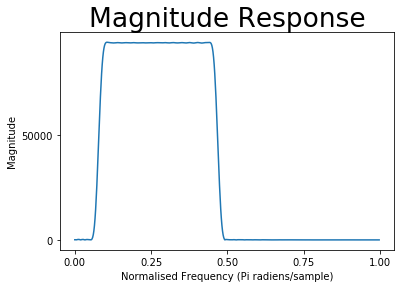

FIR Configuration Complete


In [8]:
N = 9
NFFT = 2**9
matfile = loadmat("/home/xilinx/assets/eeg_data/U001bi.mat")
eeg, f_samp = overlay.matfile_to_dataframe(matfile)

overlay.configure_HW_FFT(True, [ 2, 3, 3, 3, 3, 3], NFFT, f_samp)
overlay.configure_HW_FIR(f_samp, 5, 30, NFFT)

** Processing Steps **

<img src = "Accelerator Abstract.png" alt="drawing" width = "500"/>

In order to detect the SSVEP, the signal needs to be;
* Pre-Processed by filtering out noise using the Hardware FIR Band Pass Filter.
* Feature extraction in order to classify which SSVEP frequency is detected.
    * Fast Fourier Transform for estimating the Power Spectral Density of the signal.
    * Peaks at the stimulus frequencies and their first harmonics are the features.
    * The max average of these two peeks is the detected stimulus.

<img src ="Epoch.png" alt="drawing" width="500"/>

The whole data is not filtered and processed all at once.  
Lead to vital features being drowned out by the background noise.  
Instead, the full signal is broken into epochs/blocks of 512 samples (4 seconds).  

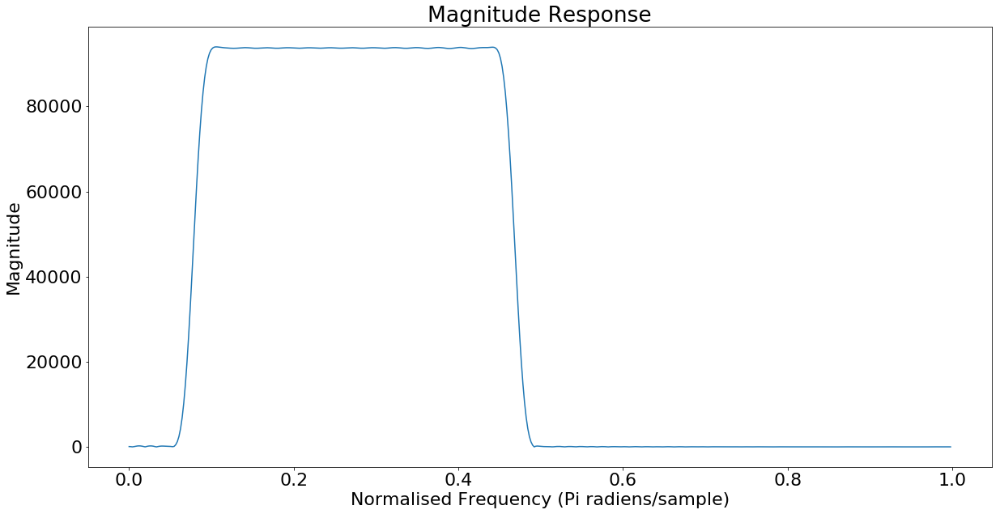

Appending () zeros to the signal
Number of iterations 36.0
Iteration 0
POINTER 0 512
HW FIR excl Transfer latencies: 0.6928236484527588
HW FIR: 0.764491081237793
HW FFT excl Transfer latencies: 0.3587550190000002
HW FFT: 0.7772078514099121


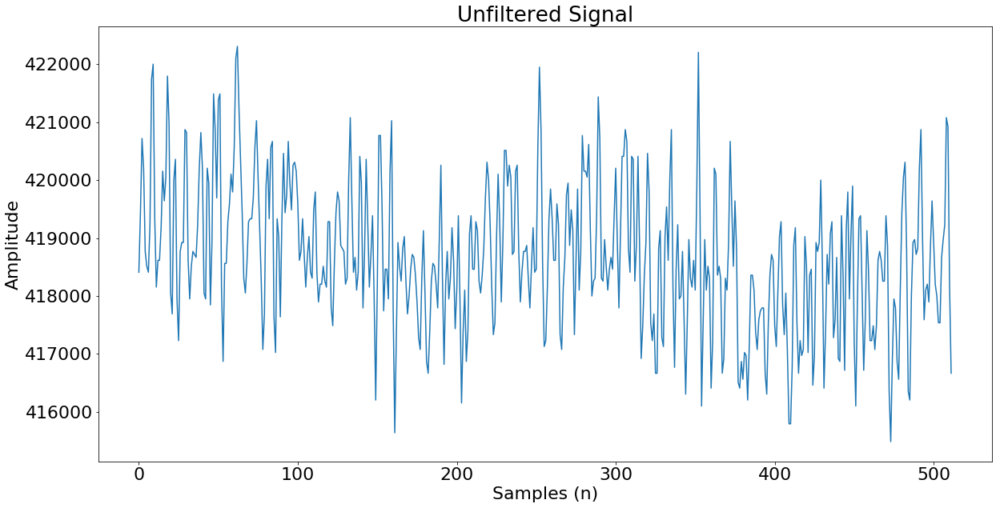

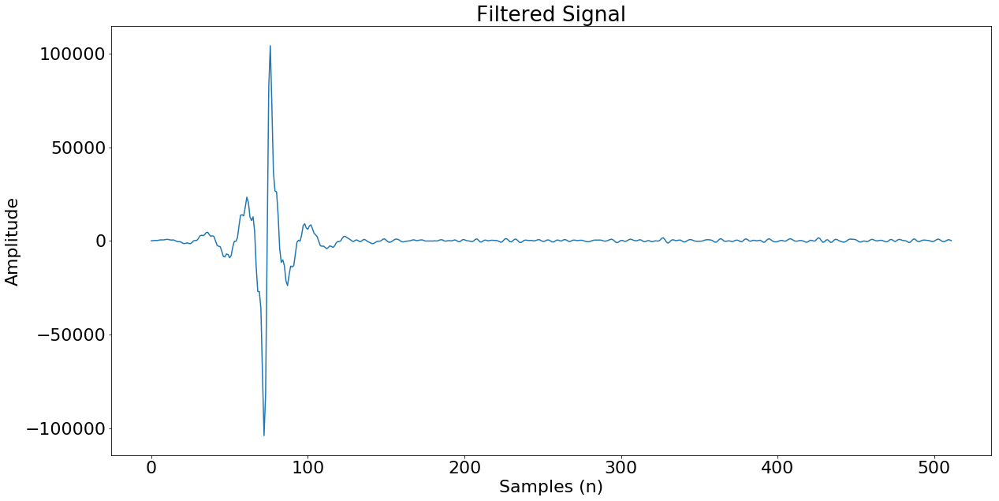

/usr/lib/python3/dist-packages/ipykernel_launcher.py:242: RuntimeWarning: divide by zero encountered in log10


Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 139597.  220090.  316852.  365320.  494570.]
1st Harmonic Frequency Peaks
[  41797.   56509.   74981.   88978.  124658.]


AVG PEAK 5 309614.0
AVG PEAK 4 227149.0
AVG PEAK 3 195916.5
AVG PEAK 2 138299.5
AVG PEAK 1 90697.0
Detected Class: [5]


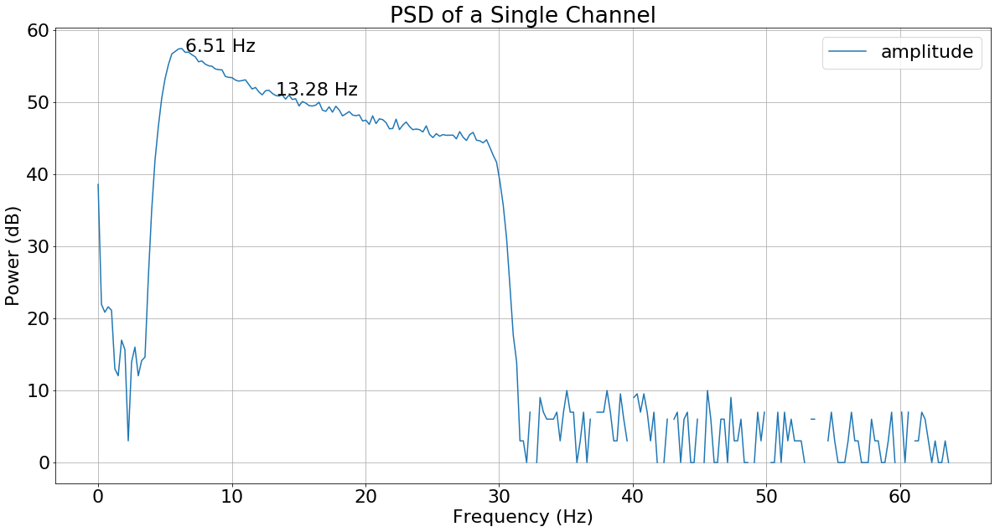

Iteration 1
POINTER 128 640
HW FIR excl Transfer latencies: 0.003198385238647461
HW FIR: 0.07773900032043457
HW FFT excl Transfer latencies: 0.000970612000003257
HW FFT: 0.08681964874267578


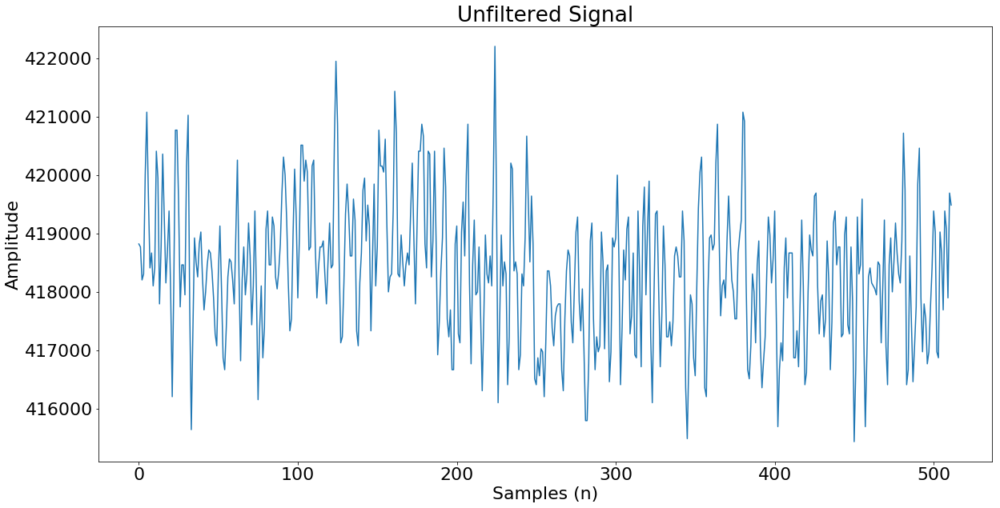

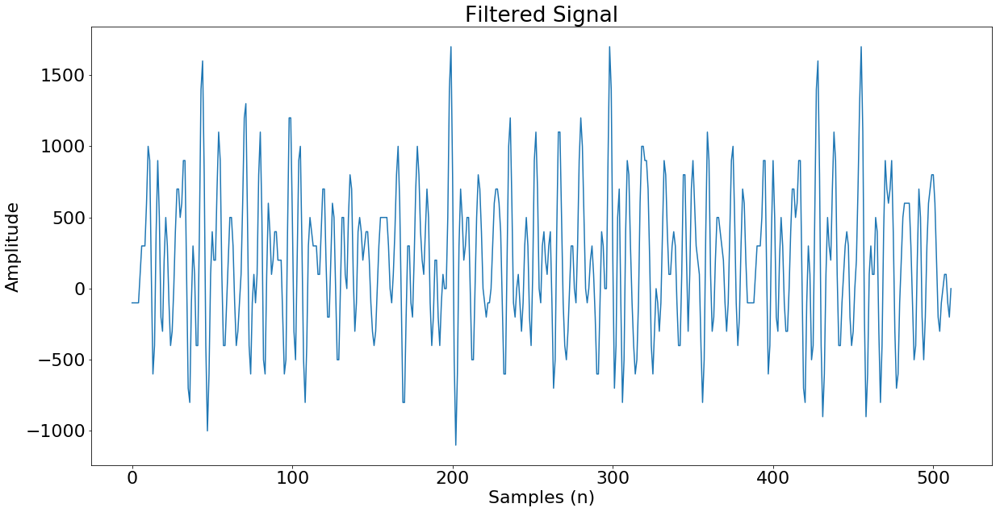

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  85.  173.   34.  538.  425.]
1st Harmonic Frequency Peaks
[ 1088.   325.   193.  1192.   185.]


AVG PEAK 5 305.0
AVG PEAK 4 865.0
AVG PEAK 3 113.5
AVG PEAK 2 249.0
AVG PEAK 1 586.5


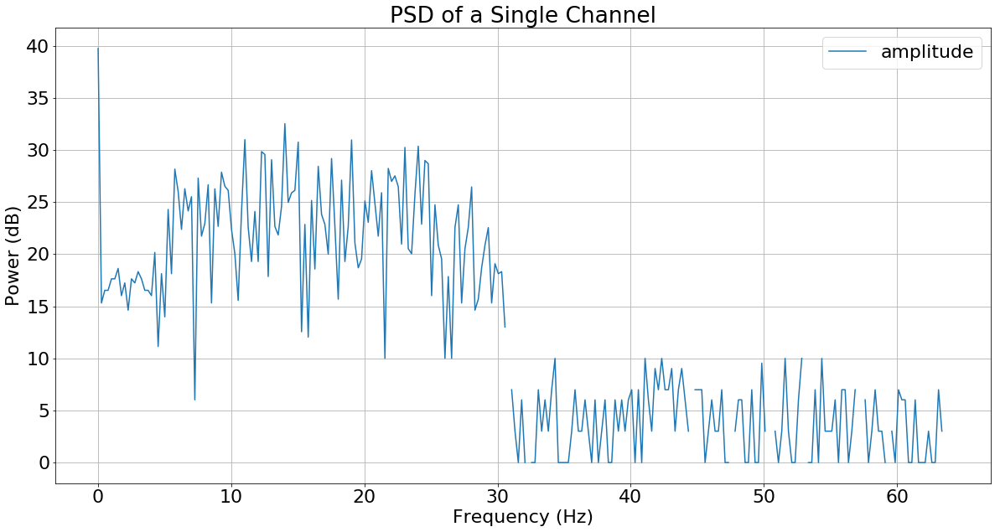

Iteration 2
POINTER 256 768
HW FIR excl Transfer latencies: 0.0009772777557373047
HW FIR: 0.08954286575317383
HW FFT excl Transfer latencies: 0.0008677200000022367
HW FFT: 0.4560658931732178


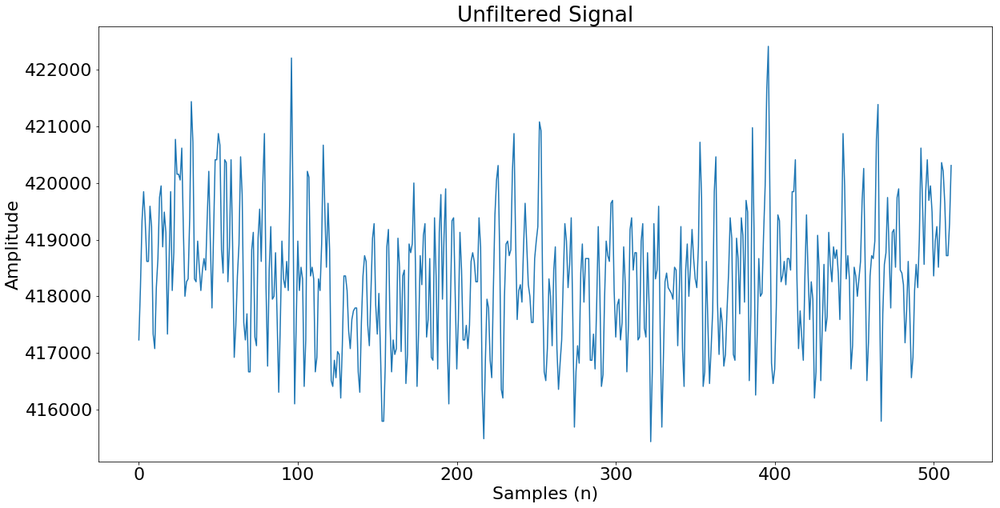

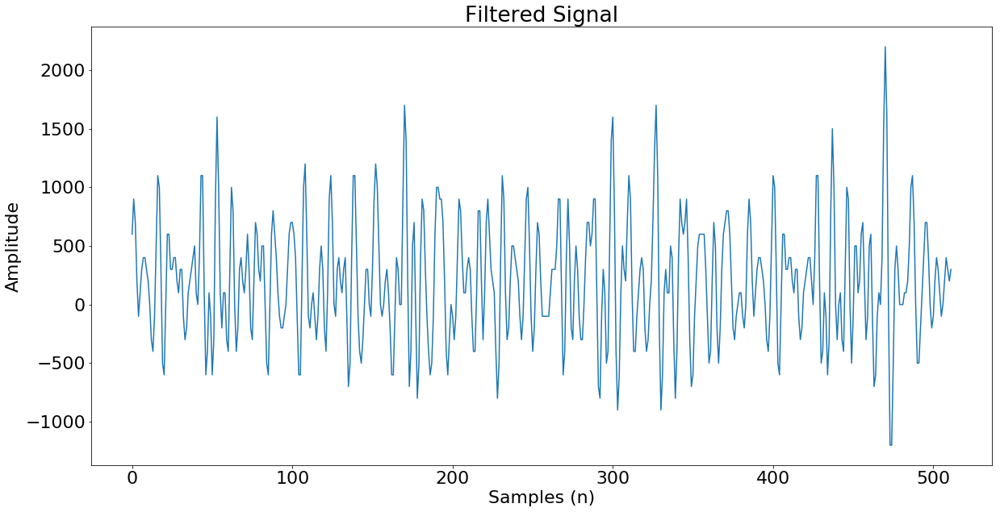

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 576.  225.   17.   25.  365.]
1st Harmonic Frequency Peaks
[ 1300.   549.   409.   949.   325.]


AVG PEAK 5 345.0
AVG PEAK 4 487.0
AVG PEAK 3 213.0
AVG PEAK 2 387.0
AVG PEAK 1 938.0
Detected Class: [1]


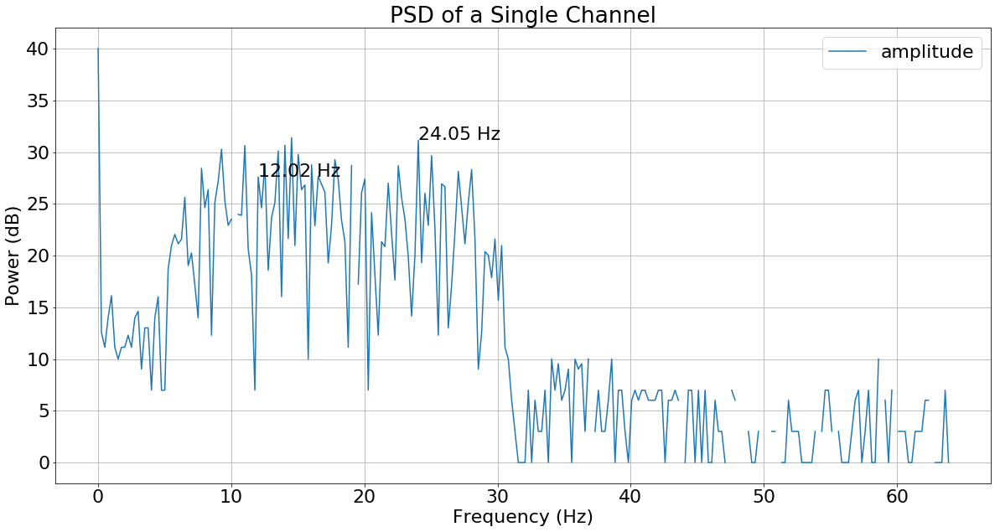

Iteration 3
POINTER 384 896
HW FIR excl Transfer latencies: 0.0010340213775634766
HW FIR: 0.07987308502197266
HW FFT excl Transfer latencies: 0.000840888999988465
HW FFT: 0.08587145805358887


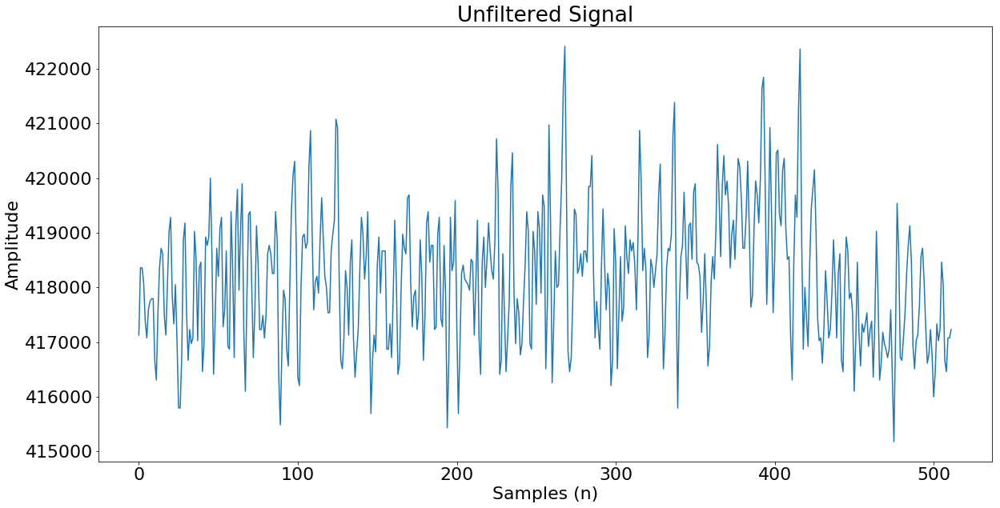

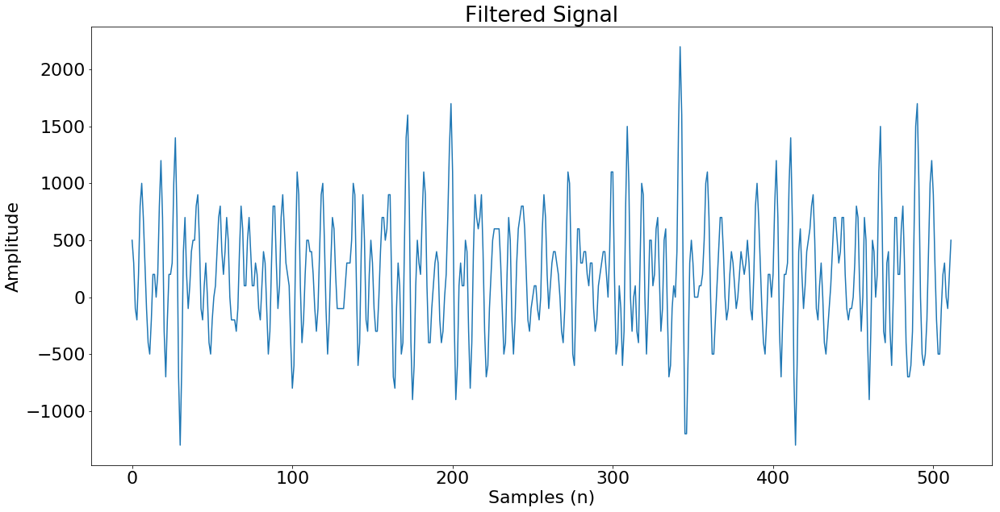

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 401.  610.    9.  196.   45.]
1st Harmonic Frequency Peaks
[ 810.   29.  101.  937.  580.]


AVG PEAK 5 312.5
AVG PEAK 4 566.5
AVG PEAK 3 55.0
AVG PEAK 2 319.5
AVG PEAK 1 605.5


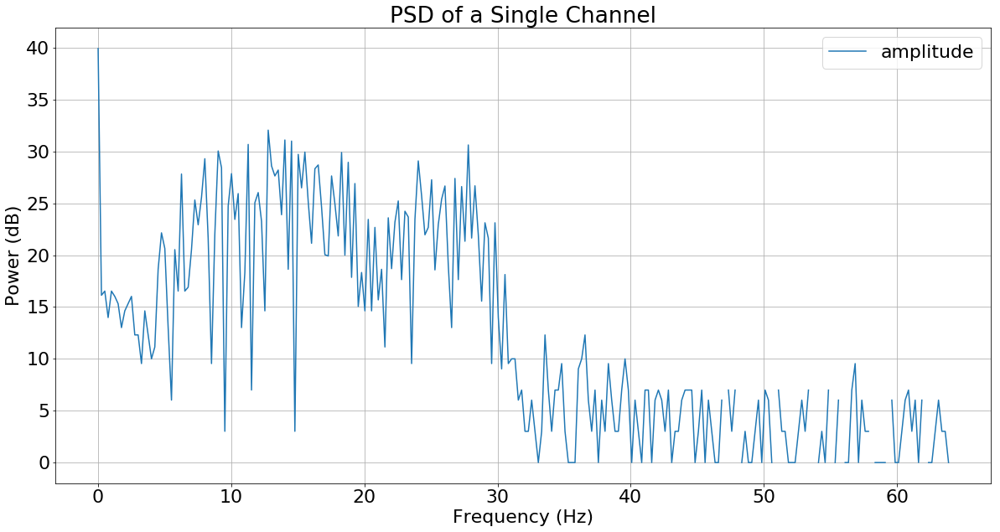

Iteration 4
POINTER 512 1024
HW FIR excl Transfer latencies: 0.0009937286376953125
HW FIR: 0.08753085136413574
HW FFT excl Transfer latencies: 0.0008396610000005467
HW FFT: 0.08267569541931152


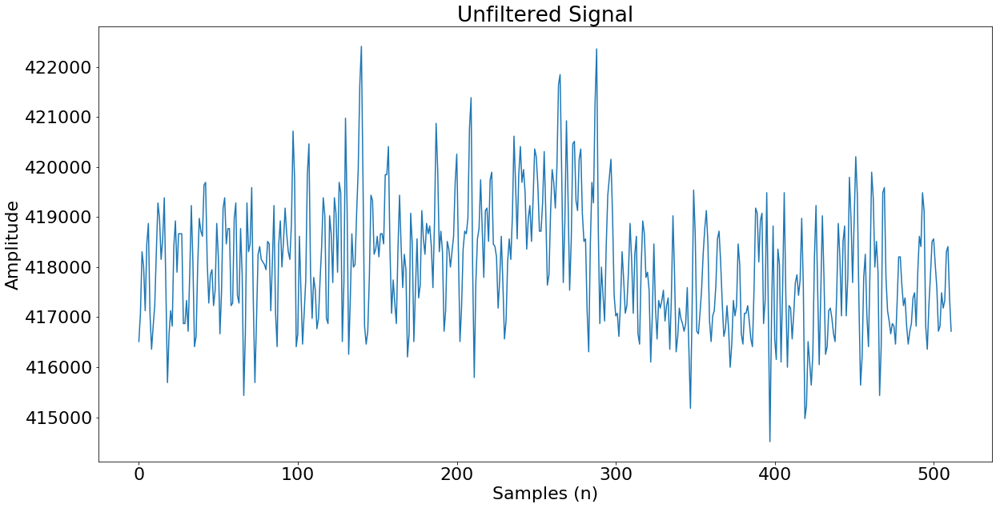

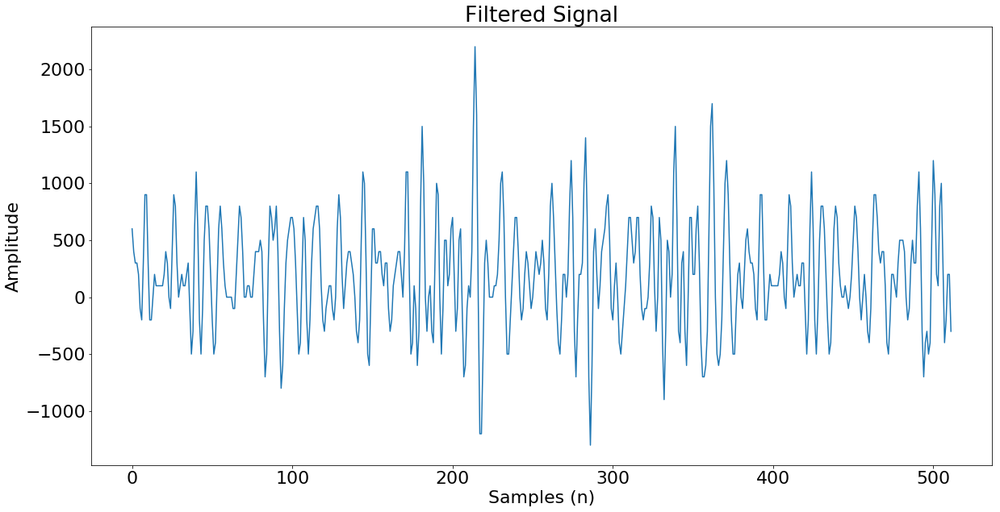

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  53.  592.   64.  221.  169.]
1st Harmonic Frequency Peaks
[  18.  653.  965.  106.  170.]


AVG PEAK 5 169.5
AVG PEAK 4 163.5
AVG PEAK 3 514.5
AVG PEAK 2 622.5
AVG PEAK 1 35.5


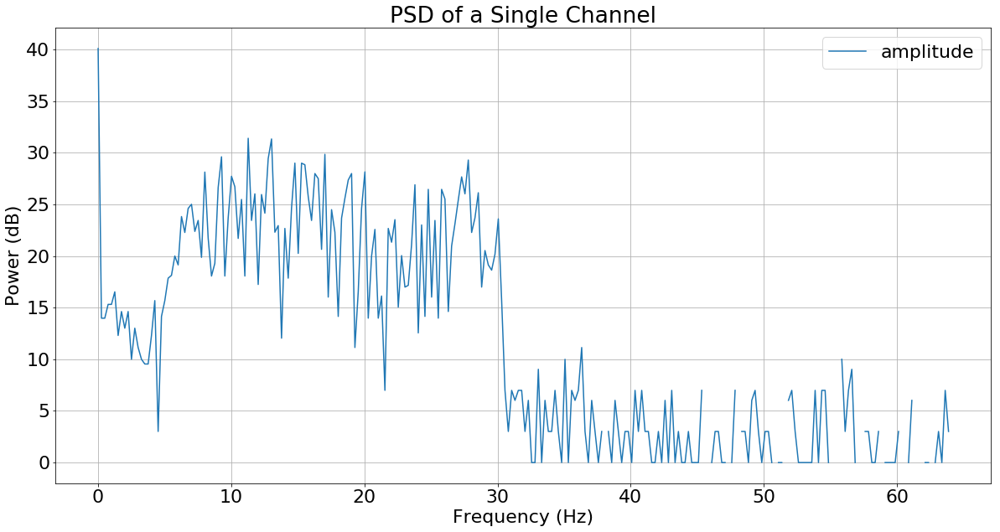

Iteration 5
POINTER 640 1152
HW FIR excl Transfer latencies: 0.0010089874267578125
HW FIR: 0.08018112182617188
HW FFT excl Transfer latencies: 0.0008473299999991468
HW FFT: 0.08390092849731445


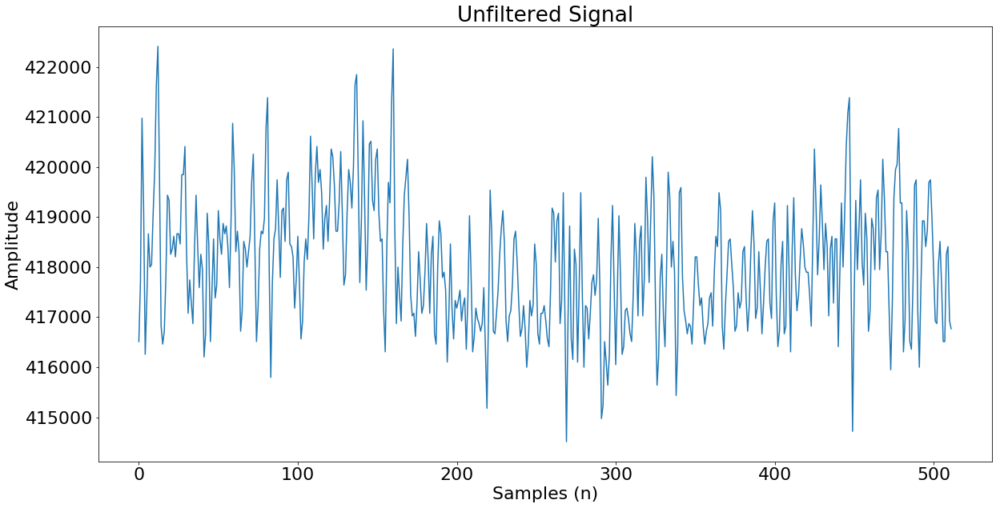

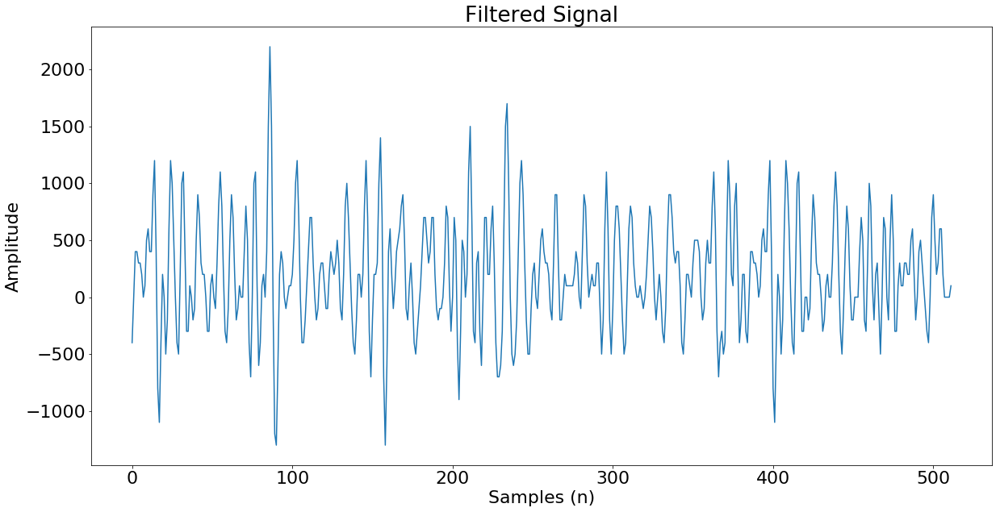

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 361.  577.   25.  221.  205.]
1st Harmonic Frequency Peaks
[  205.   117.  1233.     0.   241.]


AVG PEAK 5 223.0
AVG PEAK 4 110.5
AVG PEAK 3 629.0
AVG PEAK 2 347.0
AVG PEAK 1 283.0


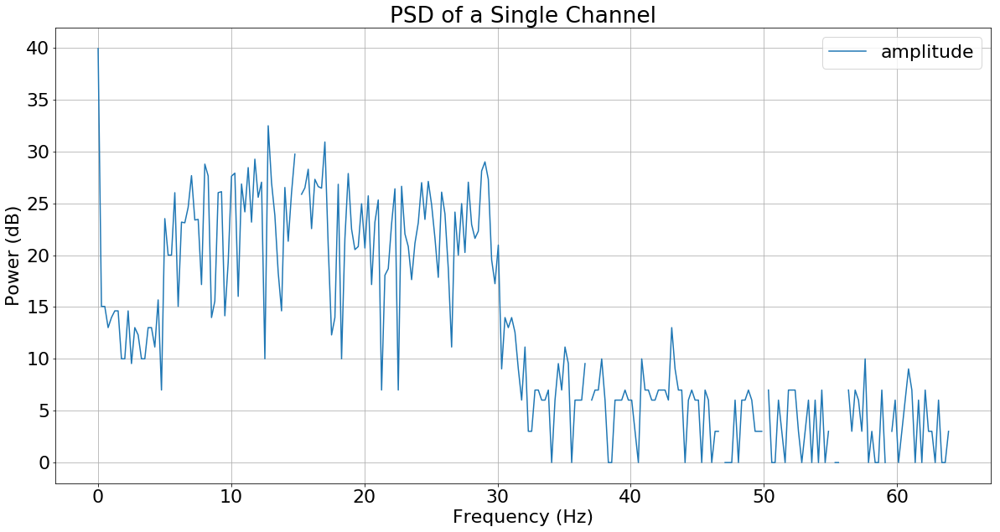

Iteration 6
POINTER 768 1280
HW FIR excl Transfer latencies: 0.0010044574737548828
HW FIR: 0.08064031600952148
HW FFT excl Transfer latencies: 0.0008529230000107191
HW FFT: 0.08432817459106445


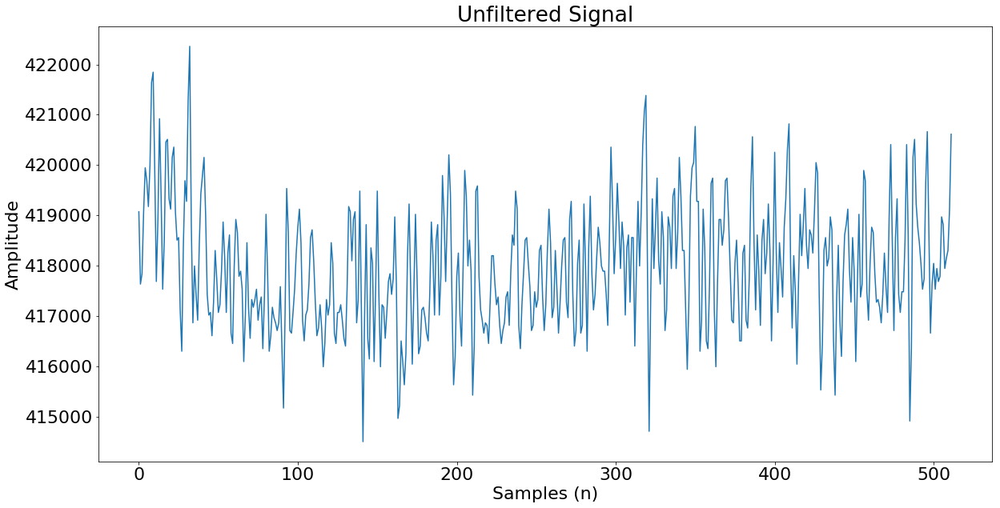

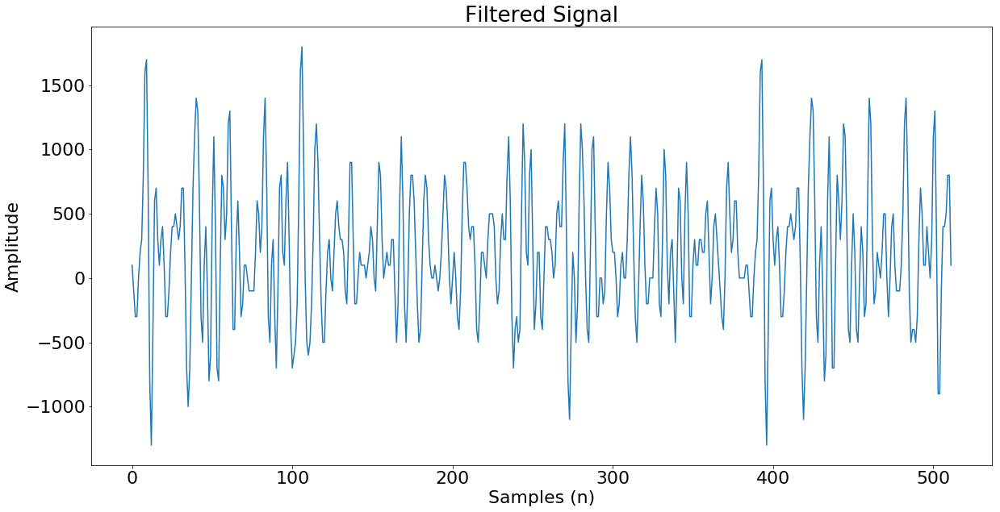

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 941.  509.   65.   61.  125.]
1st Harmonic Frequency Peaks
[  965.   698.  1721.   725.  1076.]


AVG PEAK 5 600.5
AVG PEAK 4 393.0
AVG PEAK 3 893.0
AVG PEAK 2 603.5
AVG PEAK 1 953.0
Detected Class: [1]


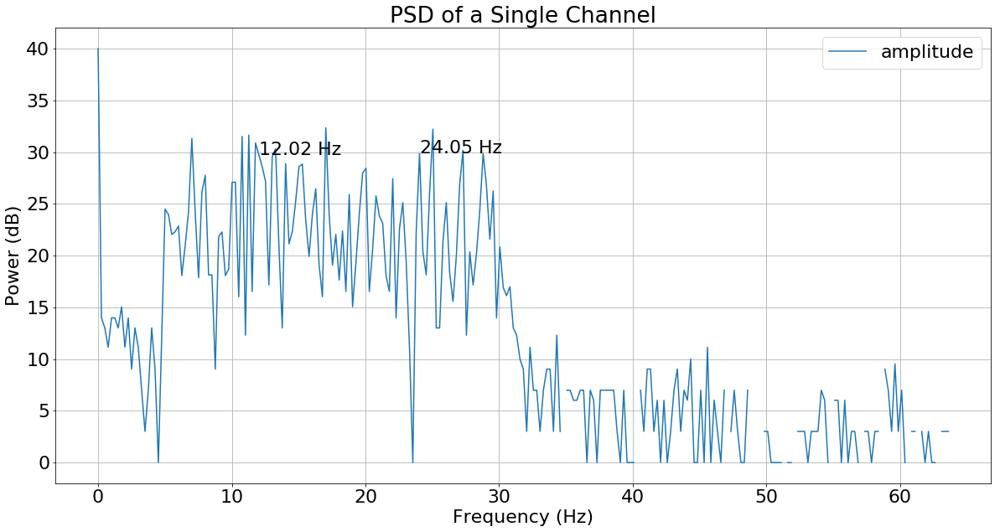

Iteration 7
POINTER 896 1408
HW FIR excl Transfer latencies: 0.0009951591491699219
HW FIR: 0.07979750633239746
HW FFT excl Transfer latencies: 0.00085169899999471
HW FFT: 0.08373022079467773


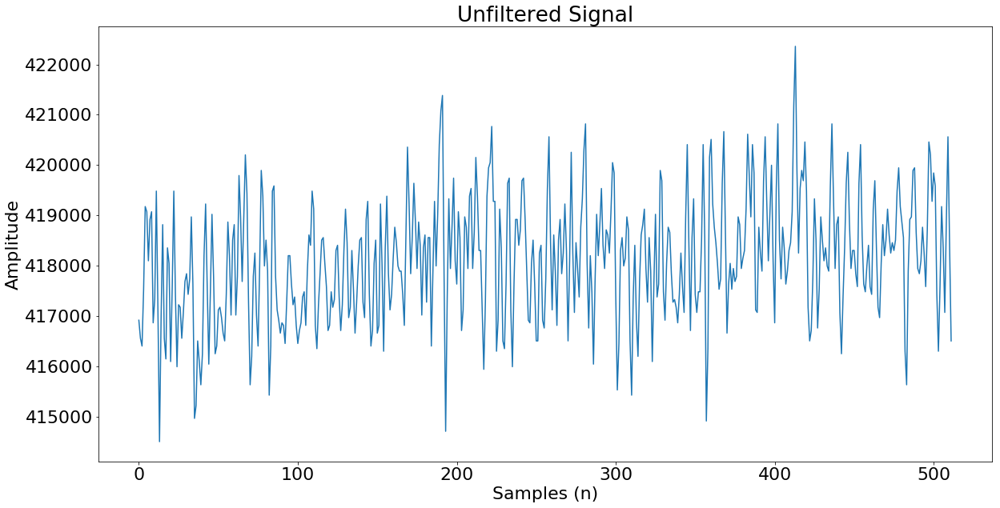

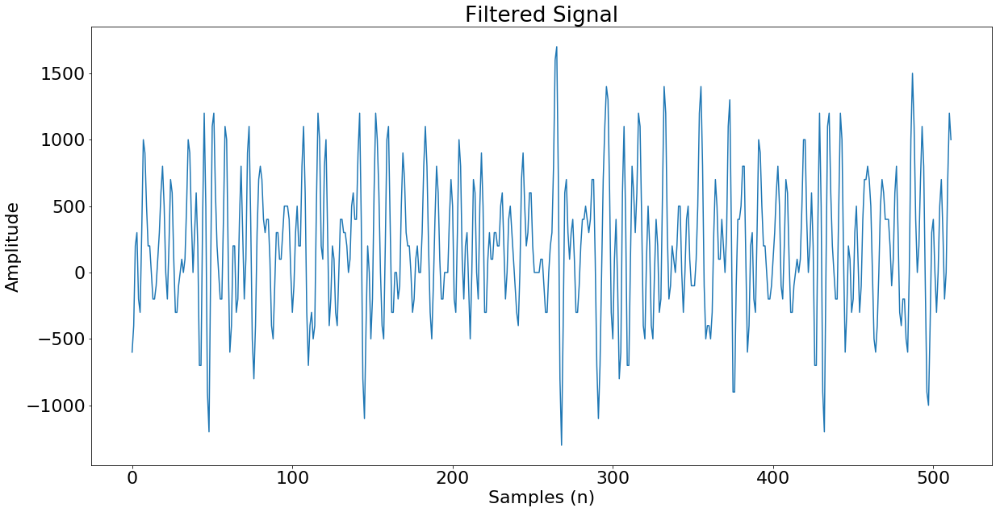

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 337.   53.  305.  338.  178.]
1st Harmonic Frequency Peaks
[ 1733.  1082.   196.   769.  1105.]


AVG PEAK 5 641.5
AVG PEAK 4 553.5
AVG PEAK 3 250.5
AVG PEAK 2 567.5
AVG PEAK 1 1035.0
Detected Class: [1]


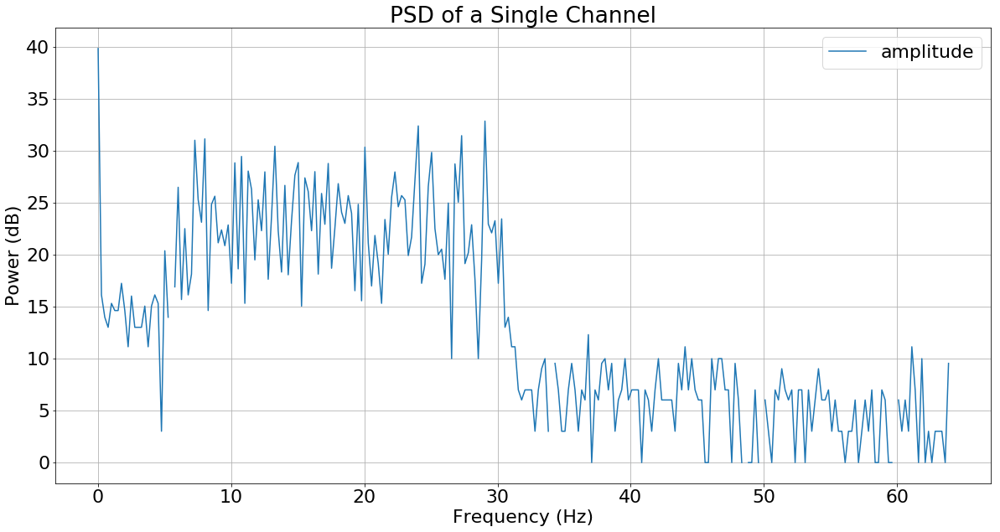

Iteration 8
POINTER 1024 1536
HW FIR excl Transfer latencies: 0.0009951591491699219
HW FIR: 0.0870511531829834
HW FFT excl Transfer latencies: 0.0008423789999909559
HW FFT: 0.08233833312988281


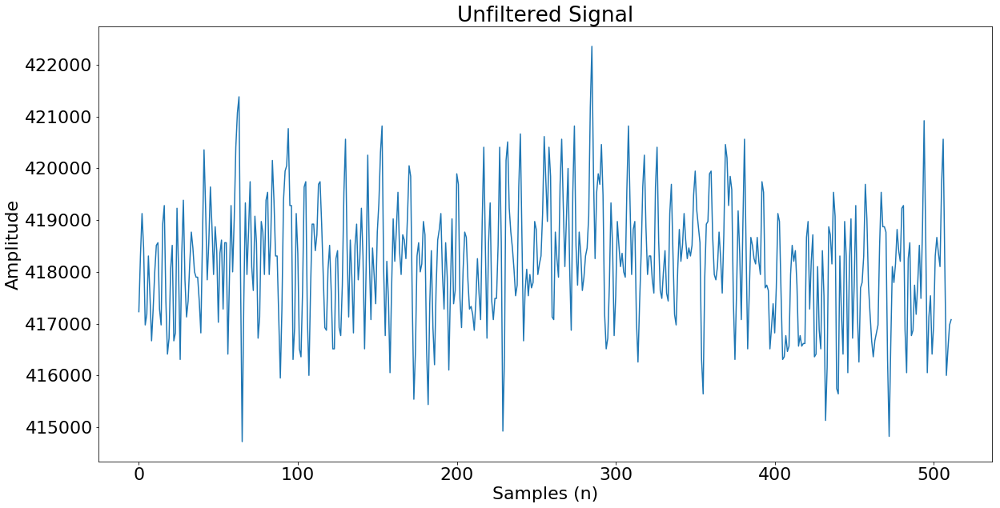

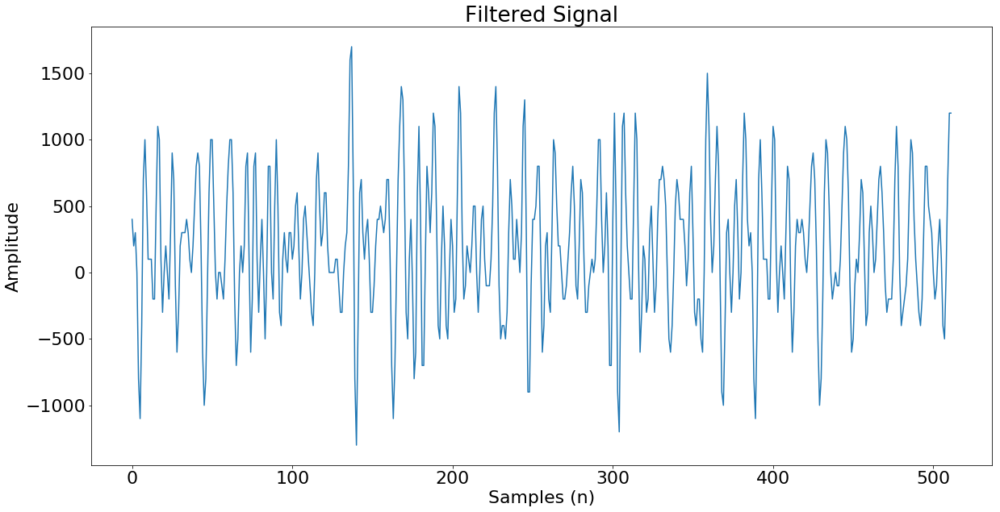

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 2180.   522.   125.   929.   197.]
1st Harmonic Frequency Peaks
[ 1114.   317.   729.  3457.  1305.]


AVG PEAK 5 751.0
AVG PEAK 4 2193.0
AVG PEAK 3 427.0
AVG PEAK 2 419.5
AVG PEAK 1 1647.0
Detected Class: [4]


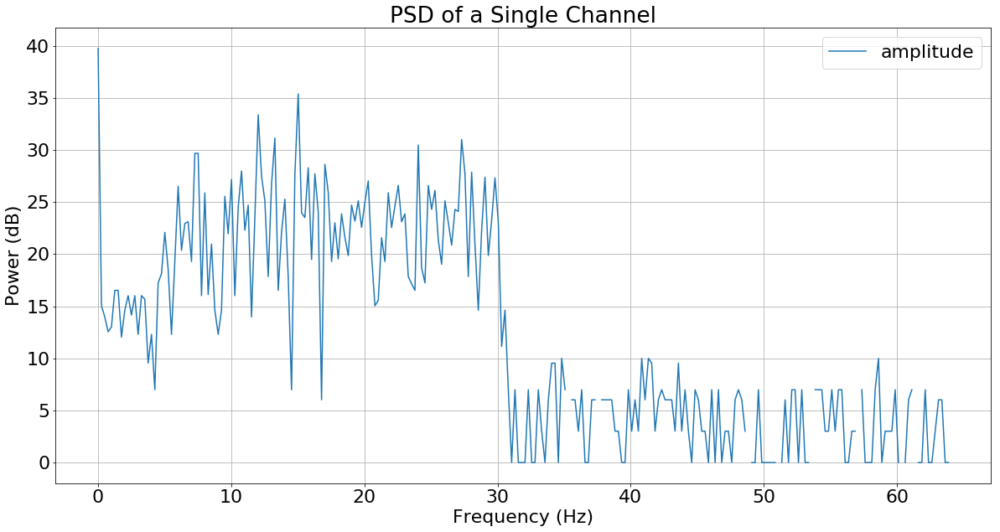

Iteration 9
POINTER 1152 1664
HW FIR excl Transfer latencies: 0.0009922981262207031
HW FIR: 0.08208274841308594
HW FFT excl Transfer latencies: 0.0008505200000001878
HW FFT: 0.08118581771850586


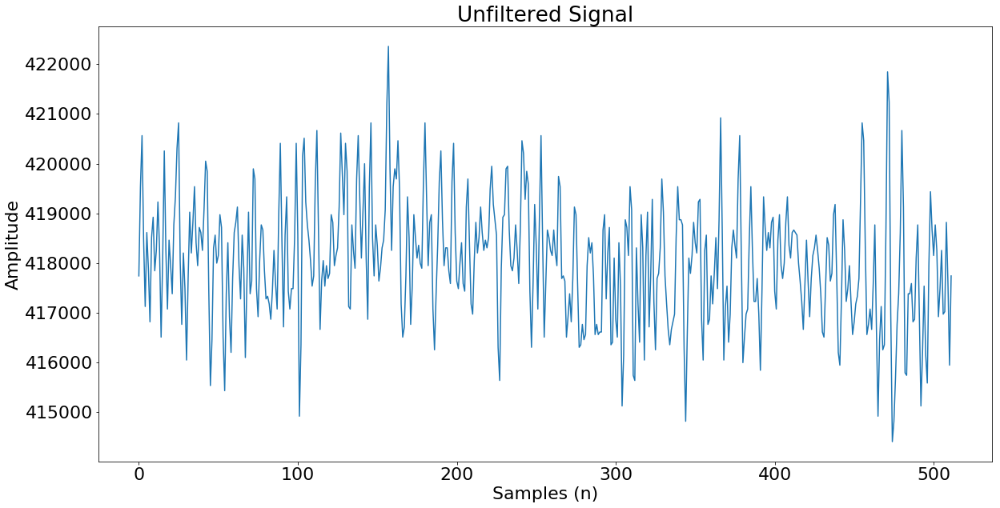

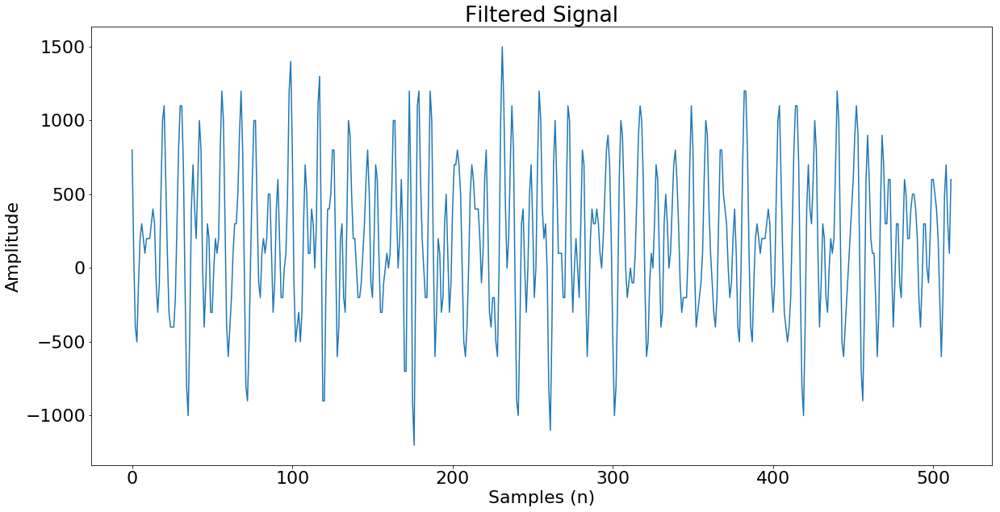

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 1037.     5.   193.   818.    98.]
1st Harmonic Frequency Peaks
[  481.   233.    40.  1413.   932.]


AVG PEAK 5 515.0
AVG PEAK 4 1115.5
AVG PEAK 3 116.5
AVG PEAK 2 119.0
AVG PEAK 1 759.0
Detected Class: [4]


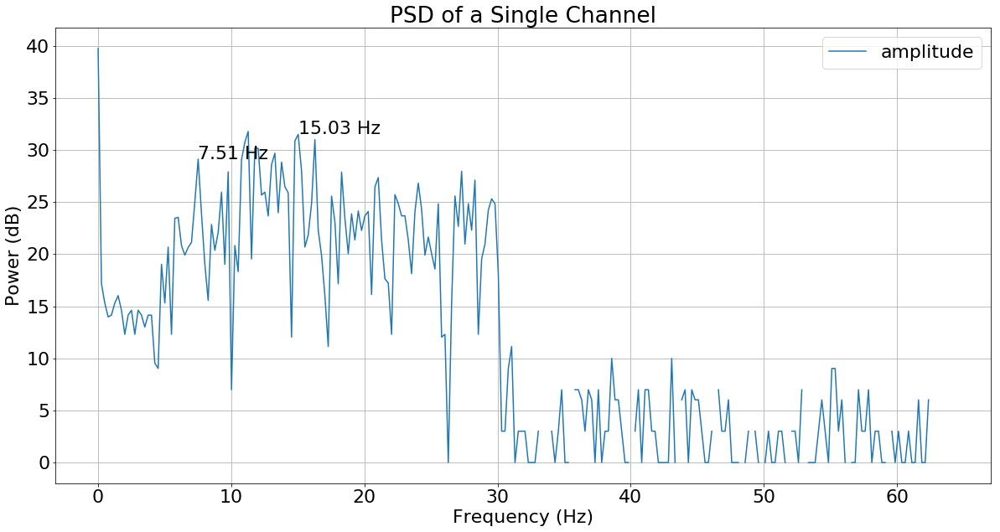

Iteration 10
POINTER 1280 1792
HW FIR excl Transfer latencies: 0.0009992122650146484
HW FIR: 0.07987451553344727
HW FFT excl Transfer latencies: 0.0008522949999871798
HW FFT: 0.08511185646057129


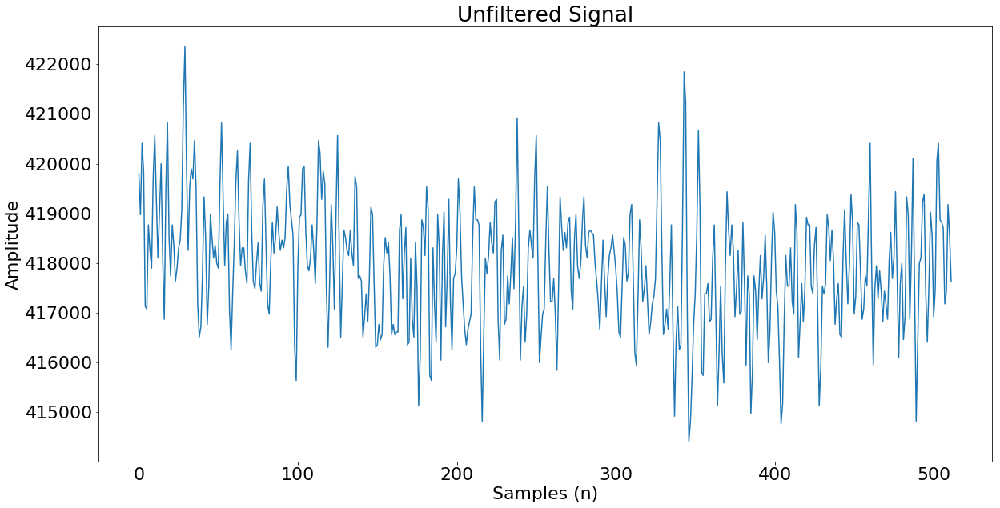

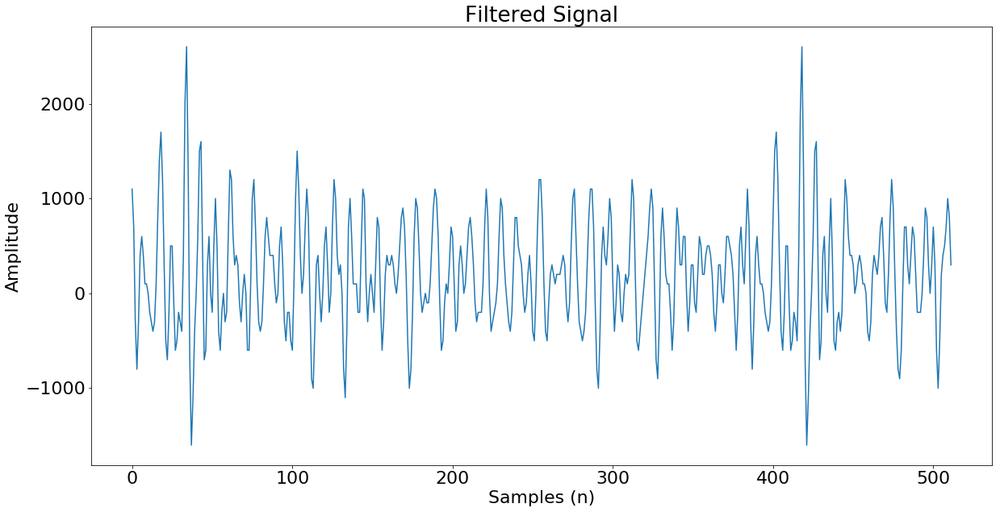

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 1769.    81.   136.    97.    61.]
1st Harmonic Frequency Peaks
[  194.    37.   545.  4090.   829.]


AVG PEAK 5 445.0
AVG PEAK 4 2093.5
AVG PEAK 3 340.5
AVG PEAK 2 59.0
AVG PEAK 1 981.5
Detected Class: [4]


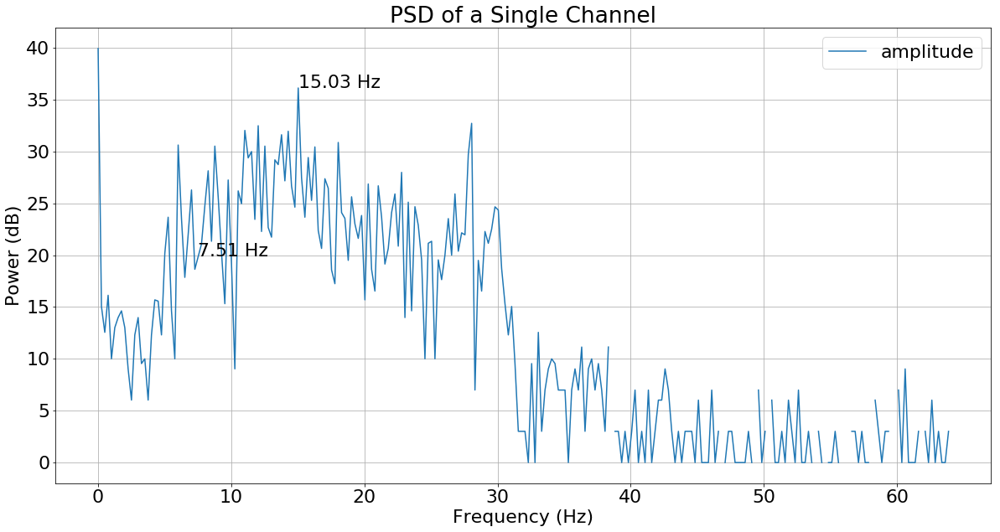

Iteration 11
POINTER 1408 1920
HW FIR excl Transfer latencies: 0.0009832382202148438
HW FIR: 0.08010625839233398
HW FFT excl Transfer latencies: 0.0008440179999809061
HW FFT: 0.08270764350891113


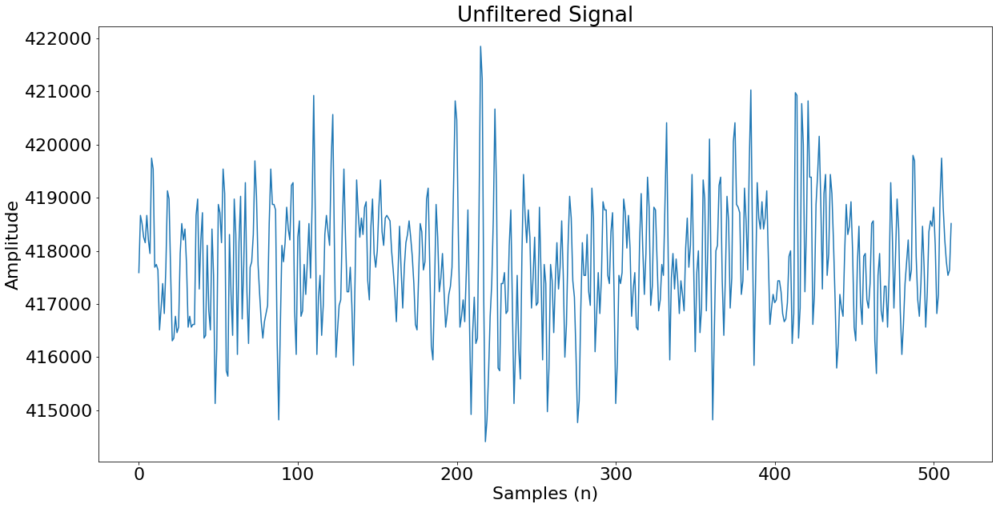

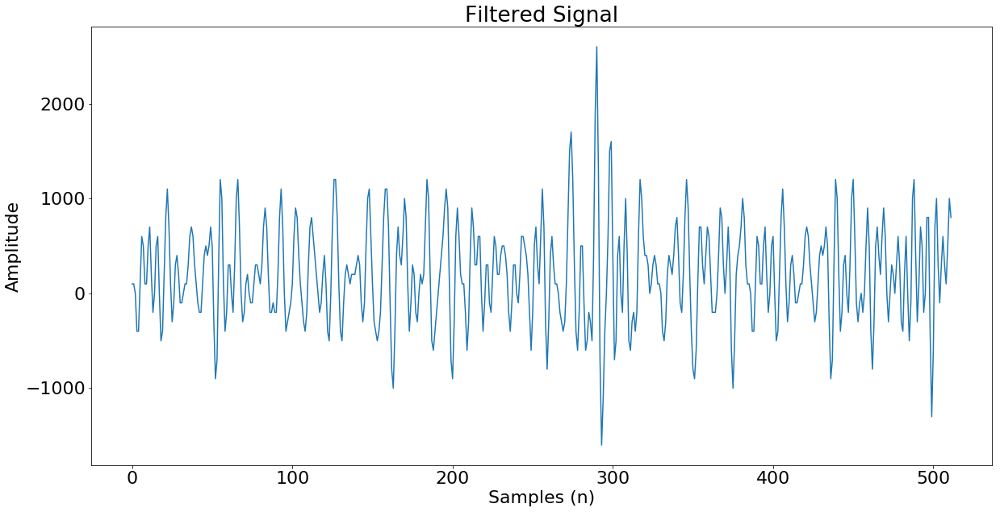

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 241.  122.  386.   80.    9.]
1st Harmonic Frequency Peaks
[ 104.  265.   85.  745.   13.]


AVG PEAK 5 11.0
AVG PEAK 4 412.5
AVG PEAK 3 235.5
AVG PEAK 2 193.5
AVG PEAK 1 172.5


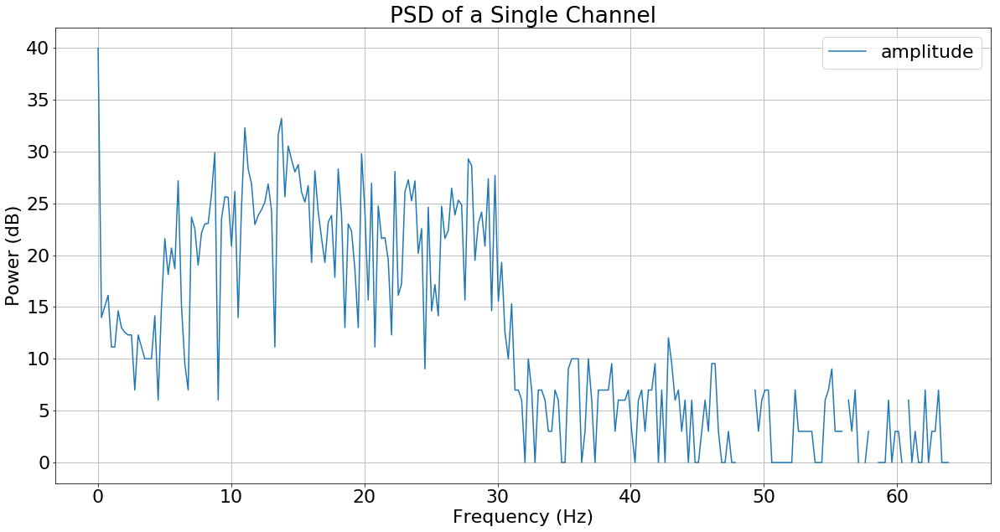

Iteration 12
POINTER 1536 2048
HW FIR excl Transfer latencies: 0.0009808540344238281
HW FIR: 0.08260679244995117
HW FFT excl Transfer latencies: 0.0008483879999801047
HW FFT: 0.08384585380554199


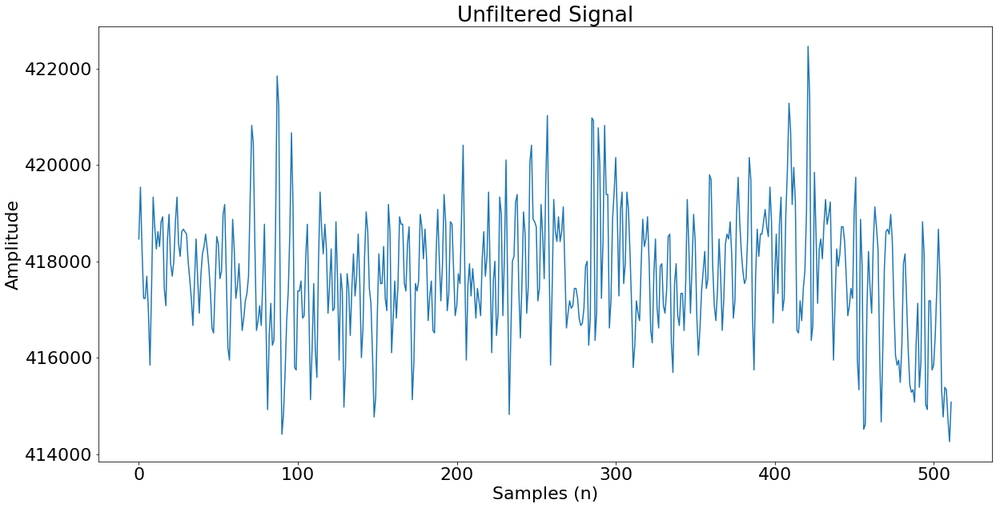

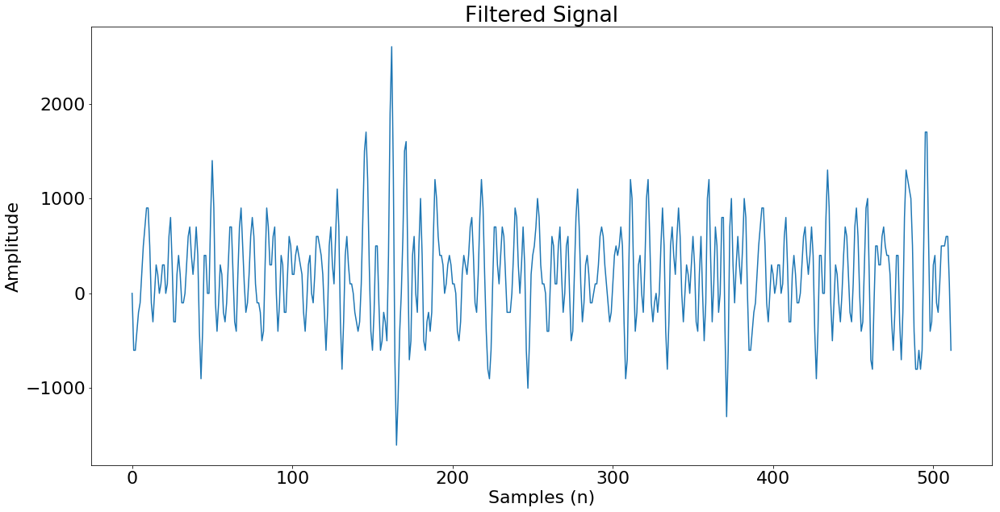

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  596.  2501.    65.   313.   145.]
1st Harmonic Frequency Peaks
[  145.   965.     4.  1066.     9.]


AVG PEAK 5 77.0
AVG PEAK 4 689.5
AVG PEAK 3 34.5
AVG PEAK 2 1733.0
AVG PEAK 1 370.5
Detected Class: [2]


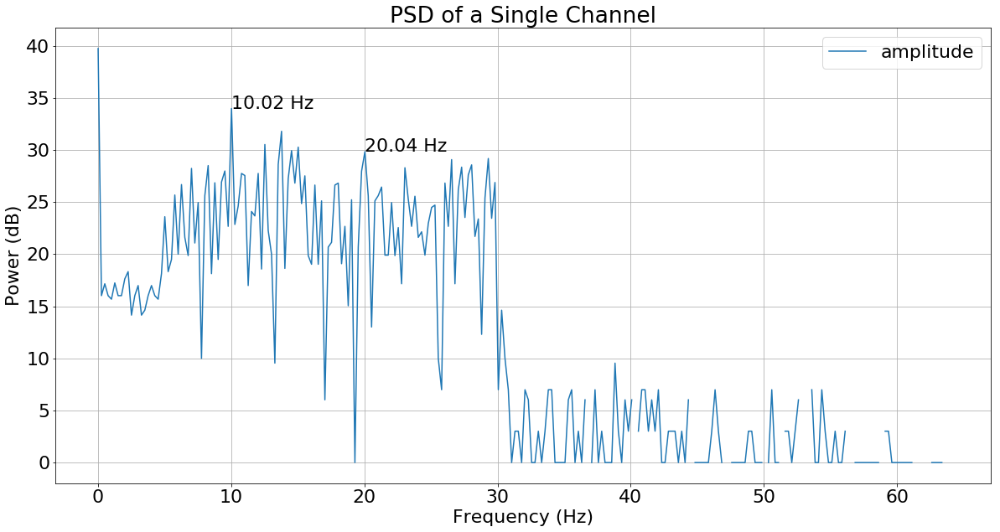

Iteration 13
POINTER 1664 2176
HW FIR excl Transfer latencies: 0.0010223388671875
HW FIR: 0.07842254638671875
HW FFT excl Transfer latencies: 0.0008552949999796056
HW FFT: 0.08535242080688477


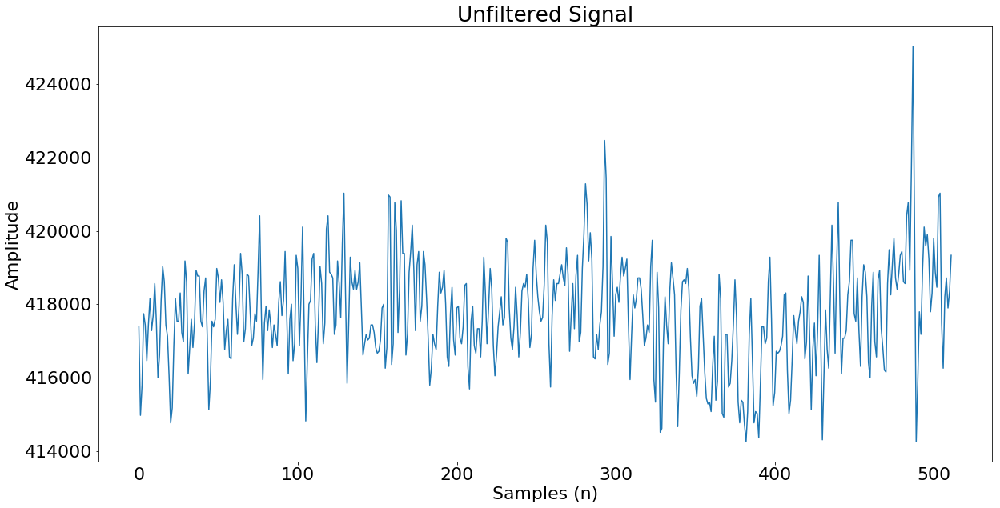

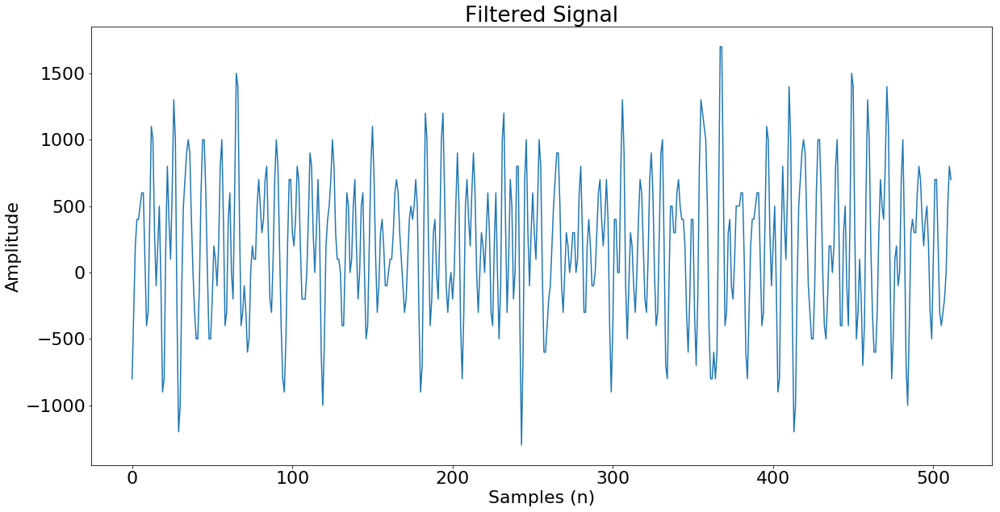

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  997.  1546.   409.   197.    13.]
1st Harmonic Frequency Peaks
[ 676.  290.  533.  442.  260.]


AVG PEAK 5 136.5
AVG PEAK 4 319.5
AVG PEAK 3 471.0
AVG PEAK 2 918.0
AVG PEAK 1 836.5
Detected Class: [2]


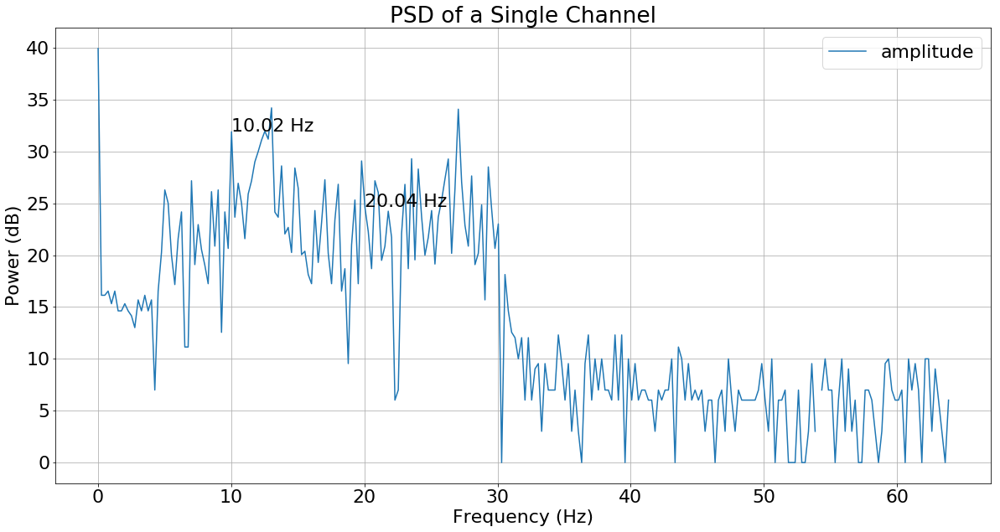

Iteration 14
POINTER 1792 2304
HW FIR excl Transfer latencies: 0.001070261001586914
HW FIR: 0.08457732200622559
HW FFT excl Transfer latencies: 0.0008597940000072413
HW FFT: 0.08656167984008789


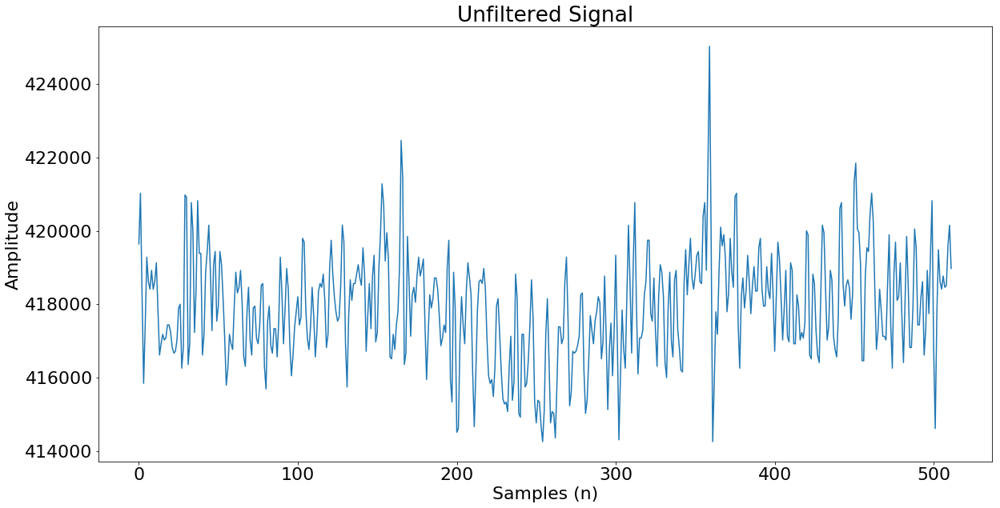

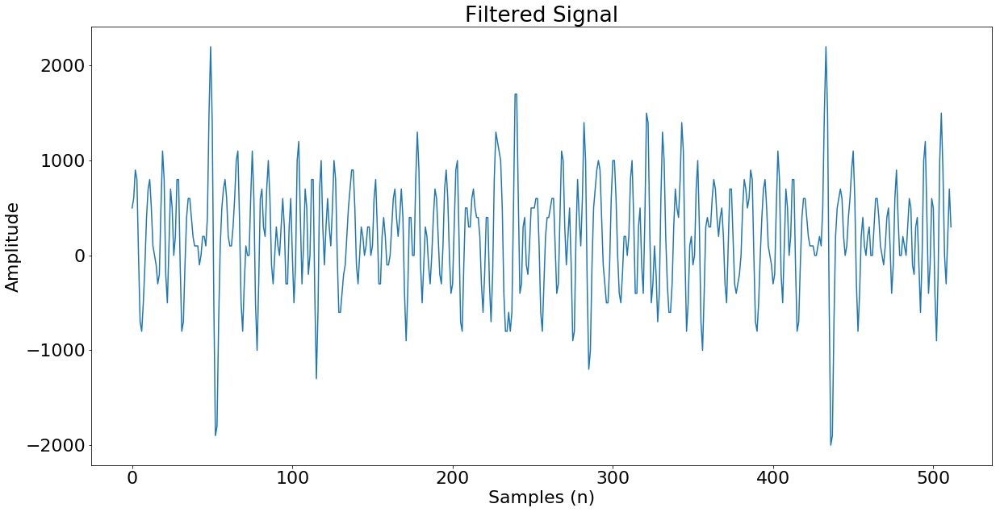

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  424.  2041.   145.   170.   180.]
1st Harmonic Frequency Peaks
[  761.   881.  1325.   290.   232.]


AVG PEAK 5 206.0
AVG PEAK 4 230.0
AVG PEAK 3 735.0
AVG PEAK 2 1461.0
AVG PEAK 1 592.5
Detected Class: [2]


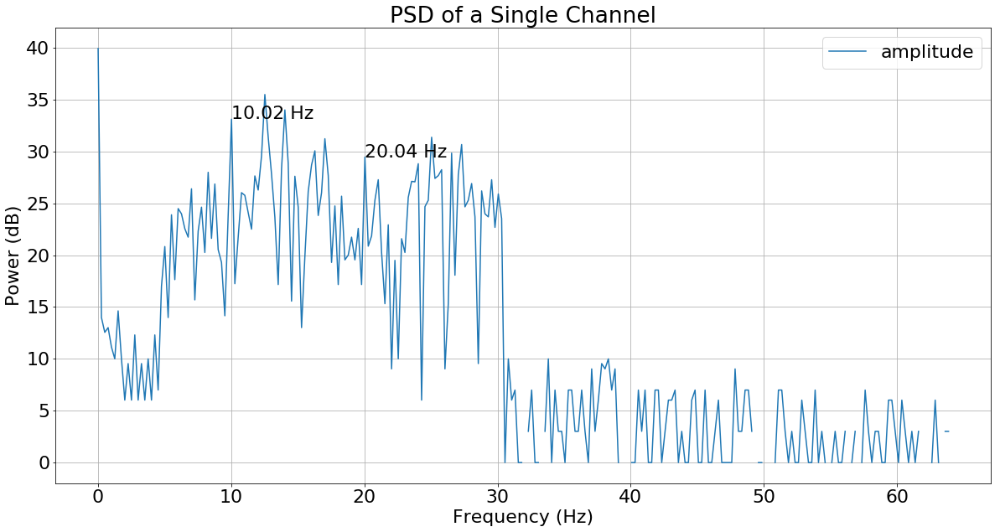

Iteration 15
POINTER 1920 2432
HW FIR excl Transfer latencies: 0.0009944438934326172
HW FIR: 0.0826561450958252
HW FFT excl Transfer latencies: 0.000853697999986025
HW FFT: 0.08160877227783203


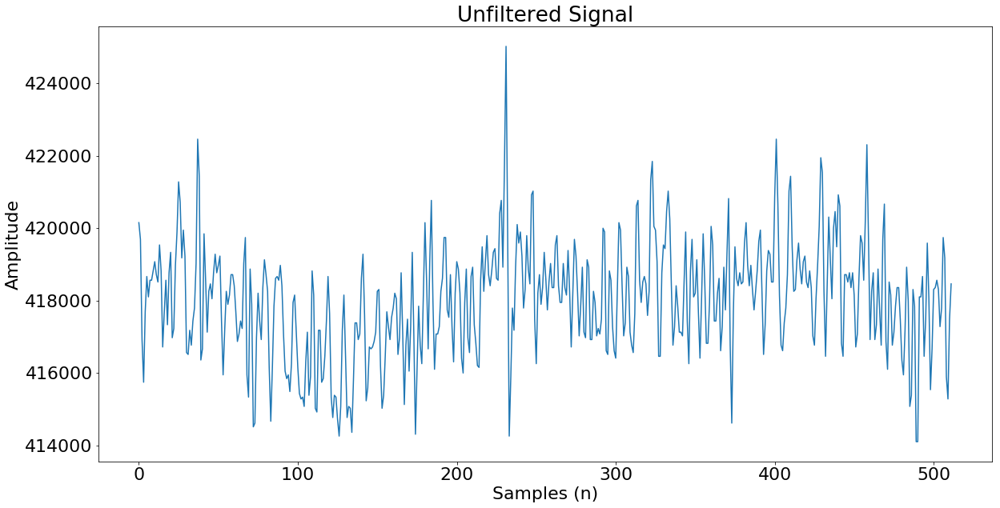

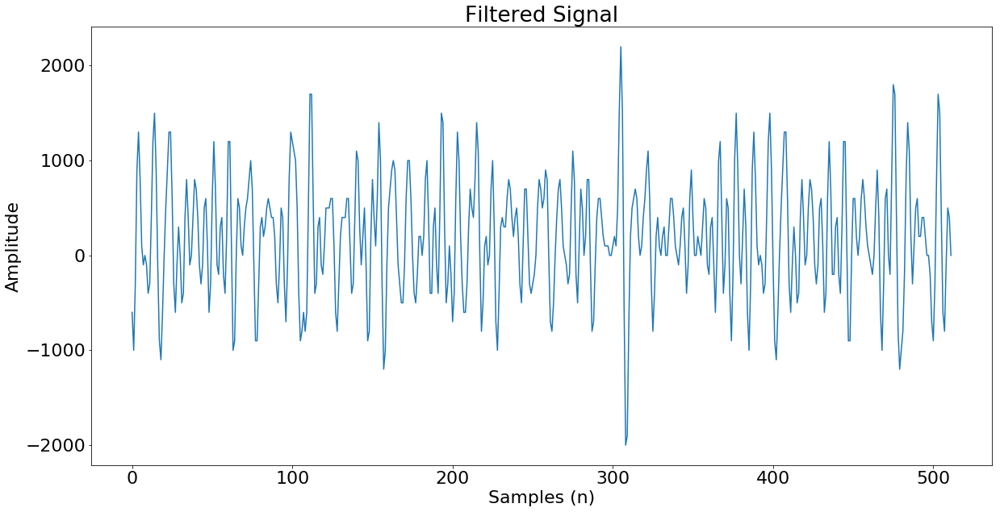

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 2122.  1042.   137.   370.   170.]
1st Harmonic Frequency Peaks
[ 1805.  1157.   925.   701.   738.]


AVG PEAK 5 454.0
AVG PEAK 4 535.5
AVG PEAK 3 531.0
AVG PEAK 2 1099.5
AVG PEAK 1 1963.5
Detected Class: [1]


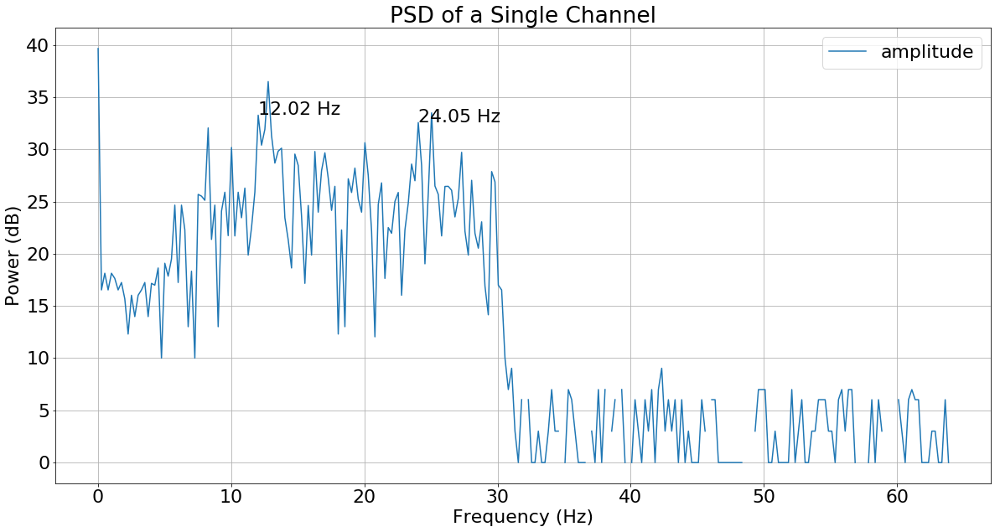

Iteration 16
POINTER 2048 2560
HW FIR excl Transfer latencies: 0.0009970664978027344
HW FIR: 0.08614873886108398
HW FFT excl Transfer latencies: 0.0008537380000177563
HW FFT: 0.0849921703338623


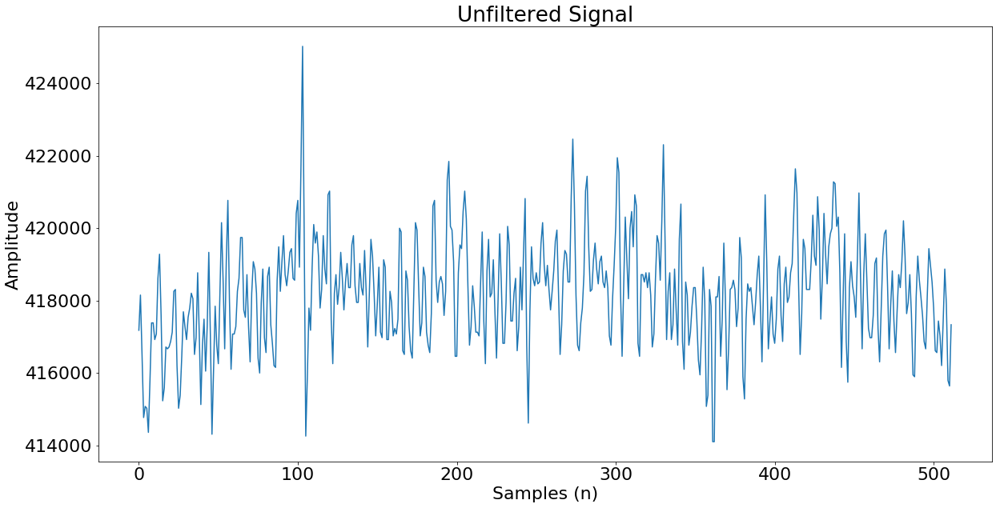

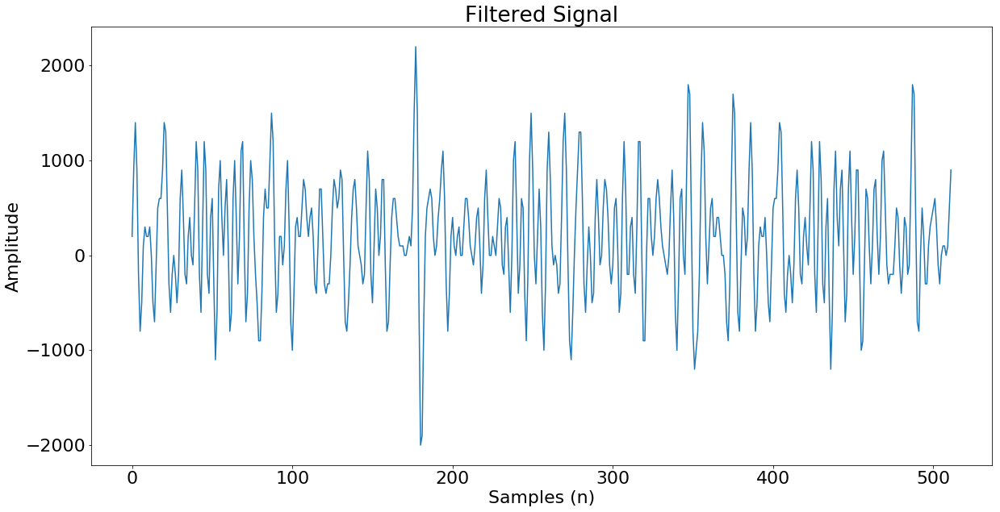

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 148.   29.  221.  729.  548.]
1st Harmonic Frequency Peaks
[  757.   533.   106.   173.  2285.]


AVG PEAK 5 1416.5
AVG PEAK 4 451.0
AVG PEAK 3 163.5
AVG PEAK 2 281.0
AVG PEAK 1 452.5
Detected Class: [5]


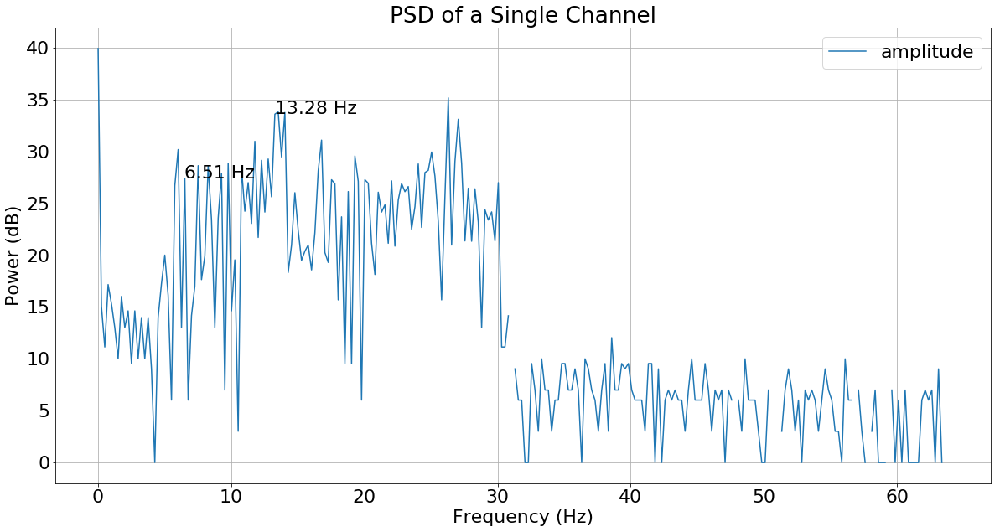

Iteration 17
POINTER 2176 2688
HW FIR excl Transfer latencies: 0.0010004043579101562
HW FIR: 0.08644795417785645
HW FFT excl Transfer latencies: 0.0008407660000102624
HW FFT: 0.08227205276489258


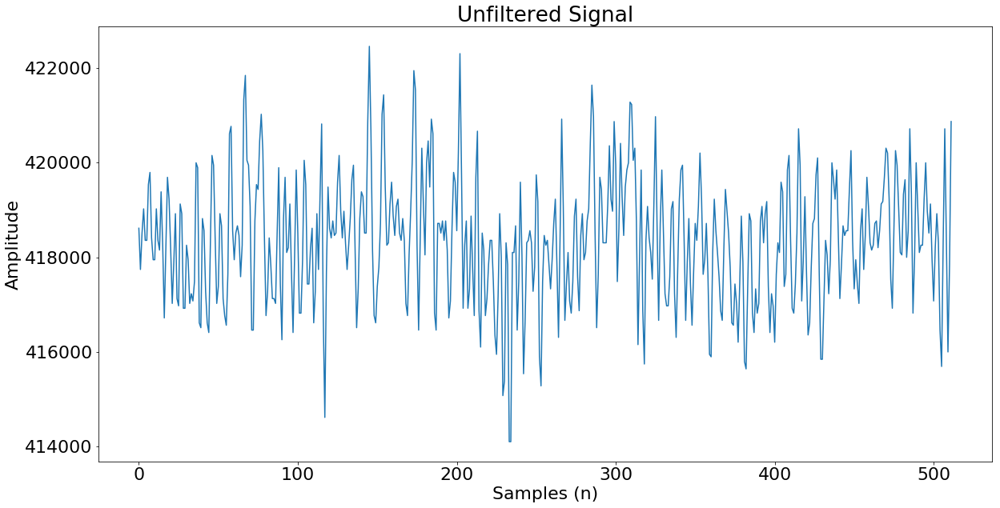

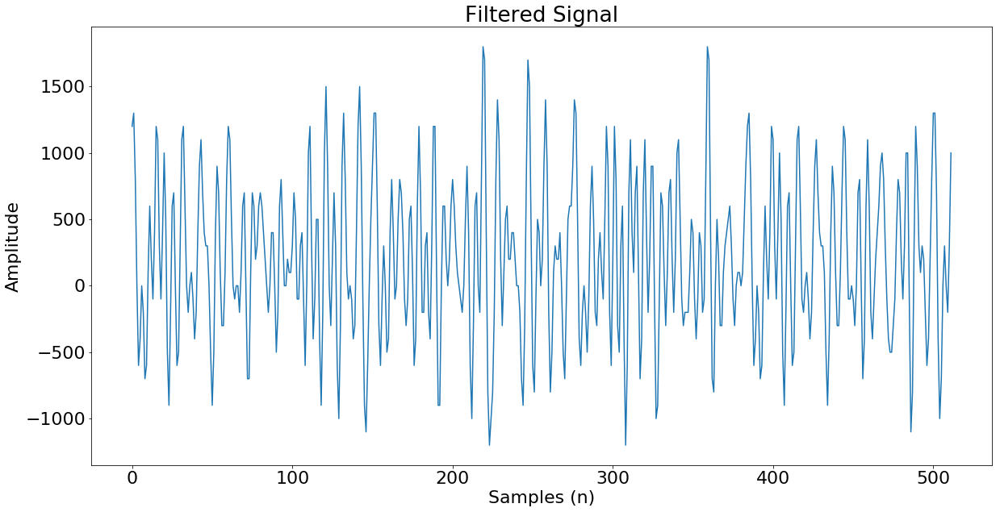

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 245.  265.  197.   49.  146.]
1st Harmonic Frequency Peaks
[  169.   317.   617.   296.  1825.]


AVG PEAK 5 985.5
AVG PEAK 4 172.5
AVG PEAK 3 407.0
AVG PEAK 2 291.0
AVG PEAK 1 207.0
Detected Class: [5]


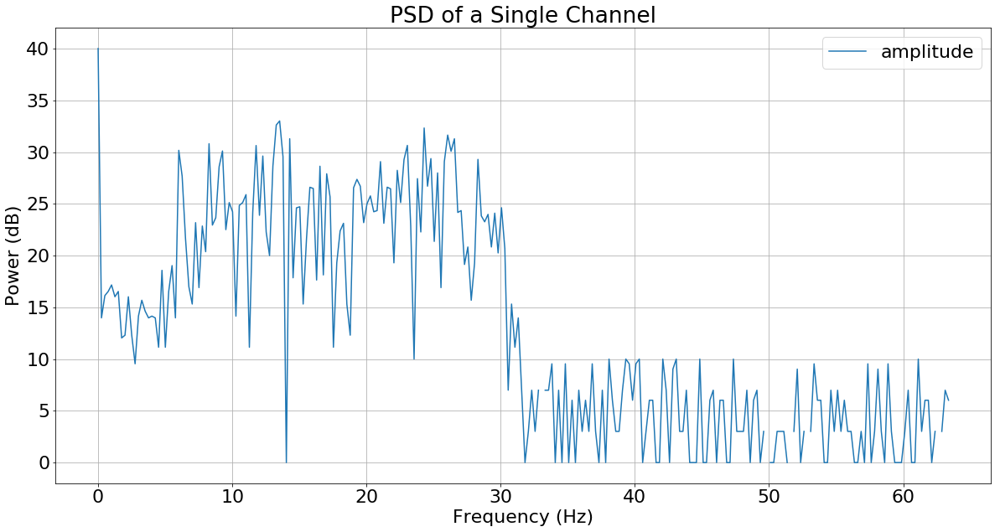

Iteration 18
POINTER 2304 2816
HW FIR excl Transfer latencies: 0.0009713172912597656
HW FIR: 0.08524513244628906
HW FFT excl Transfer latencies: 0.0008381020000172157
HW FFT: 0.08382415771484375


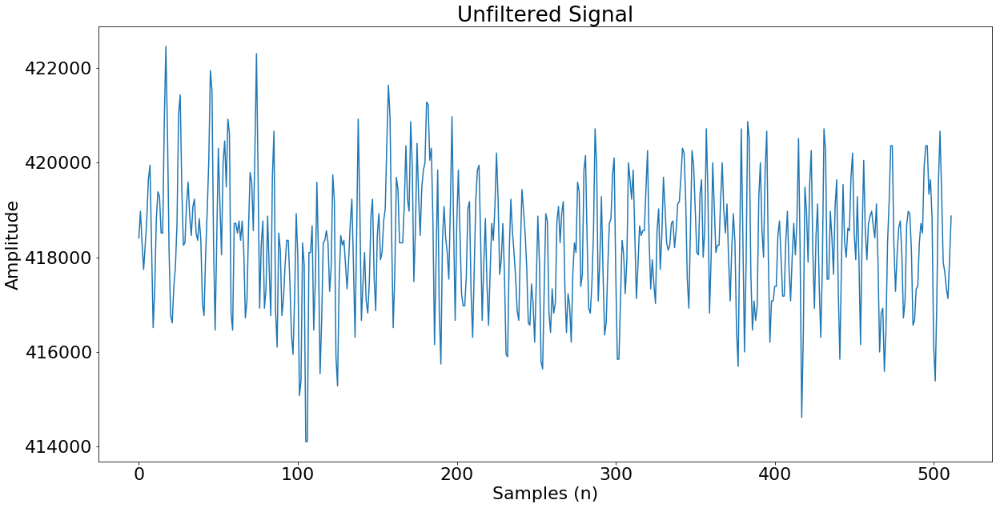

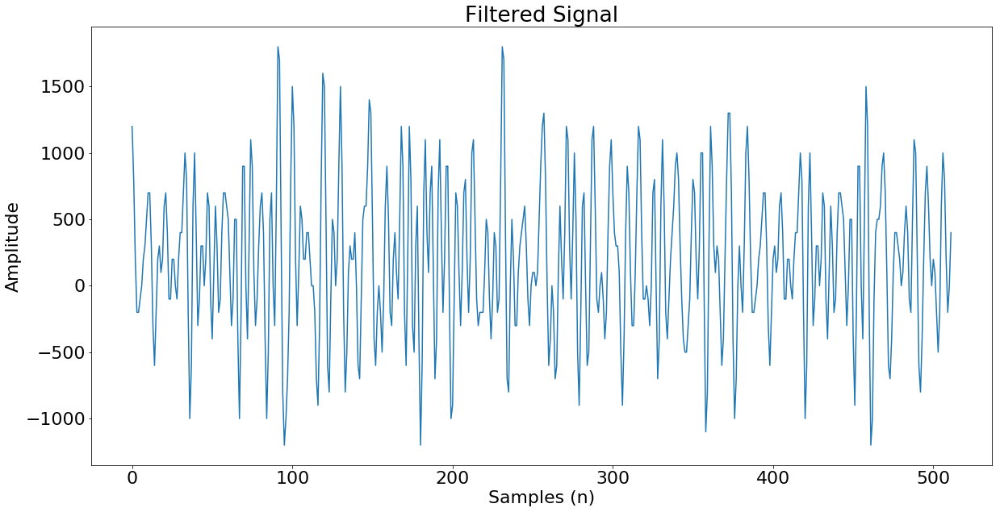

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 1129.   260.   370.    58.   164.]
1st Harmonic Frequency Peaks
[ 1160.   314.   850.   242.   769.]


AVG PEAK 5 466.5
AVG PEAK 4 150.0
AVG PEAK 3 610.0
AVG PEAK 2 287.0
AVG PEAK 1 1144.5
Detected Class: [1]


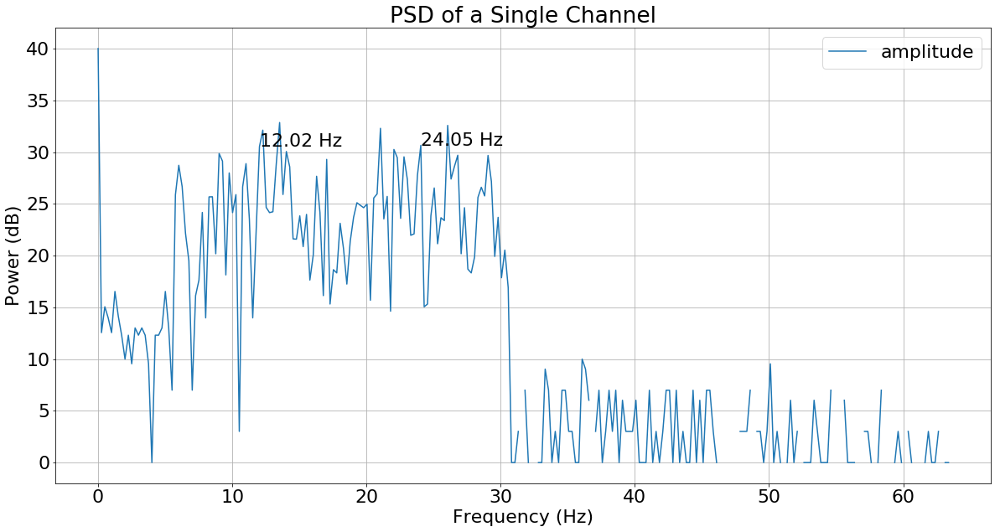

Iteration 19
POINTER 2432 2944
HW FIR excl Transfer latencies: 0.001043558120727539
HW FIR: 0.07930397987365723
HW FFT excl Transfer latencies: 0.0008435130000066238
HW FFT: 0.08188915252685547


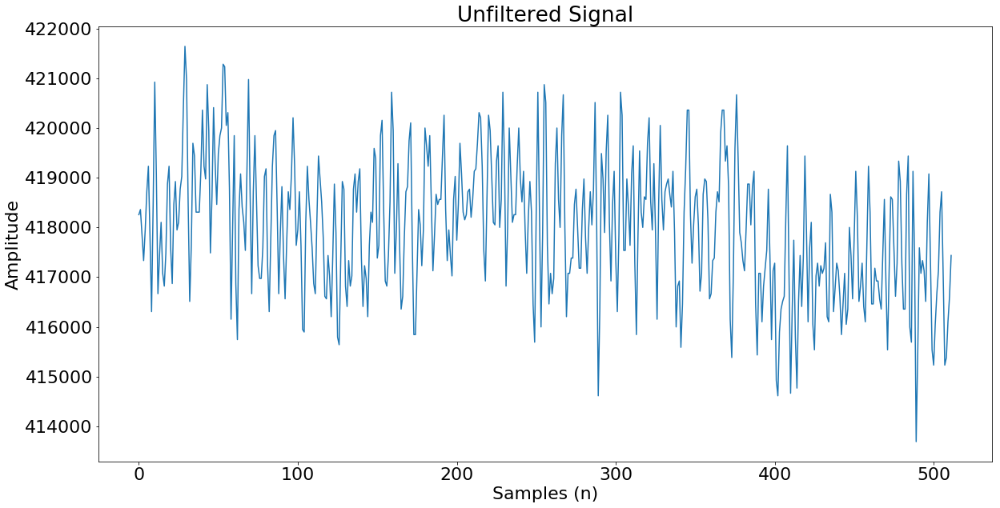

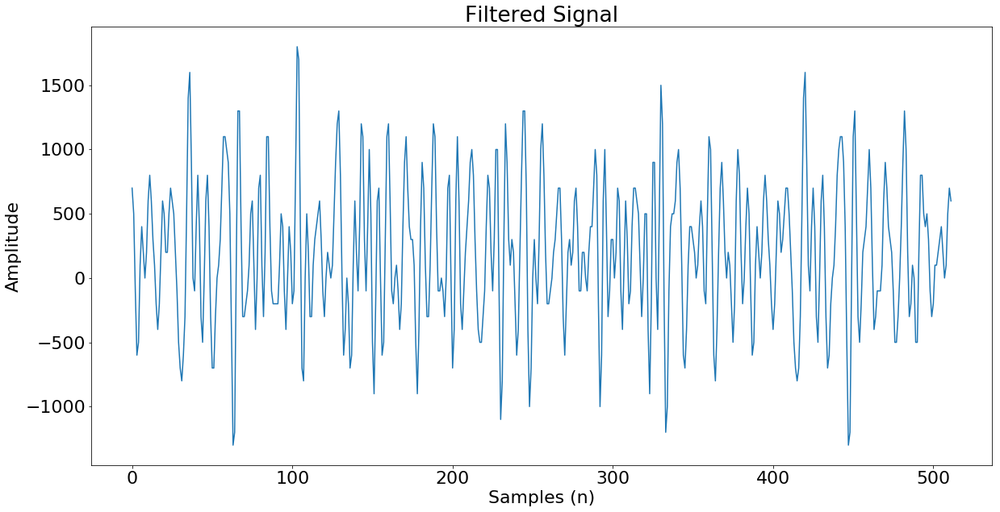

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  314.  1097.   136.    25.   208.]
1st Harmonic Frequency Peaks
[ 400.  793.  101.  522.  197.]


AVG PEAK 5 202.5
AVG PEAK 4 273.5
AVG PEAK 3 118.5
AVG PEAK 2 945.0
AVG PEAK 1 357.0
Detected Class: [2]


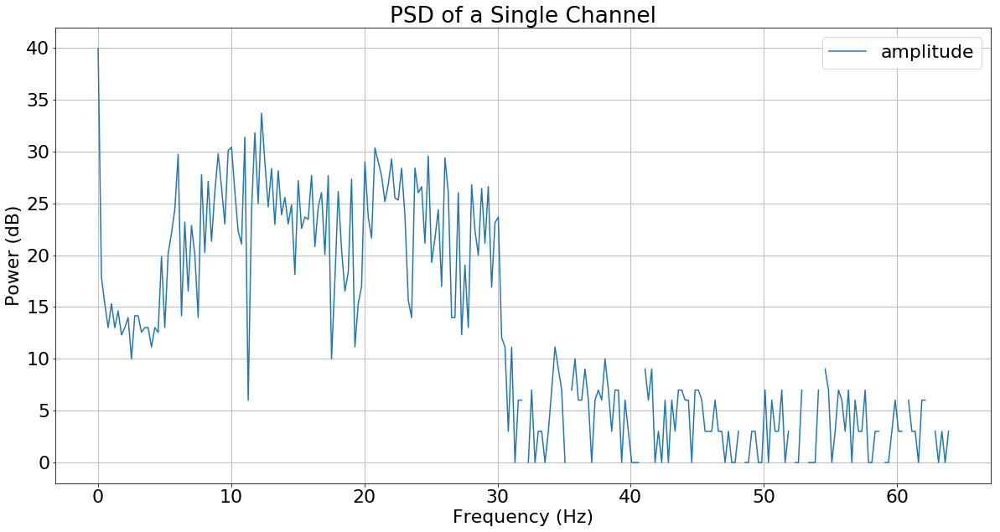

Iteration 20
POINTER 2560 3072
HW FIR excl Transfer latencies: 0.0009832382202148438
HW FIR: 0.0829012393951416
HW FFT excl Transfer latencies: 0.0008556429999941884
HW FFT: 0.08375239372253418


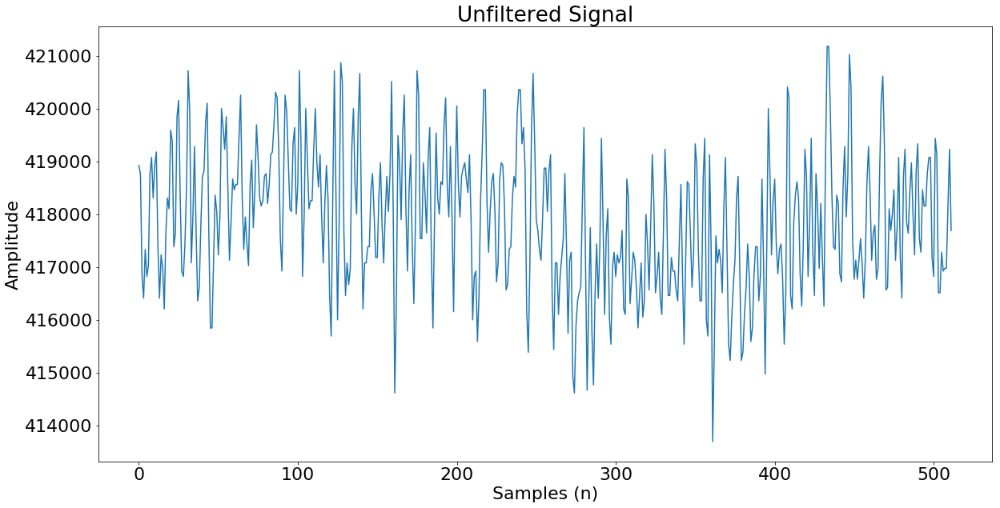

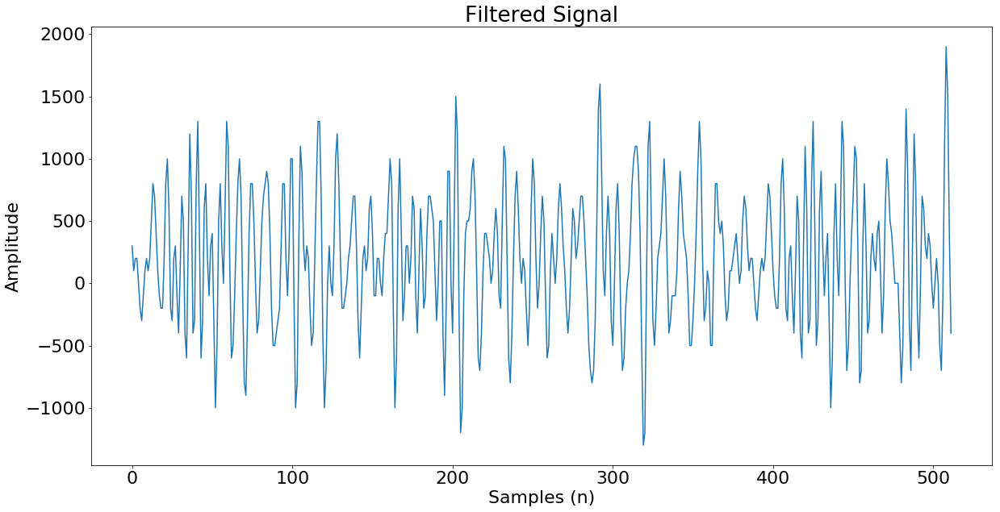

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  289.  1381.   250.   196.   200.]
1st Harmonic Frequency Peaks
[  101.  1930.   225.   706.    89.]


AVG PEAK 5 144.5
AVG PEAK 4 451.0
AVG PEAK 3 237.5
AVG PEAK 2 1655.5
AVG PEAK 1 195.0
Detected Class: [2]


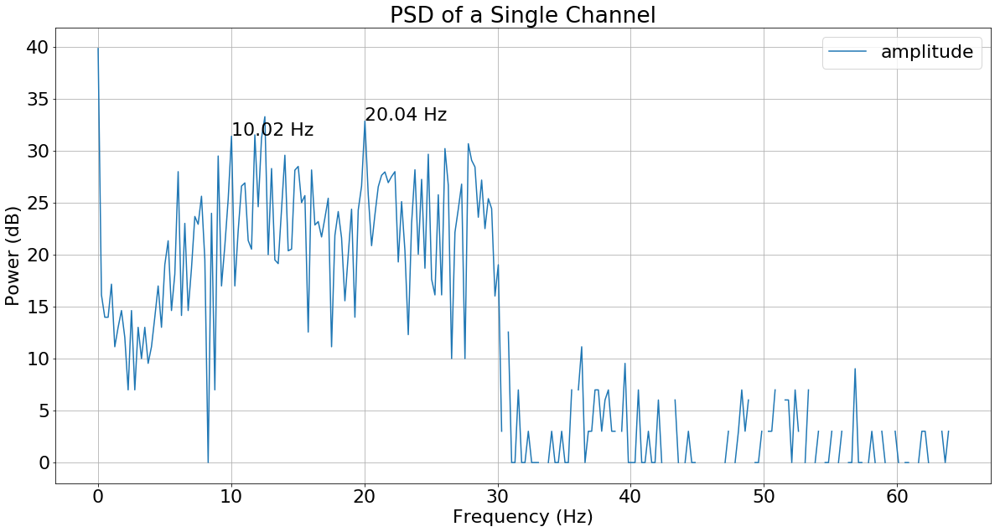

Iteration 21
POINTER 2688 3200
HW FIR excl Transfer latencies: 0.0009999275207519531
HW FIR: 0.08275985717773438
HW FFT excl Transfer latencies: 0.0008544830000118964
HW FFT: 0.08046126365661621


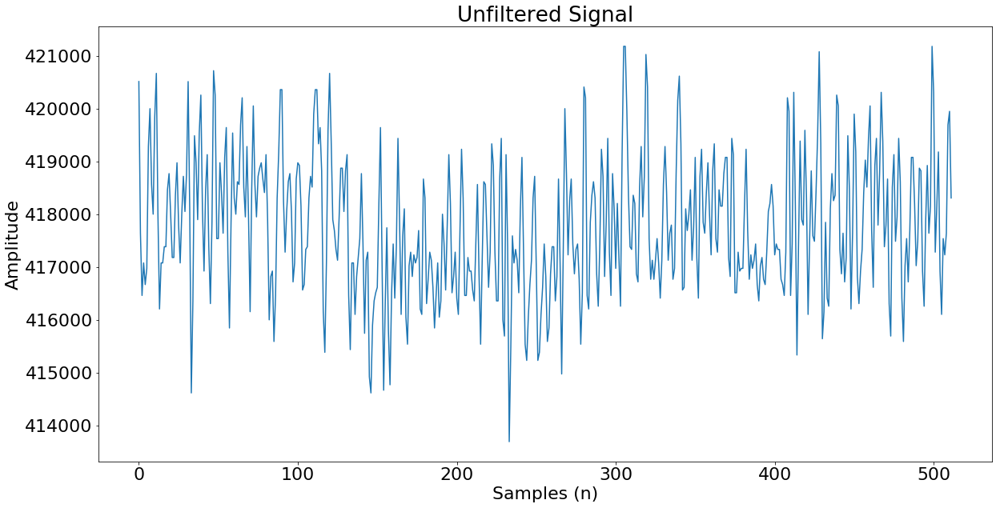

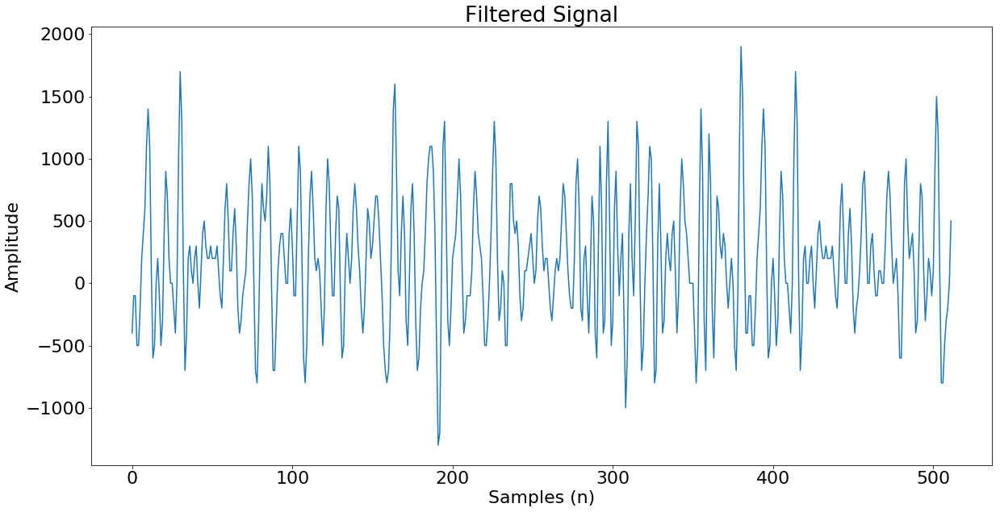

Begin Detecting SSVEP
Fundamental Frequency Peaks
[   72.  2260.   122.    49.   244.]
1st Harmonic Frequency Peaks
[   97.  1730.   520.   288.    58.]


AVG PEAK 5 151.0
AVG PEAK 4 168.5
AVG PEAK 3 321.0
AVG PEAK 2 1995.0
AVG PEAK 1 84.5
Detected Class: [2]


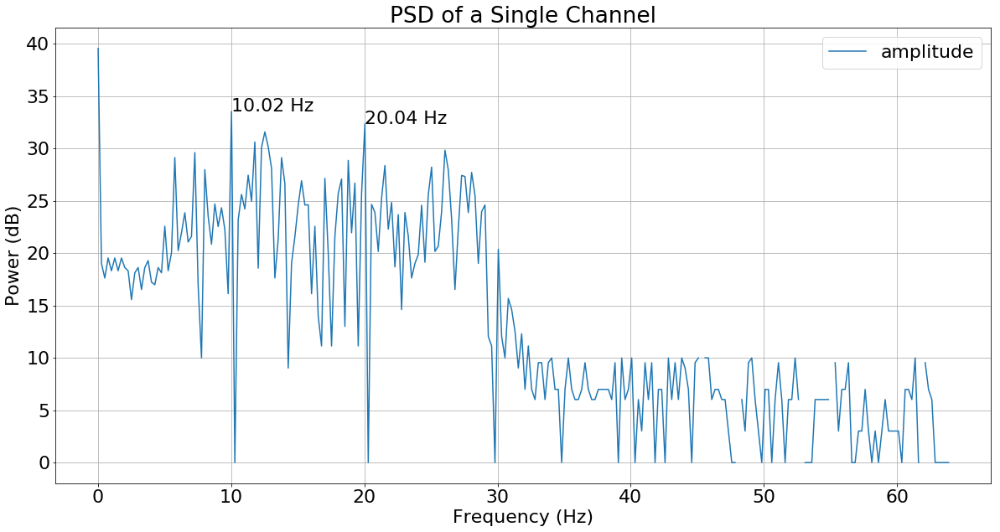

Iteration 22
POINTER 2816 3328
HW FIR excl Transfer latencies: 0.001027822494506836
HW FIR: 0.07994318008422852
HW FFT excl Transfer latencies: 0.0008500609999941844
HW FFT: 0.08891630172729492


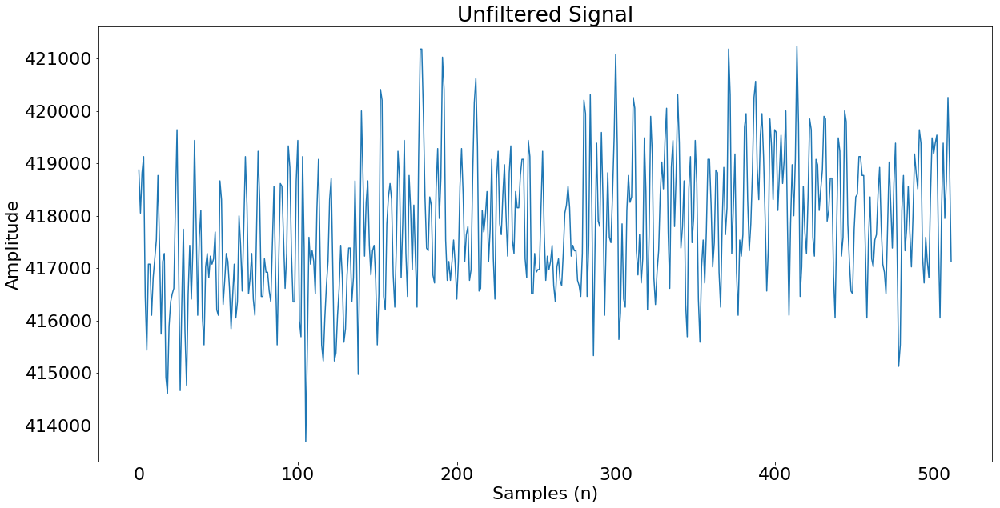

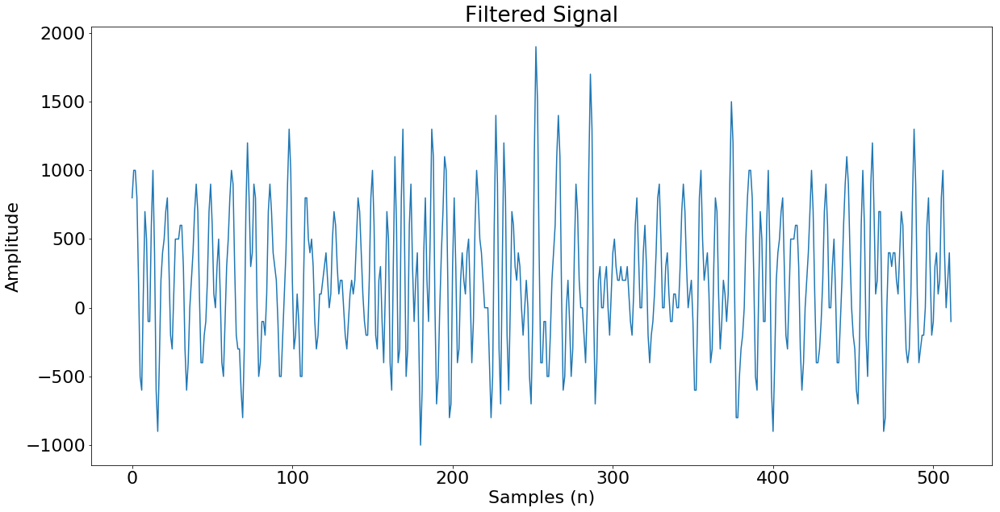

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  369.  1220.   245.    85.   245.]
1st Harmonic Frequency Peaks
[  793.  1117.   106.   997.    85.]


AVG PEAK 5 165.0
AVG PEAK 4 541.0
AVG PEAK 3 175.5
AVG PEAK 2 1168.5
AVG PEAK 1 581.0
Detected Class: [2]


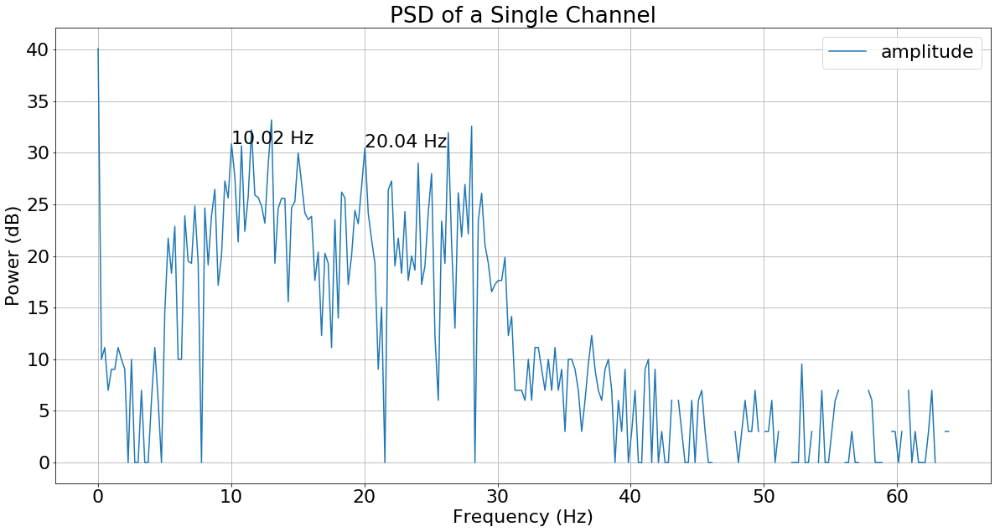

Iteration 23
POINTER 2944 3456
HW FIR excl Transfer latencies: 0.0011129379272460938
HW FIR: 0.08539104461669922
HW FFT excl Transfer latencies: 0.0008485200000052373
HW FFT: 0.08598208427429199


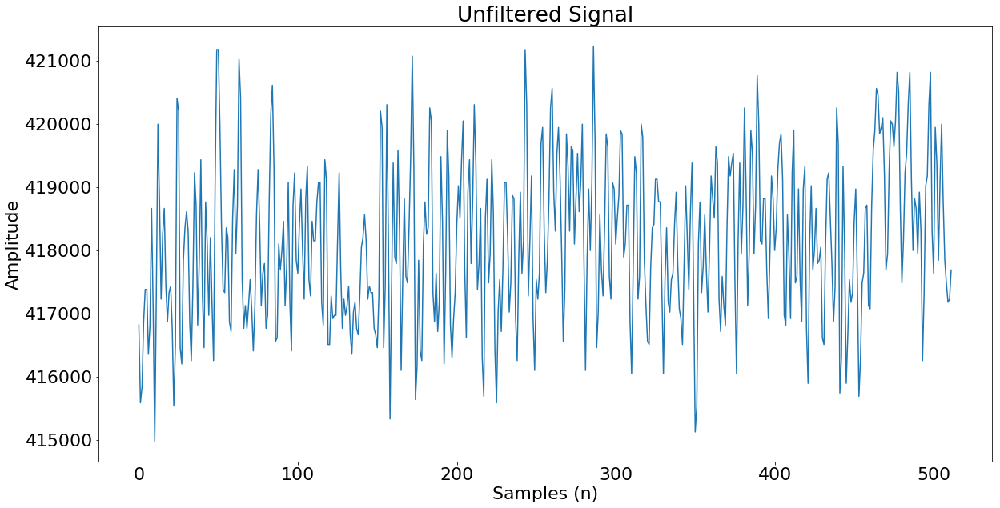

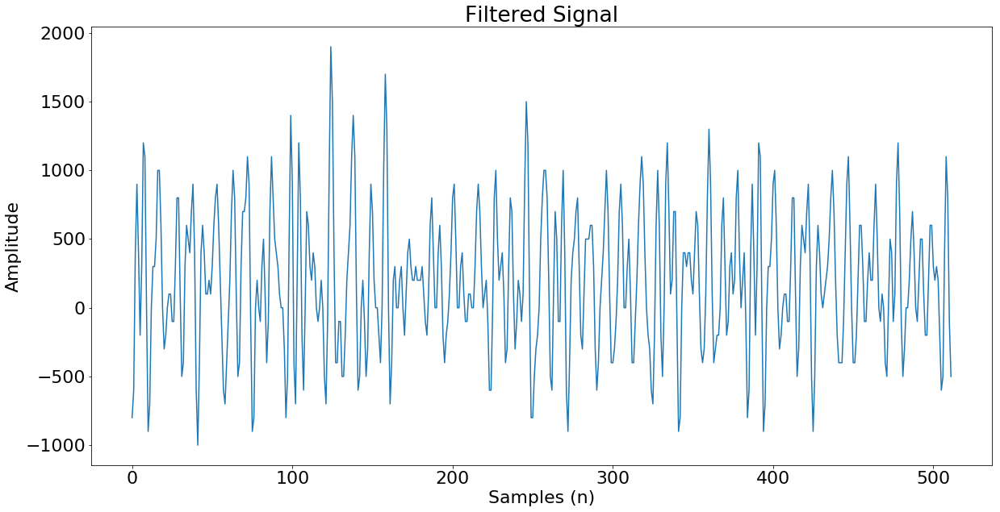

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 1130.   233.   148.   116.   145.]
1st Harmonic Frequency Peaks
[ 1202.   450.     4.  1250.  1321.]


AVG PEAK 5 733.0
AVG PEAK 4 683.0
AVG PEAK 3 76.0
AVG PEAK 2 341.5
AVG PEAK 1 1166.0
Detected Class: [1]


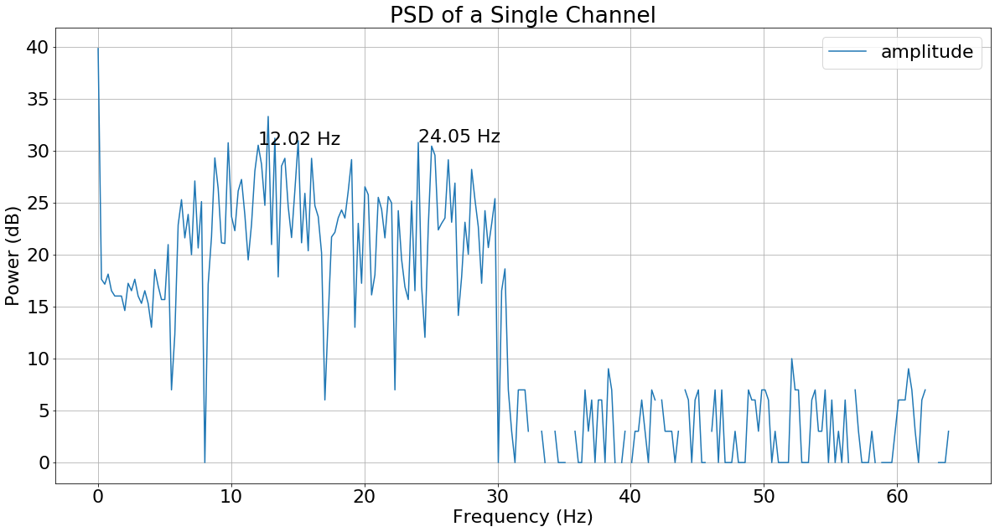

Iteration 24
POINTER 3072 3584
HW FIR excl Transfer latencies: 0.000997781753540039
HW FIR: 0.08172917366027832
HW FFT excl Transfer latencies: 0.0008568549999949937
HW FFT: 0.08447885513305664


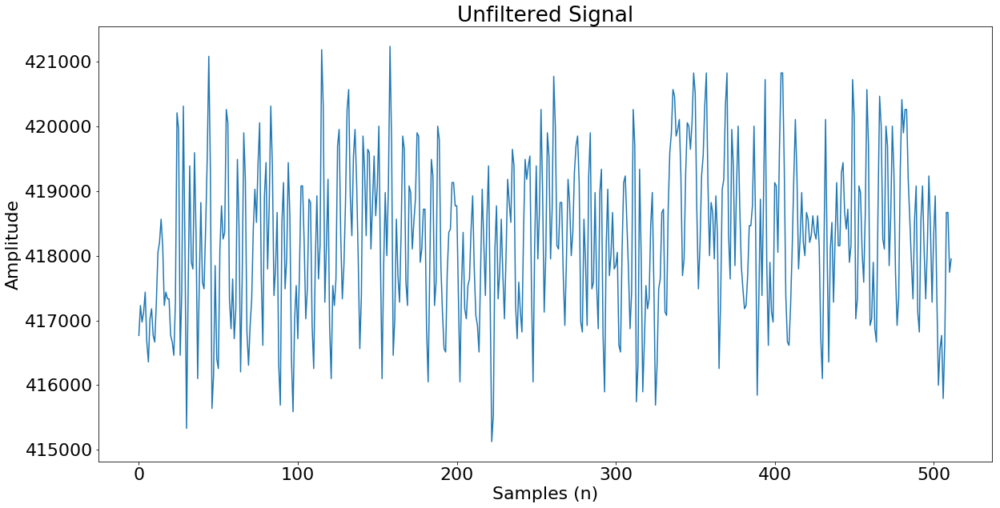

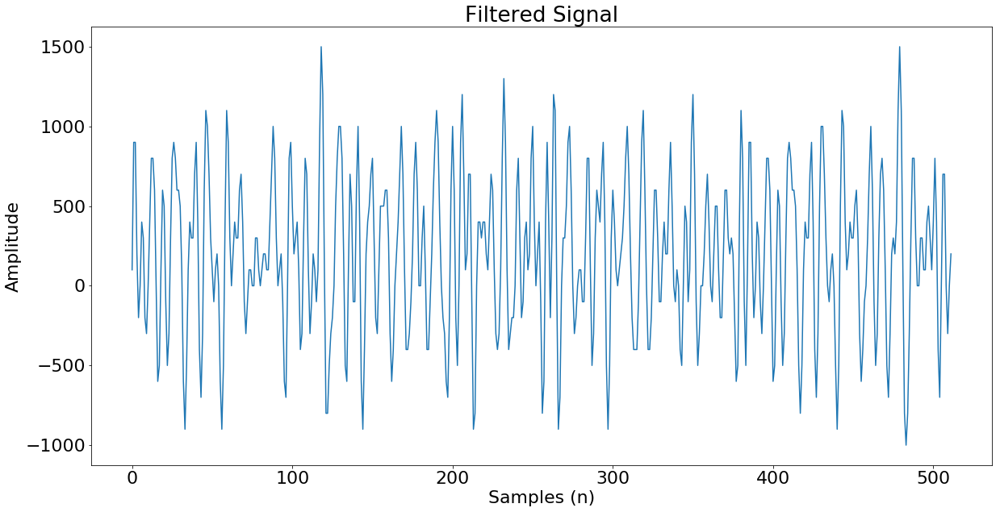

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  832.  1124.   193.   148.   185.]
1st Harmonic Frequency Peaks
[ 481.  872.    8.  610.  170.]


AVG PEAK 5 177.5
AVG PEAK 4 379.0
AVG PEAK 3 100.5
AVG PEAK 2 998.0
AVG PEAK 1 656.5
Detected Class: [2]


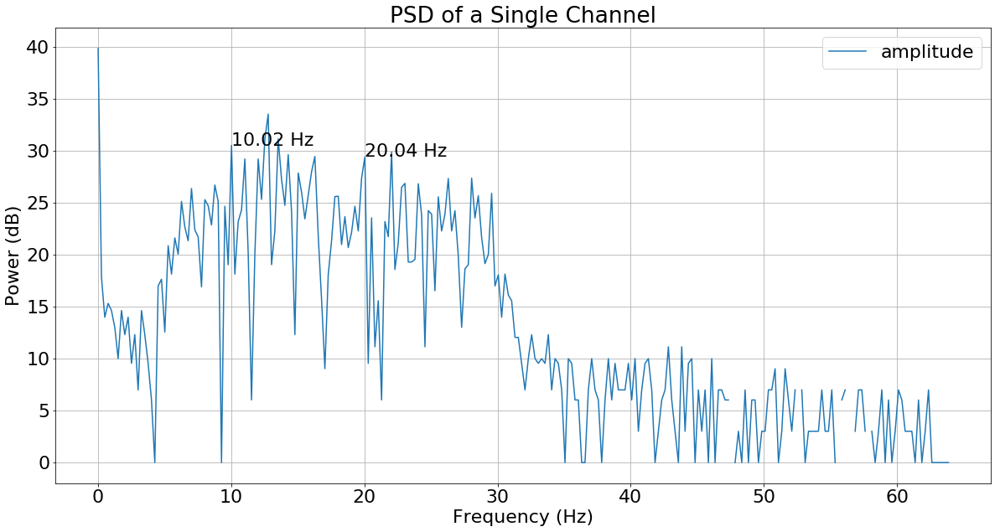

Iteration 25
POINTER 3200 3712
HW FIR excl Transfer latencies: 0.0011096000671386719
HW FIR: 1.171435832977295
HW FFT excl Transfer latencies: 0.0008519699999851582
HW FFT: 0.07877731323242188


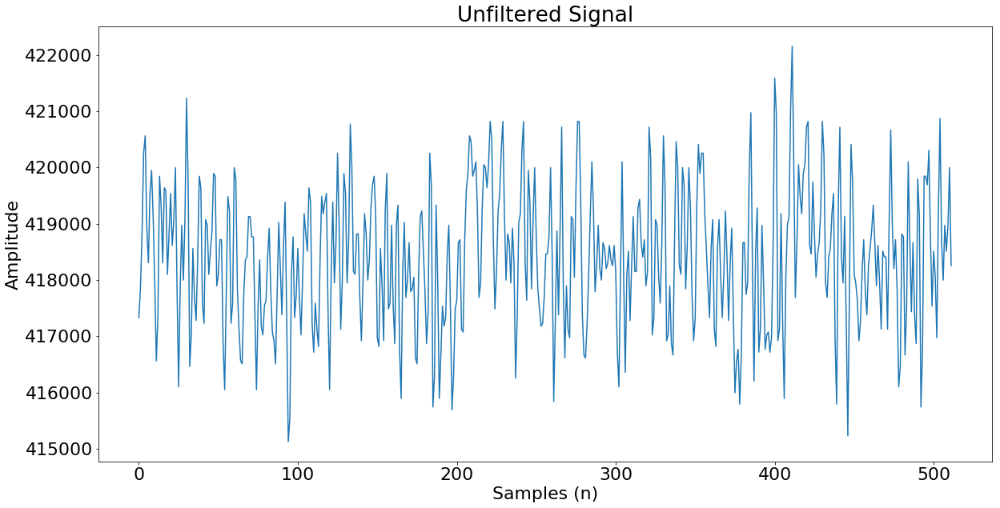

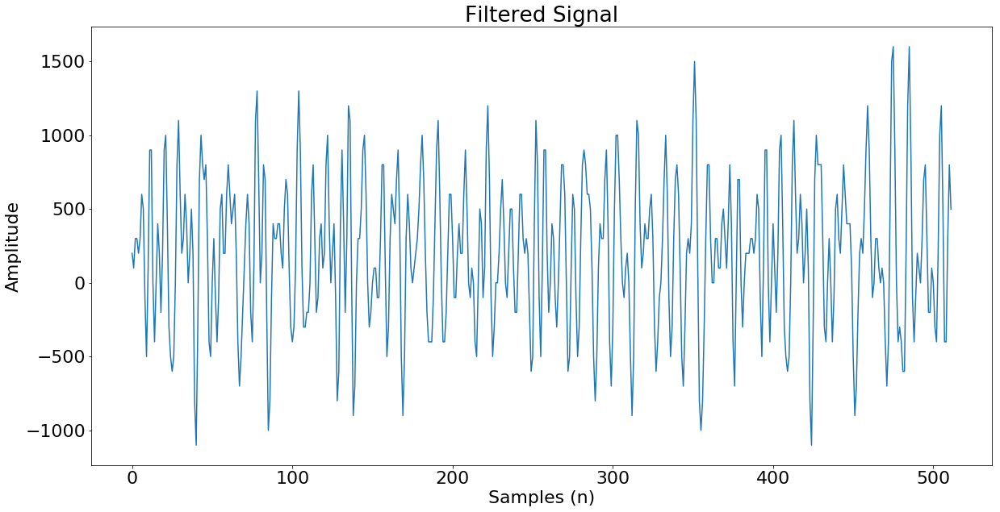

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 617.   65.    5.  290.  137.]
1st Harmonic Frequency Peaks
[  53.  409.  232.  820.  260.]


AVG PEAK 5 198.5
AVG PEAK 4 555.0
AVG PEAK 3 118.5
AVG PEAK 2 237.0
AVG PEAK 1 335.0


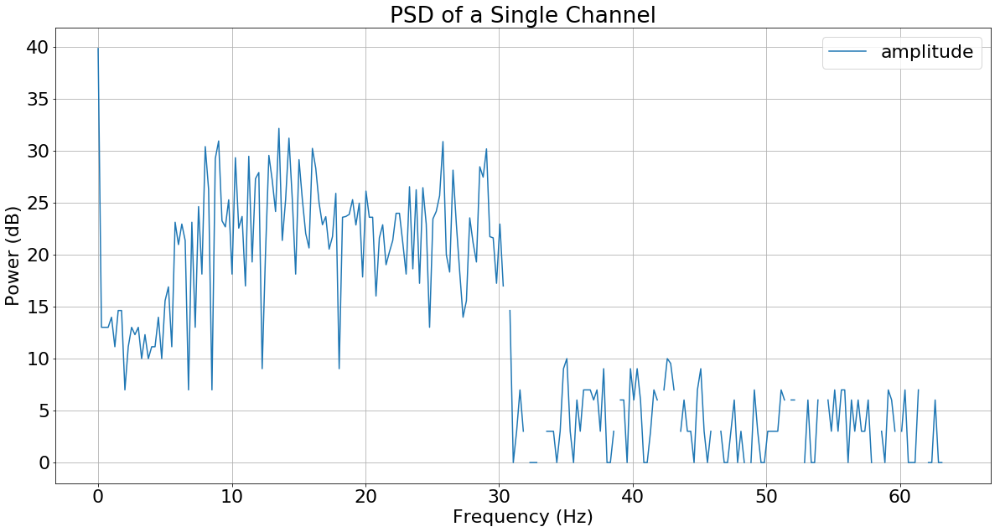

Iteration 26
POINTER 3328 3840
HW FIR excl Transfer latencies: 0.0009715557098388672
HW FIR: 0.08241891860961914
HW FFT excl Transfer latencies: 0.000848164000046836
HW FFT: 0.08179211616516113


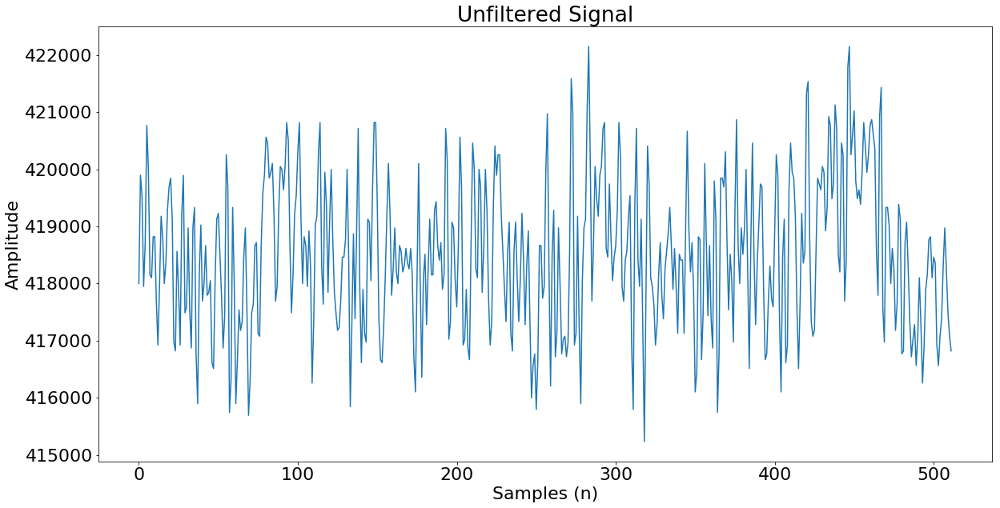

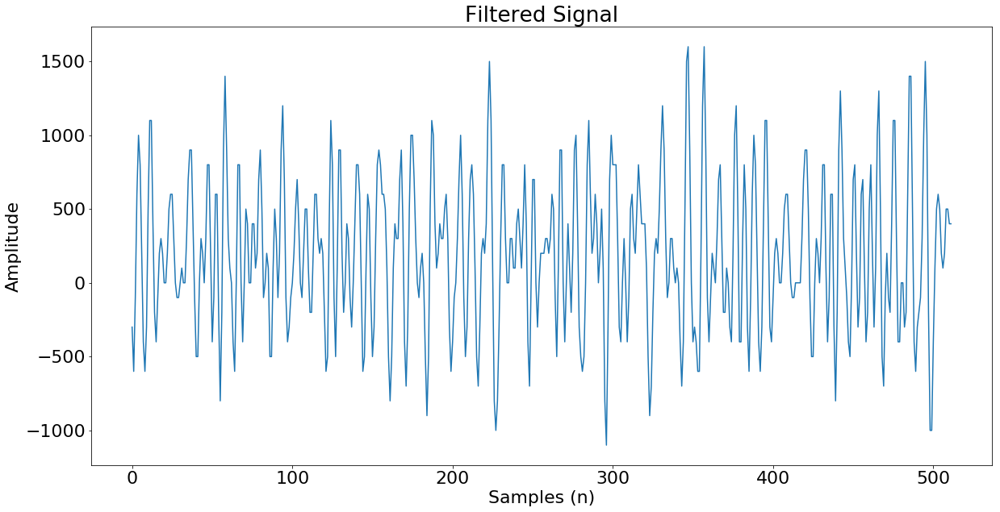

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 1088.    65.    85.    90.   101.]
1st Harmonic Frequency Peaks
[  221.   146.   605.    18.  1220.]


AVG PEAK 5 660.5
AVG PEAK 4 54.0
AVG PEAK 3 345.0
AVG PEAK 2 105.5
AVG PEAK 1 654.5


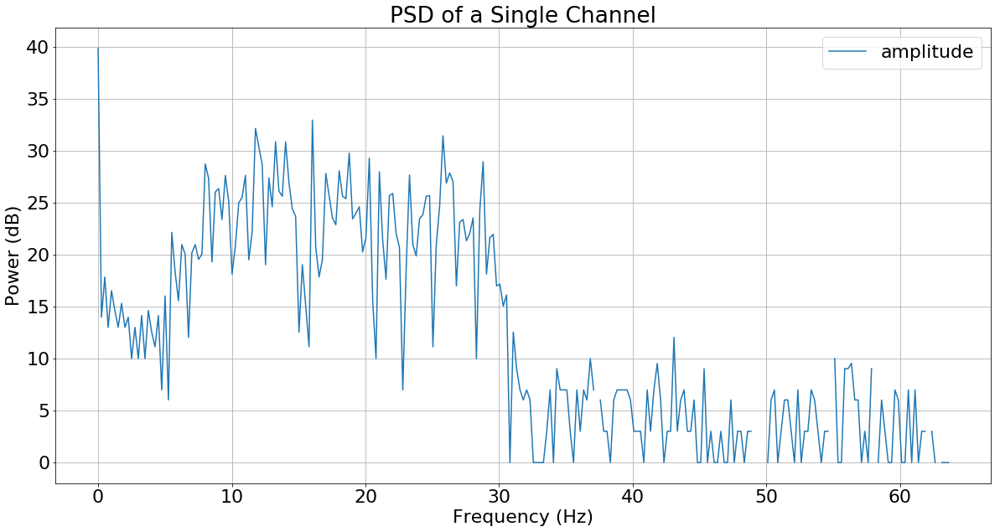

Iteration 27
POINTER 3456 3968
HW FIR excl Transfer latencies: 0.0010025501251220703
HW FIR: 0.0965116024017334
HW FFT excl Transfer latencies: 0.0008459539999989829
HW FFT: 0.07267999649047852


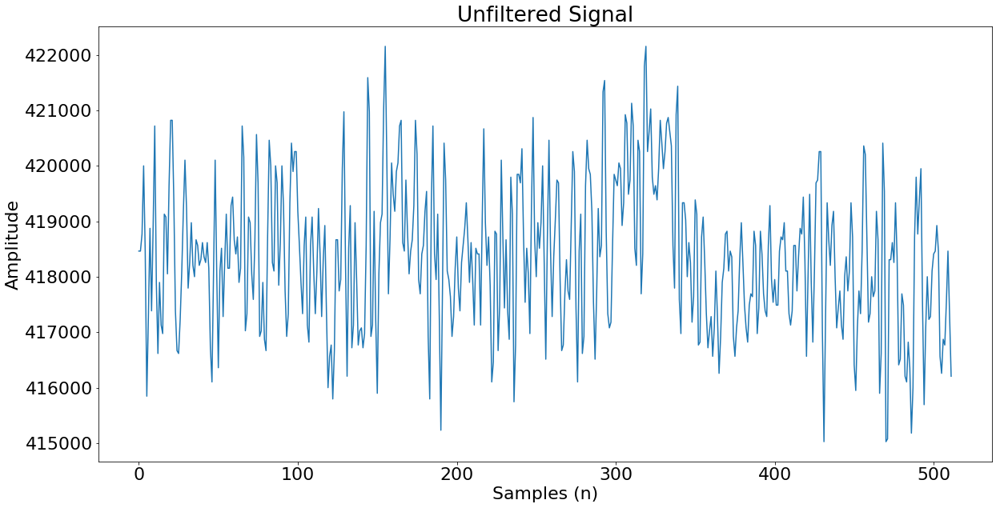

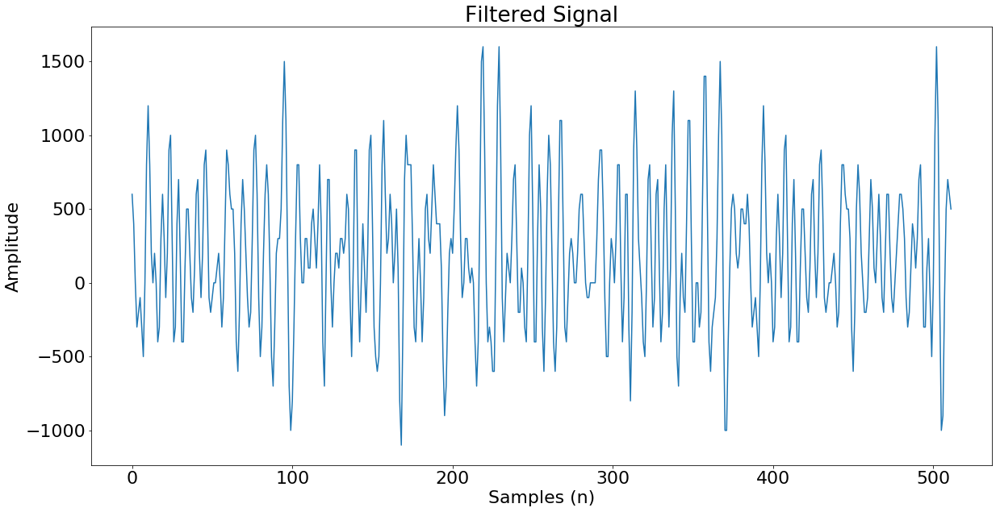

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  25.  356.  397.   17.   20.]
1st Harmonic Frequency Peaks
[   65.   101.   125.   305.  1805.]


AVG PEAK 5 912.5
AVG PEAK 4 161.0
AVG PEAK 3 261.0
AVG PEAK 2 228.5
AVG PEAK 1 45.0
Detected Class: [5]


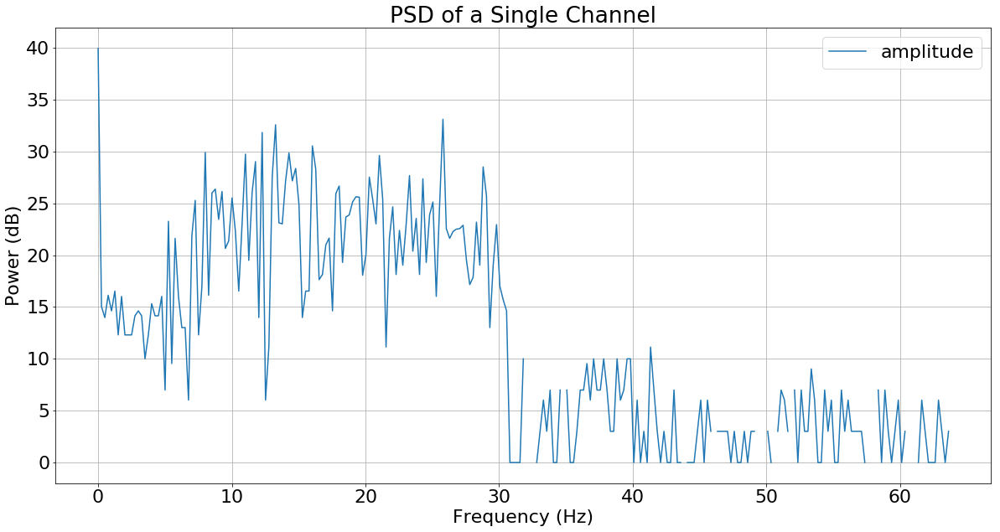

Iteration 28
POINTER 3584 4096
HW FIR excl Transfer latencies: 0.0010378360748291016
HW FIR: 0.08715939521789551
HW FFT excl Transfer latencies: 0.0008422280000104365
HW FFT: 0.08480954170227051


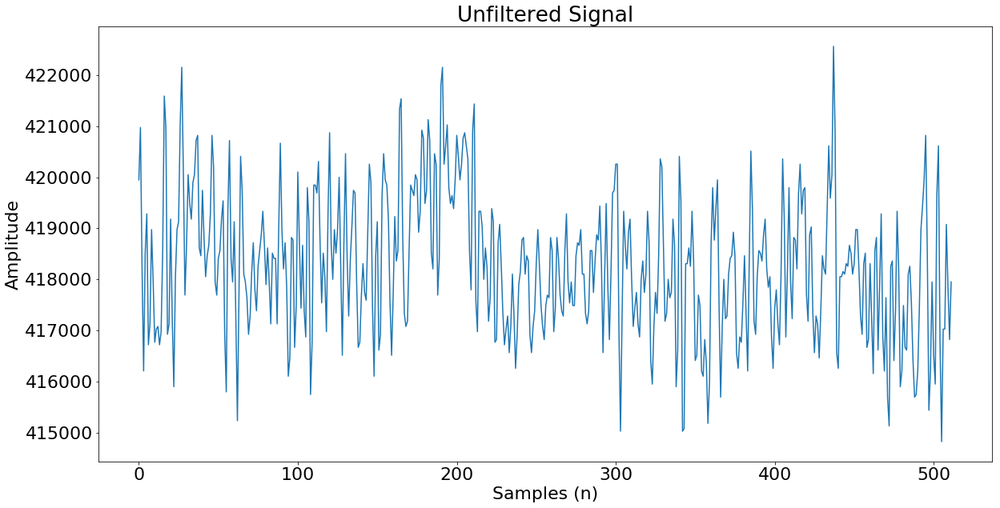

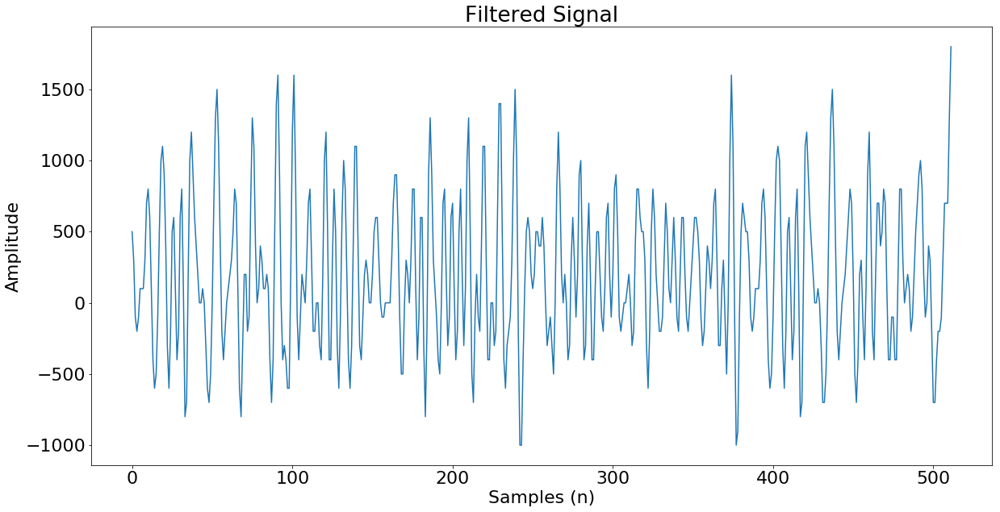

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 180.  306.  356.   45.   20.]
1st Harmonic Frequency Peaks
[  234.   605.    41.   296.  2025.]


AVG PEAK 5 1022.5
AVG PEAK 4 170.5
AVG PEAK 3 198.5
AVG PEAK 2 455.5
AVG PEAK 1 207.0
Detected Class: [5]


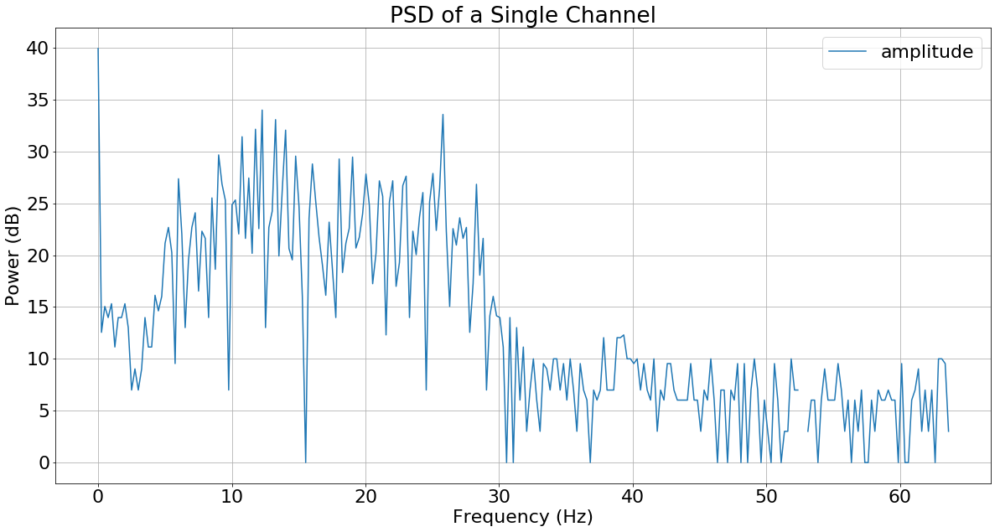

Iteration 29
POINTER 3712 4224
HW FIR excl Transfer latencies: 0.0010101795196533203
HW FIR: 0.08213019371032715
HW FFT excl Transfer latencies: 0.0008559409999975287
HW FFT: 0.08458781242370605


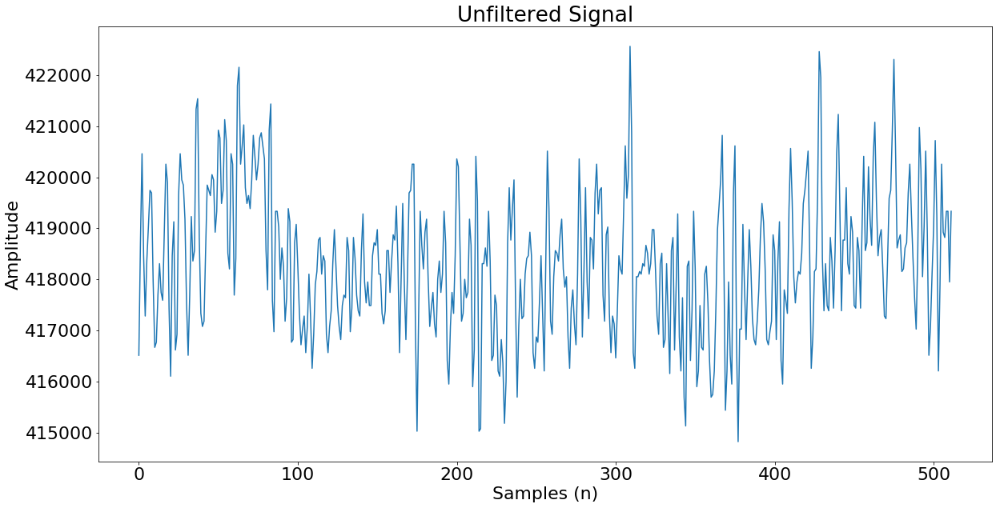

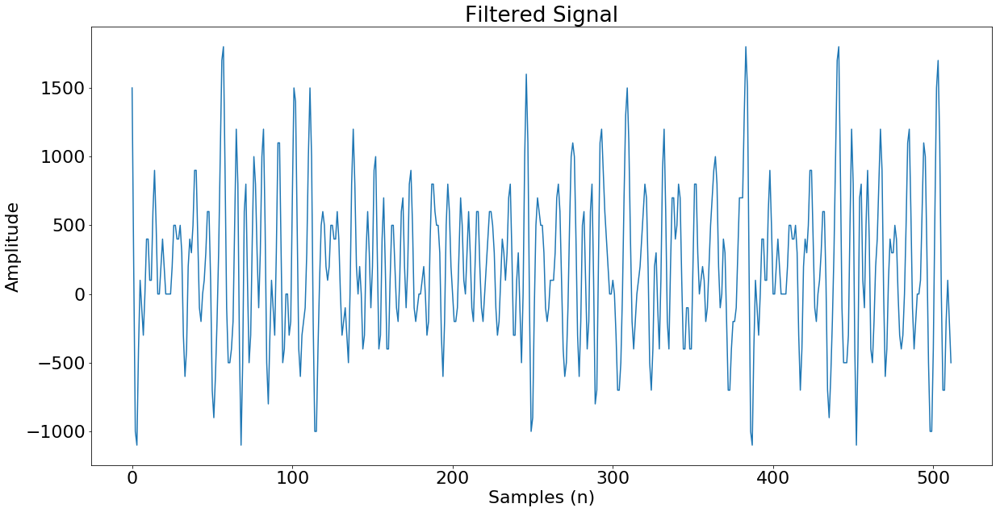

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  50.    1.  818.  274.   37.]
1st Harmonic Frequency Peaks
[ 185.  265.   89.  305.  900.]


AVG PEAK 5 468.5
AVG PEAK 4 289.5
AVG PEAK 3 453.5
AVG PEAK 2 133.0
AVG PEAK 1 117.5


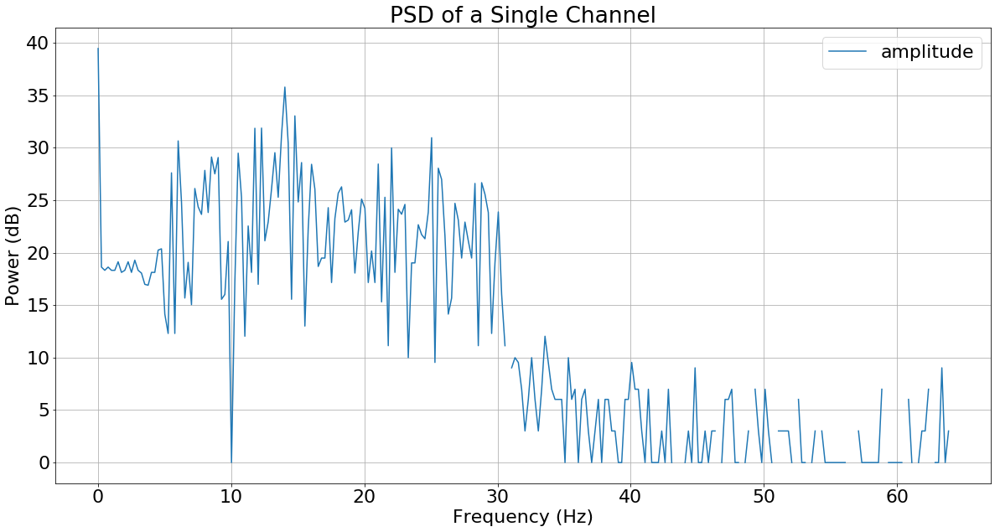

Iteration 30
POINTER 3840 4352
HW FIR excl Transfer latencies: 0.0009720325469970703
HW FIR: 0.08316349983215332
HW FFT excl Transfer latencies: 0.0008441719999723318
HW FFT: 0.08464312553405762


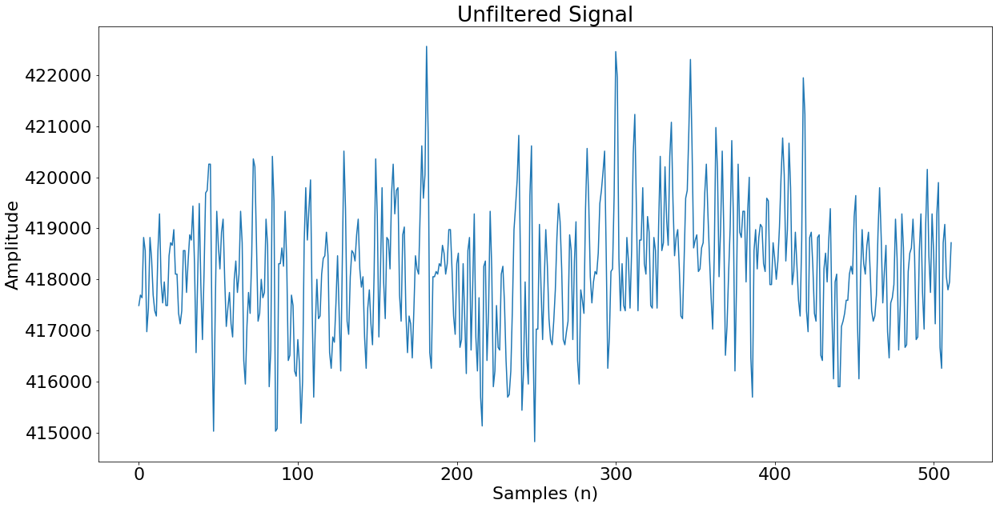

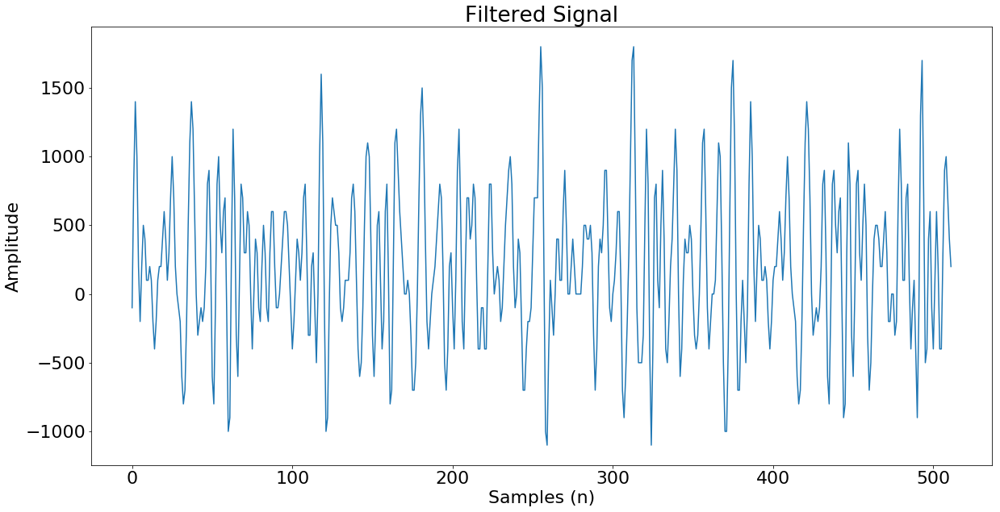

Begin Detecting SSVEP
Fundamental Frequency Peaks
[   61.    20.  1322.   137.    45.]
1st Harmonic Frequency Peaks
[ 148.  272.  265.  416.  197.]


AVG PEAK 5 121.0
AVG PEAK 4 276.5
AVG PEAK 3 793.5
AVG PEAK 2 146.0
AVG PEAK 1 104.5


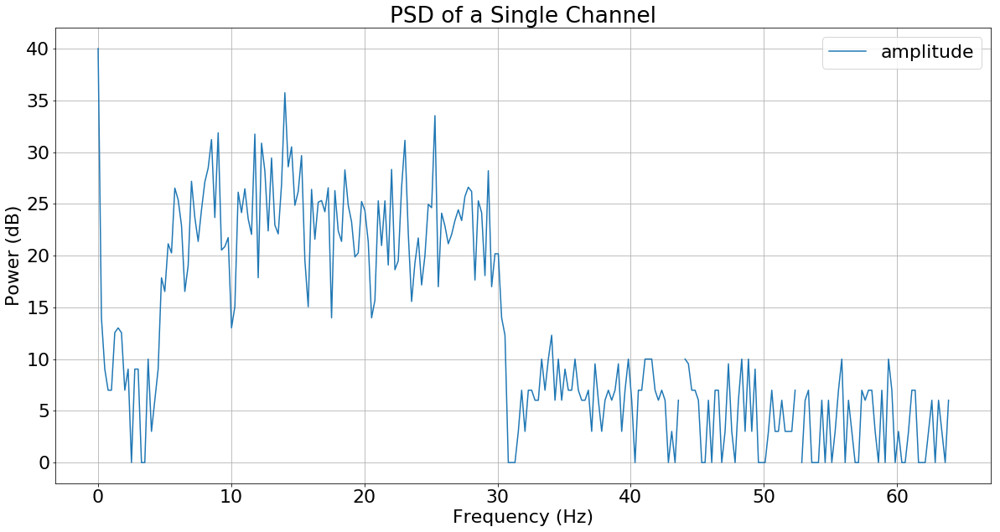

Iteration 31
POINTER 3968 4480
HW FIR excl Transfer latencies: 0.0010018348693847656
HW FIR: 0.08443689346313477
HW FFT excl Transfer latencies: 0.0008550400000331138
HW FFT: 0.08141660690307617


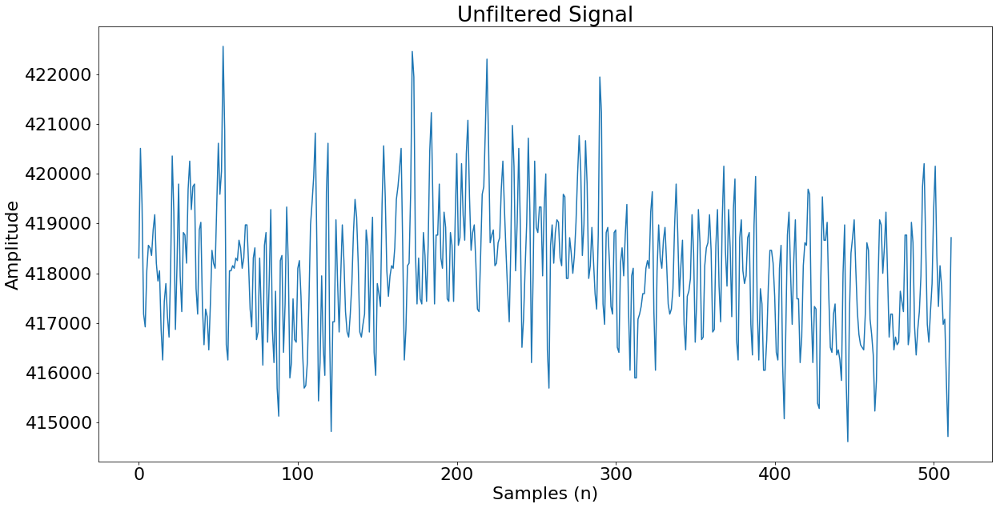

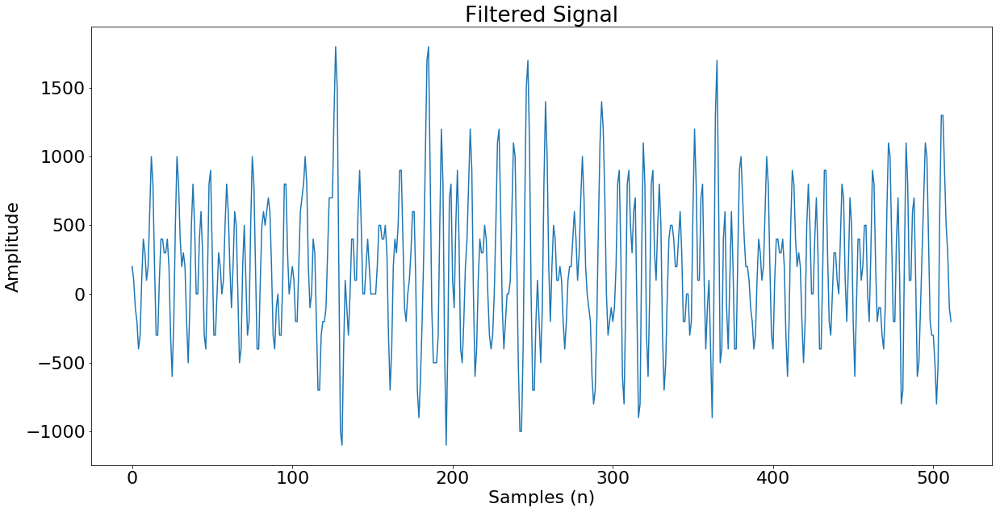

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  185.   520.  1525.   164.   221.]
1st Harmonic Frequency Peaks
[ 296.  109.  292.  612.  197.]


AVG PEAK 5 209.0
AVG PEAK 4 388.0
AVG PEAK 3 908.5
AVG PEAK 2 314.5
AVG PEAK 1 240.5
Detected Class: [3]


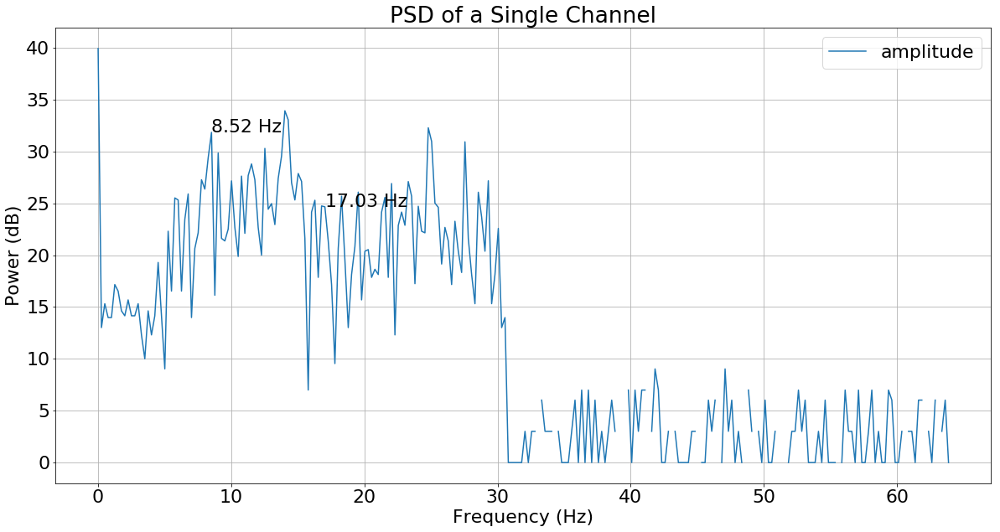

Iteration 32
POINTER 4096 4608
HW FIR excl Transfer latencies: 0.0009810924530029297
HW FIR: 0.0812685489654541
HW FFT excl Transfer latencies: 0.0008574150000413283
HW FFT: 0.08519792556762695


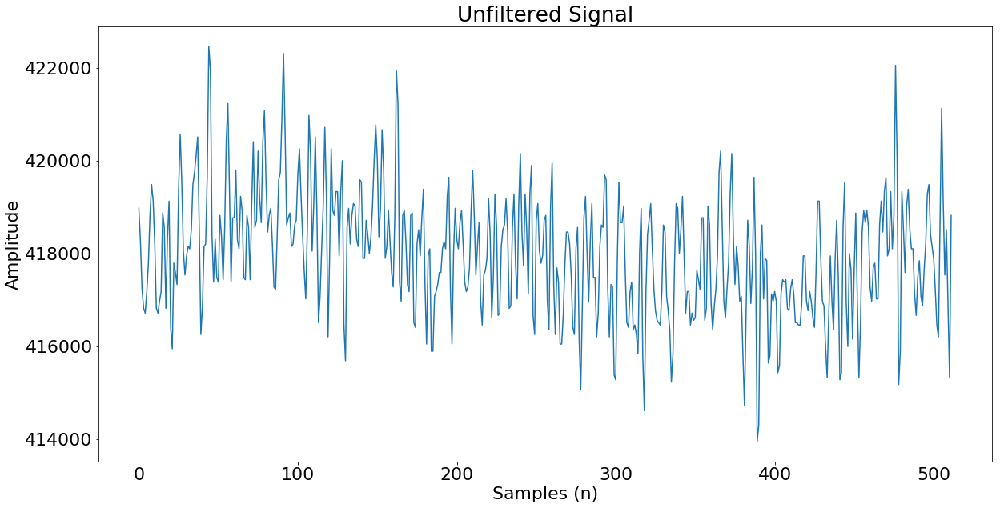

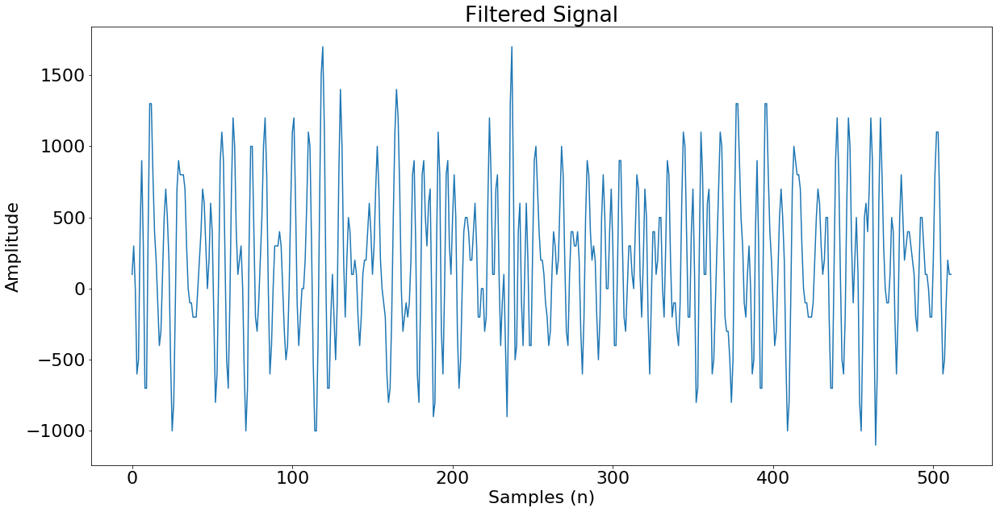

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 725.  290.  377.   65.  101.]
1st Harmonic Frequency Peaks
[  85.  404.  545.  898.   74.]


AVG PEAK 5 87.5
AVG PEAK 4 481.5
AVG PEAK 3 461.0
AVG PEAK 2 347.0
AVG PEAK 1 405.0


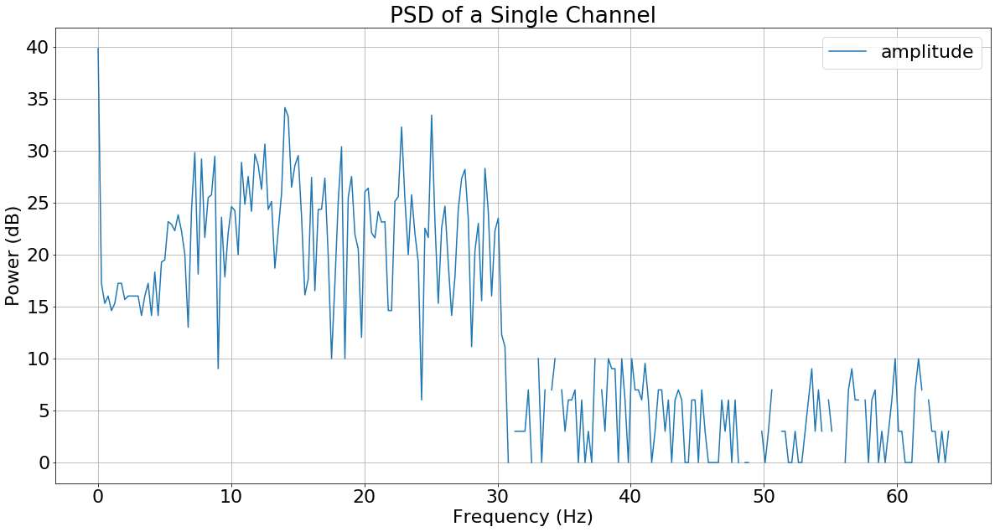

Iteration 33
POINTER 4224 4736
HW FIR excl Transfer latencies: 0.0008873939514160156
HW FIR: 0.08586454391479492
HW FFT excl Transfer latencies: 0.0008601160000125674
HW FFT: 0.07899093627929688


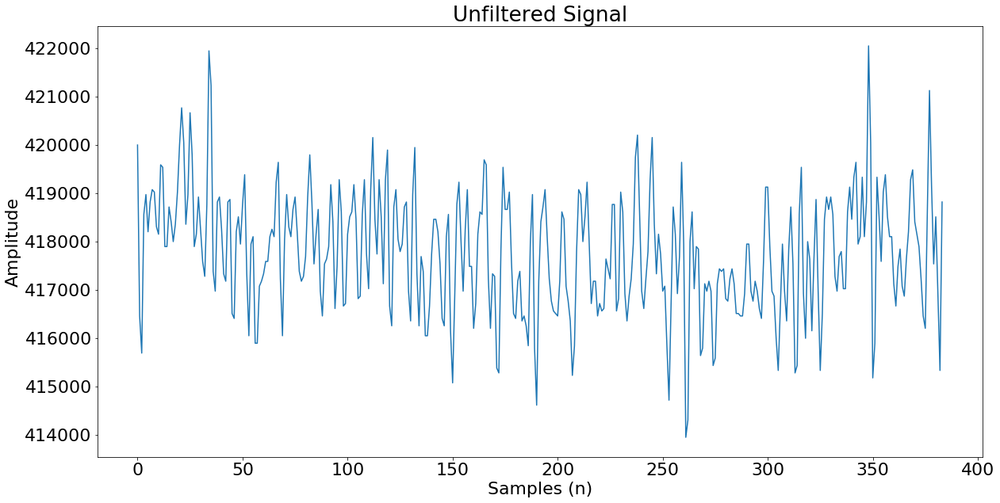

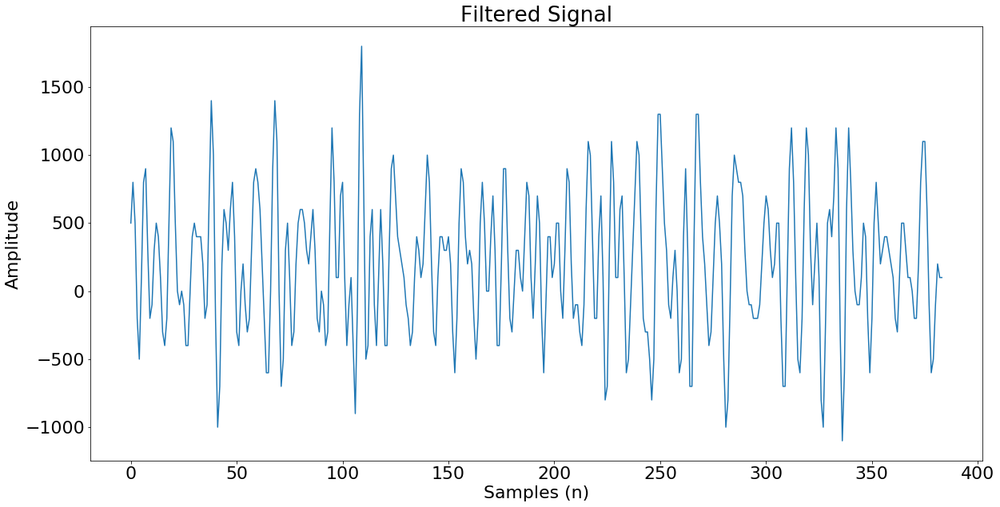

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 104.  617.  130.  257.    9.]
1st Harmonic Frequency Peaks
[ 104.  208.  178.  205.   53.]


AVG PEAK 5 31.0
AVG PEAK 4 231.0
AVG PEAK 3 154.0
AVG PEAK 2 412.5
AVG PEAK 1 104.0


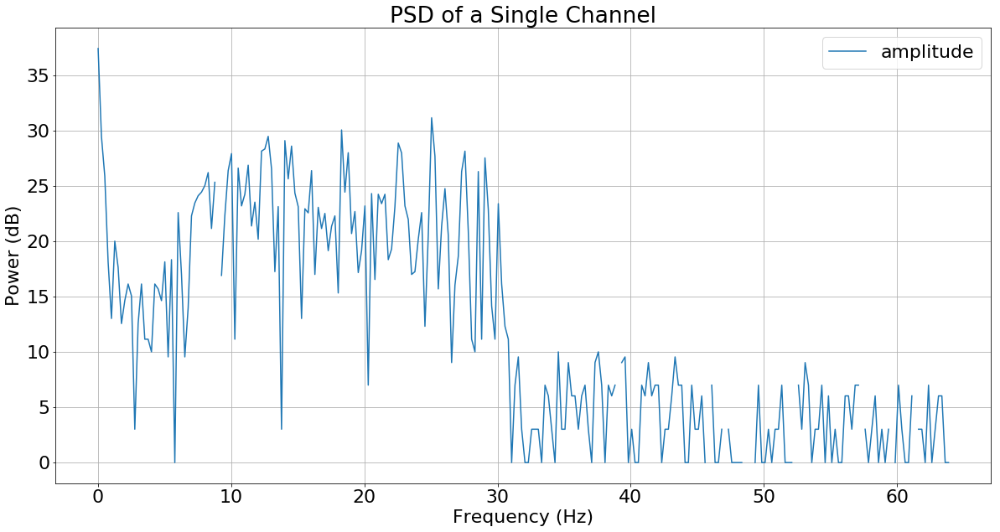

Iteration 34
POINTER 4352 4864
HW FIR excl Transfer latencies: 0.0008893013000488281
HW FIR: 0.08679389953613281
HW FFT excl Transfer latencies: 0.0008514119999745162
HW FFT: 0.08391594886779785


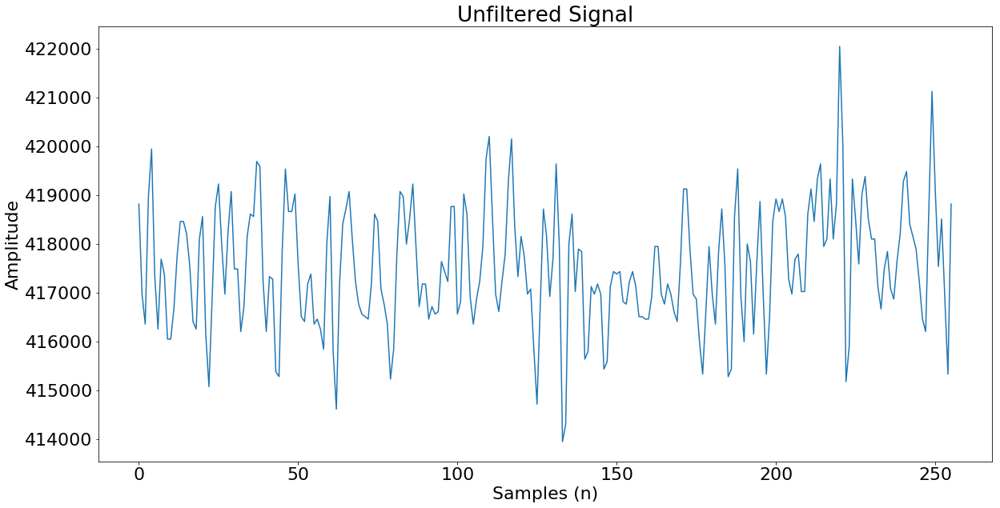

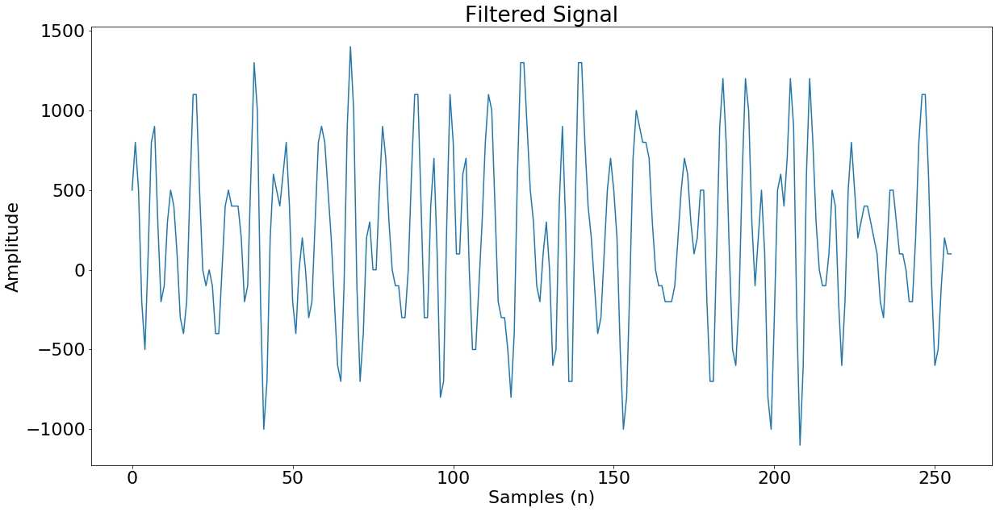

Begin Detecting SSVEP
Fundamental Frequency Peaks
[ 257.  244.  136.  362.   34.]
1st Harmonic Frequency Peaks
[  65.  149.   98.   49.   29.]


AVG PEAK 5 31.5
AVG PEAK 4 205.5
AVG PEAK 3 117.0
AVG PEAK 2 196.5
AVG PEAK 1 161.0


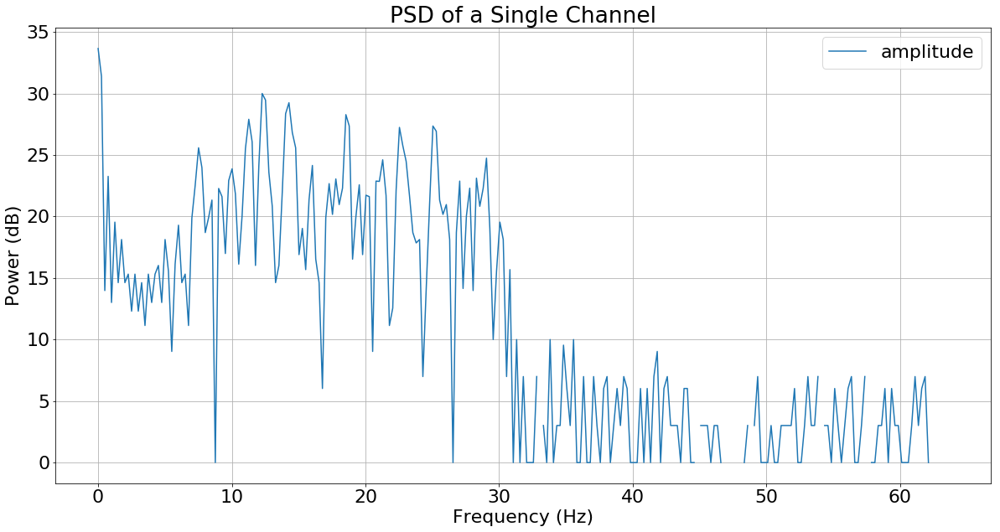

Iteration 35
POINTER 4480 4992
HW FIR excl Transfer latencies: 0.0009369850158691406
HW FIR: 0.08241081237792969
HW FFT excl Transfer latencies: 0.0008486119999702169
HW FFT: 0.08618903160095215


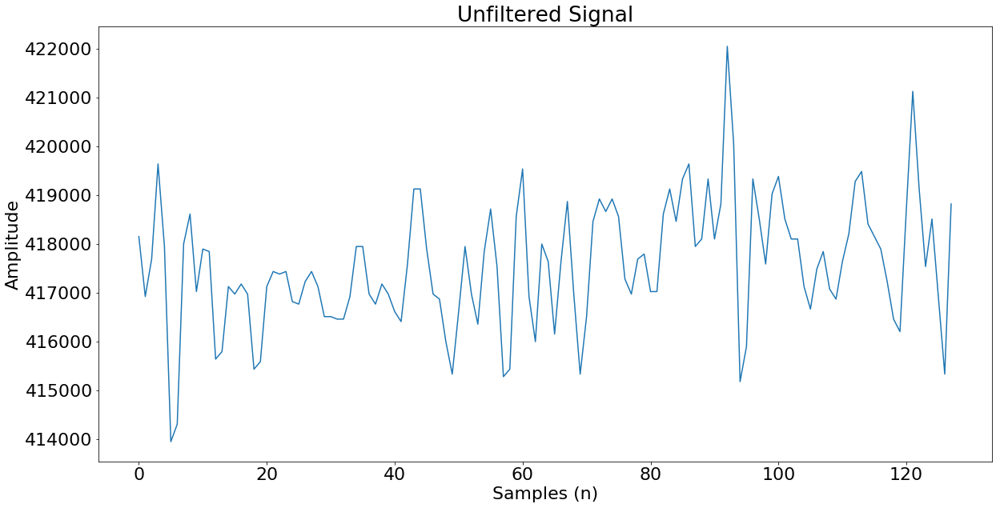

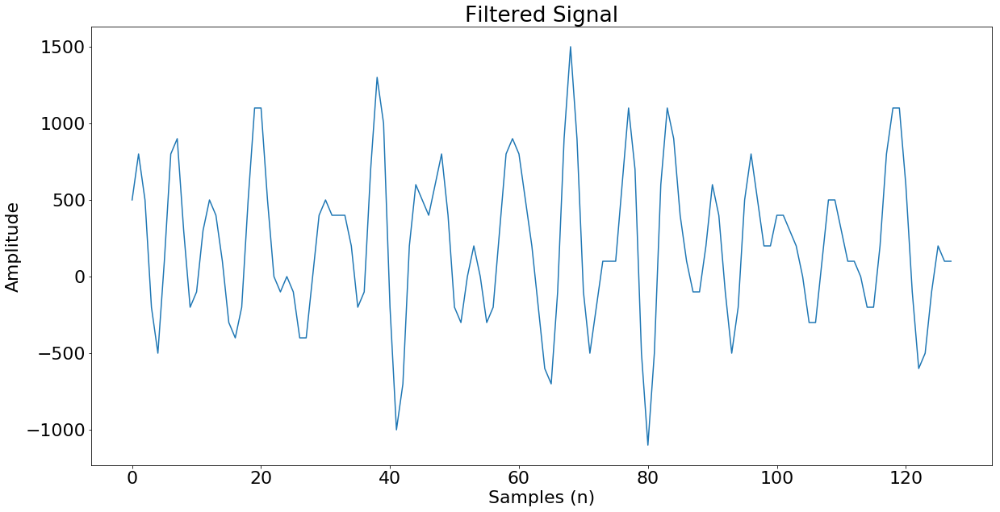

Begin Detecting SSVEP
Fundamental Frequency Peaks
[  16.  116.    5.    4.    5.]
1st Harmonic Frequency Peaks
[  20.   82.  125.   34.  185.]


AVG PEAK 5 95.0
AVG PEAK 4 19.0
AVG PEAK 3 65.0
AVG PEAK 2 99.0
AVG PEAK 1 18.0


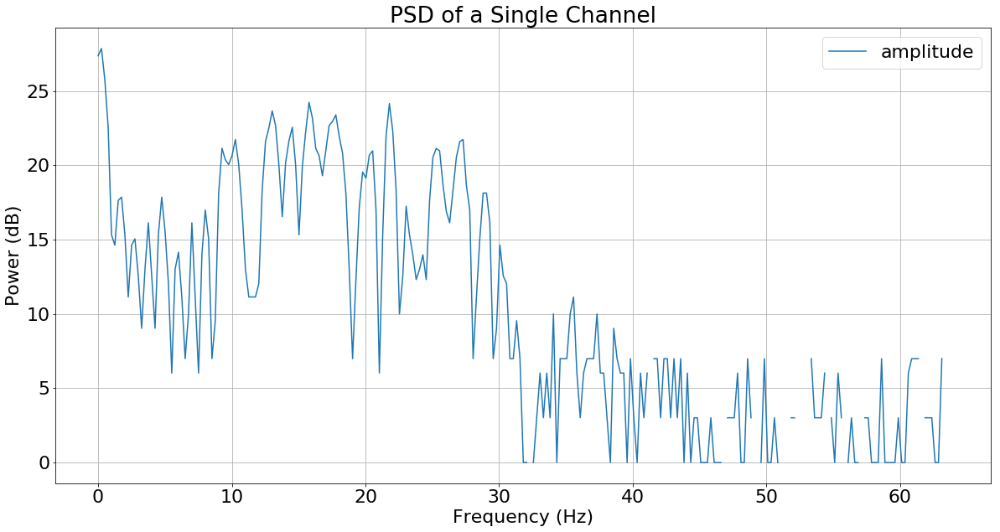

In [9]:
processingTime_df = pd.DataFrame([], columns=["Data Pointer","Time stamp", "Frame Duration"])
coeffs = overlay.filter_design(f_samp, 5, 30)
data = eeg["O1"]

test_duration = 36

data = data[0:f_samp*test_duration] * 100
data = np.asarray(data, np.int32)
overlay.pynq_BCI_DSP(data, NFFT, f_samp, overlap = .25, multichannel=False, plot_data=True)

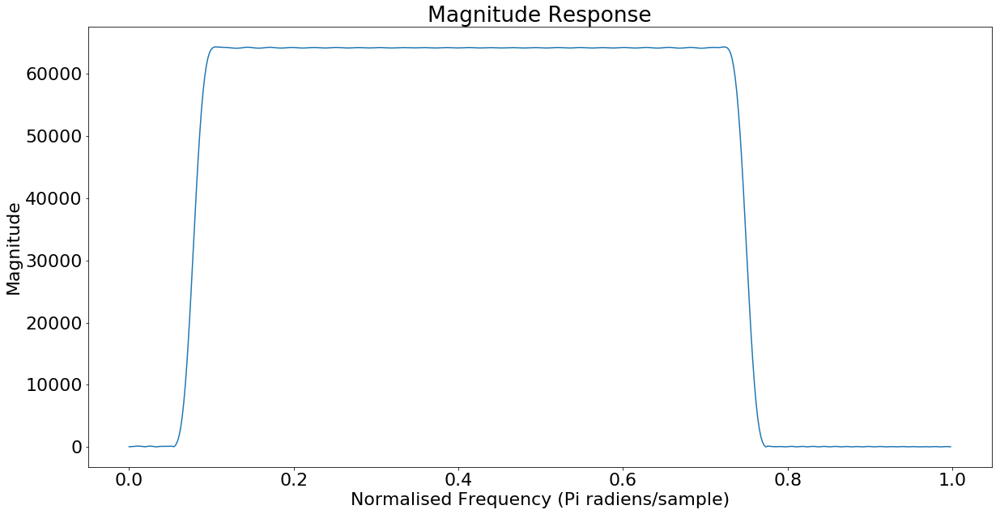

Number of channels: 4
Appending 1 zeros to the signal
Number of iterations 32.0
Iteration 0
POINTER 0 512


/usr/lib/python3/dist-packages/ipykernel_launcher.py:211: RuntimeWarning: divide by zero encountered in log10


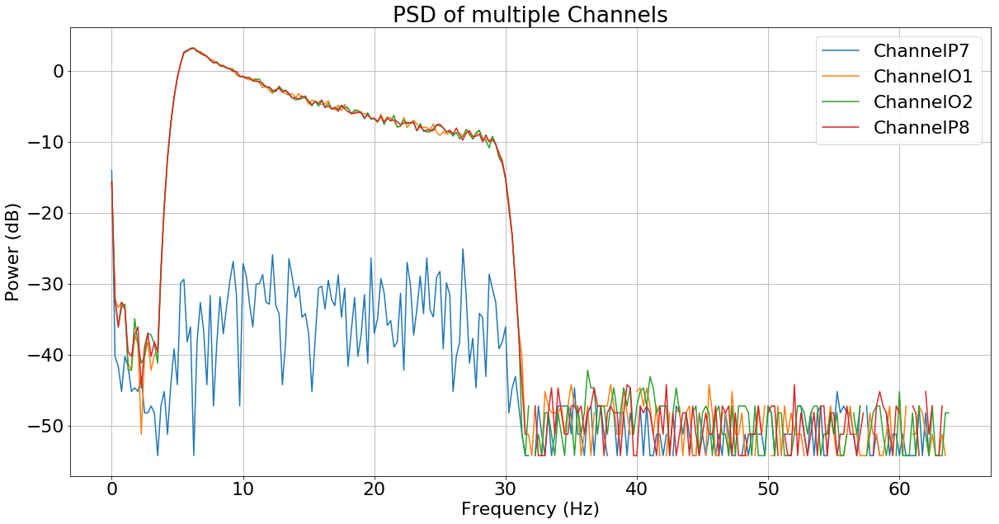

Channel Ouput: [1 5 5 5]
Mode: [4]
Counts: [3]
Detected Class: 5
Iteration 1
POINTER 128 640


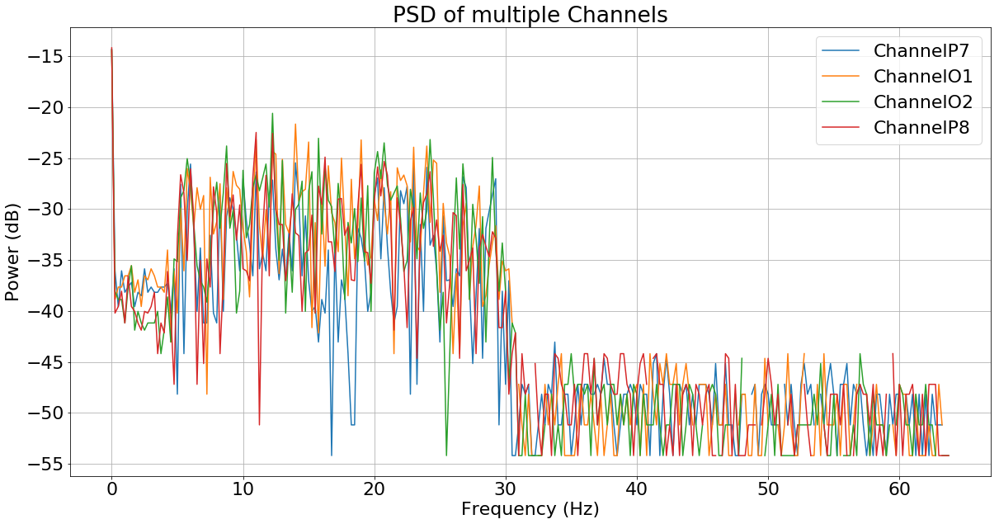

Channel Ouput: [1 4 2 1]
Mode: [0]
Counts: [2]
Iteration 2
POINTER 256 768


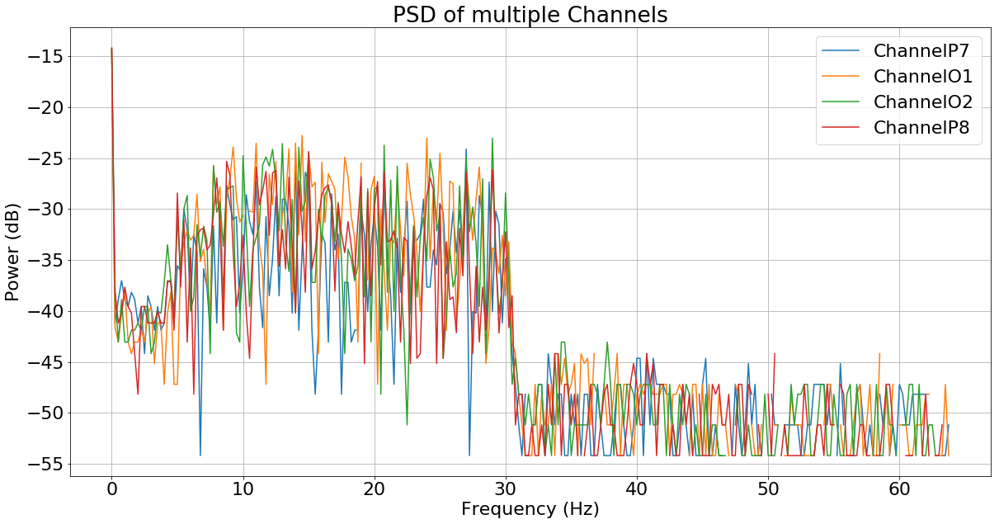

Channel Ouput: [4 1 2 4]
Mode: [3]
Counts: [2]
Iteration 3
POINTER 384 896


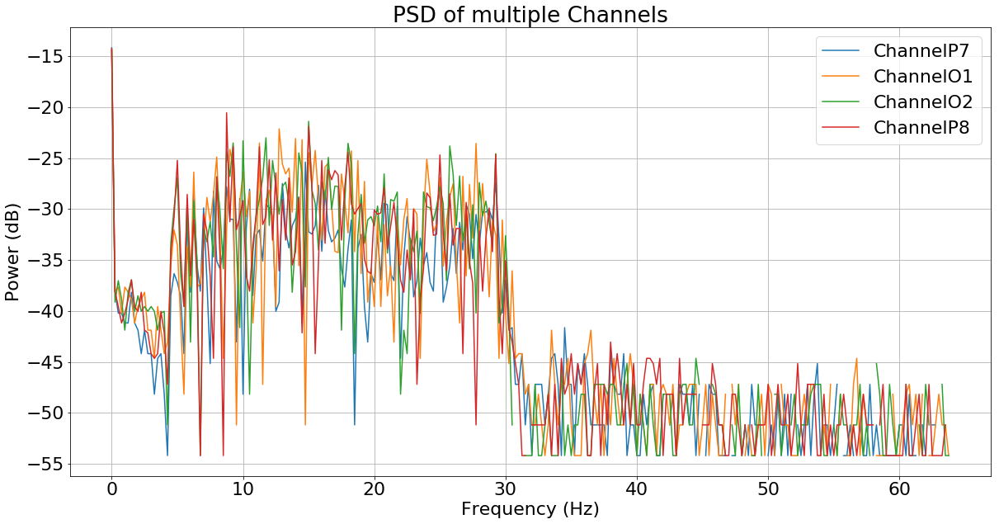

Channel Ouput: [1 1 4 4]
Mode: [0]
Counts: [2]
Iteration 4
POINTER 512 1024


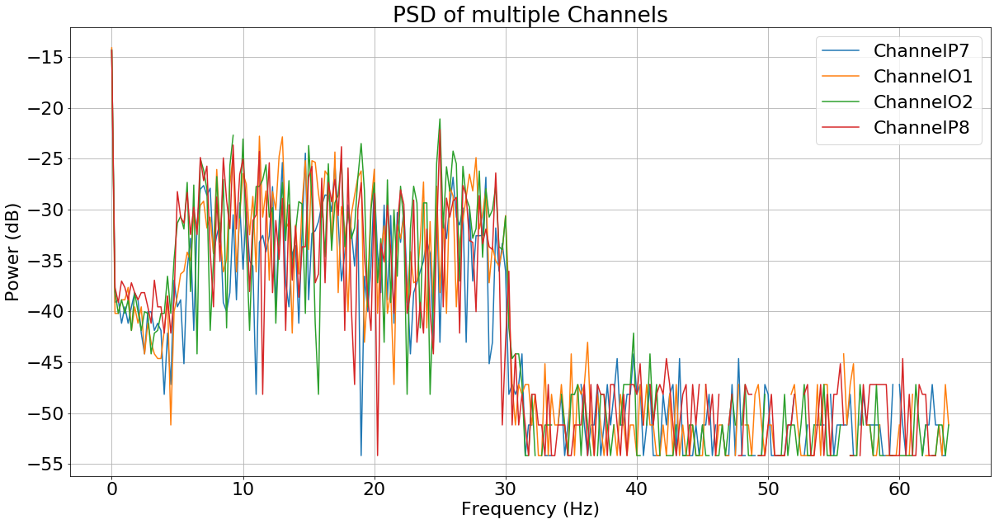

Channel Ouput: [3 2 2 3]
Mode: [1]
Counts: [2]
Iteration 5
POINTER 640 1152


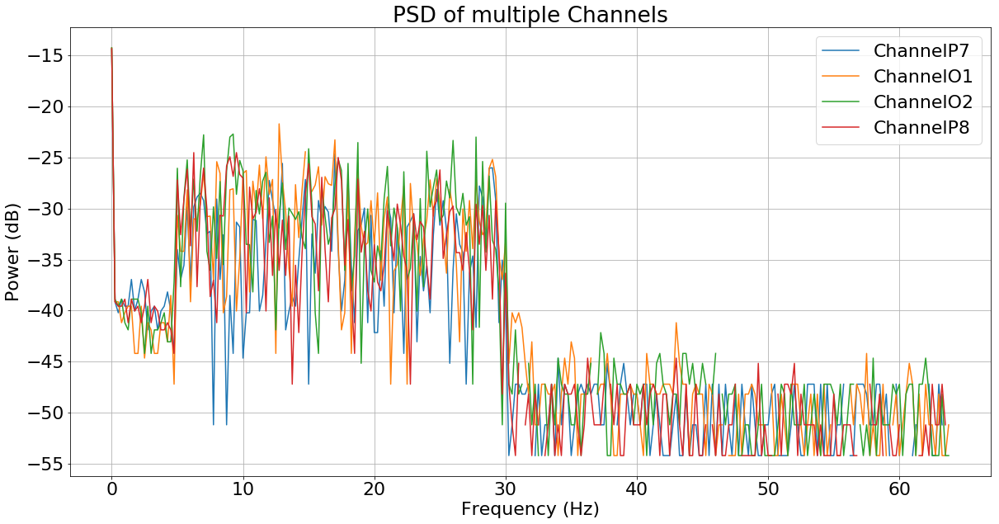

Channel Ouput: [3 3 1 4]
Mode: [2]
Counts: [2]
Iteration 6
POINTER 768 1280


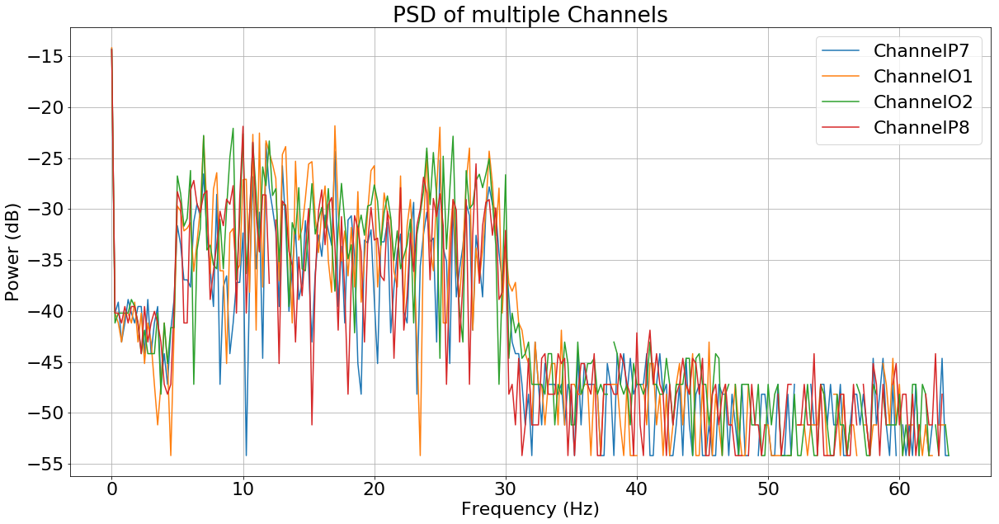

Channel Ouput: [3 1 1 2]
Mode: [0]
Counts: [2]
Iteration 7
POINTER 896 1408


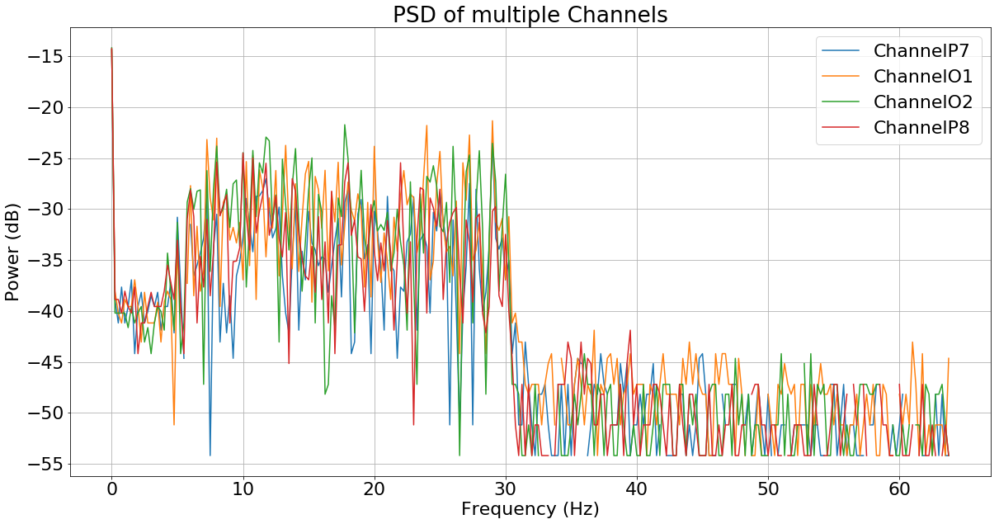

Channel Ouput: [2 1 1 2]
Mode: [0]
Counts: [2]
Iteration 8
POINTER 1024 1536


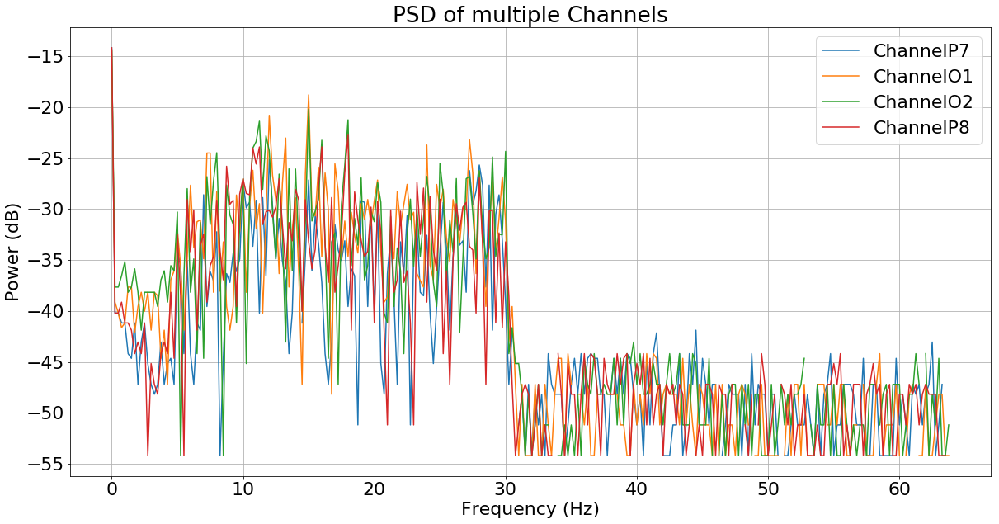

Channel Ouput: [1 4 4 2]
Mode: [3]
Counts: [2]
Iteration 9
POINTER 1152 1664


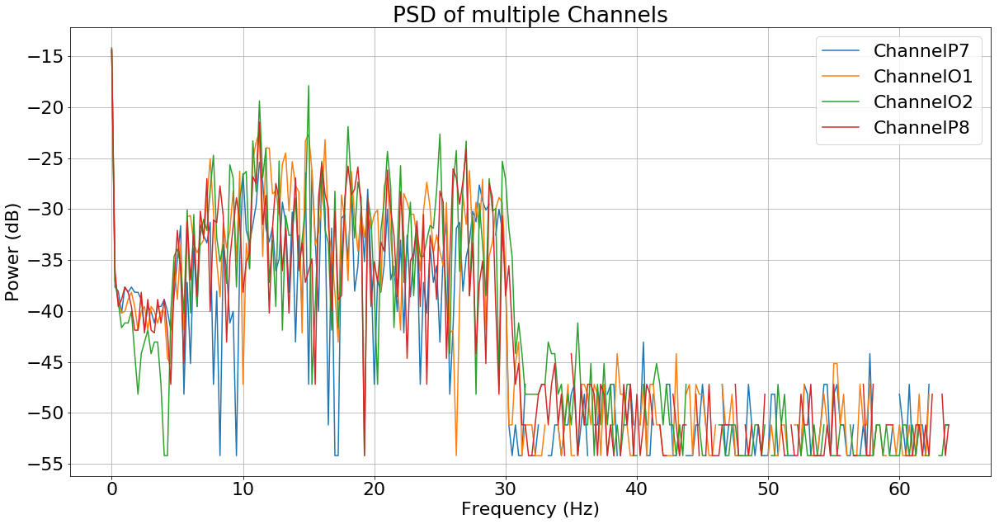

Channel Ouput: [2 4 4 3]
Mode: [3]
Counts: [2]
Iteration 10
POINTER 1280 1792


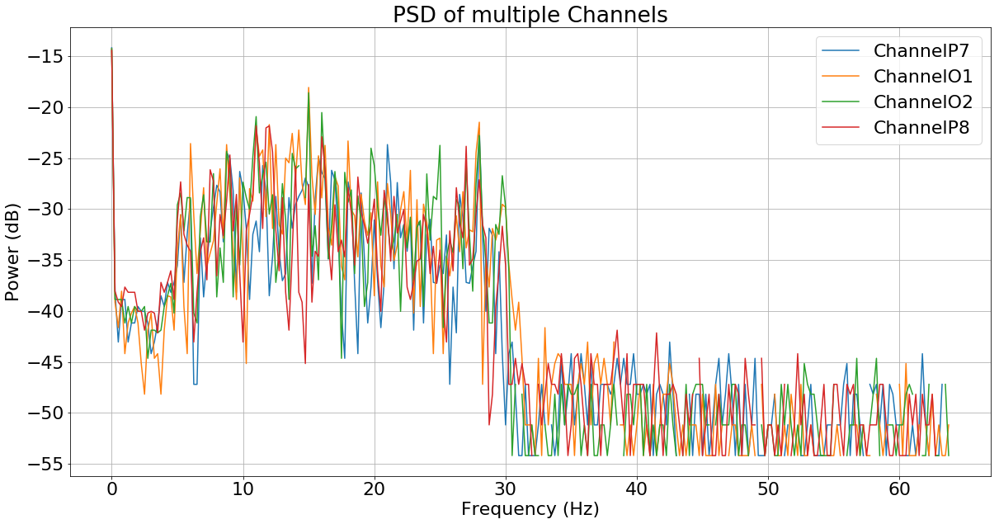

Channel Ouput: [3 4 4 1]
Mode: [3]
Counts: [2]
Iteration 11
POINTER 1408 1920


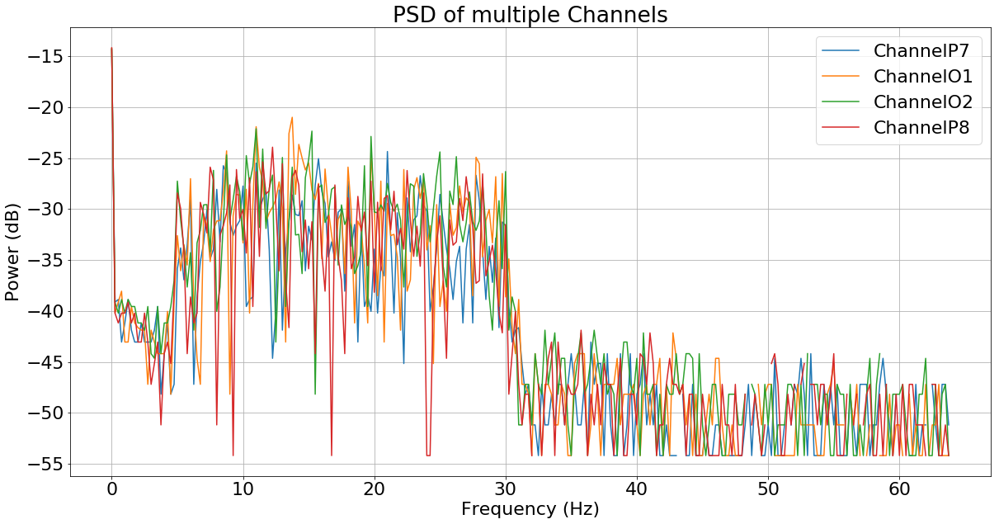

Channel Ouput: [3 4 4 4]
Mode: [3]
Counts: [3]
Detected Class: 4
Iteration 12
POINTER 1536 2048


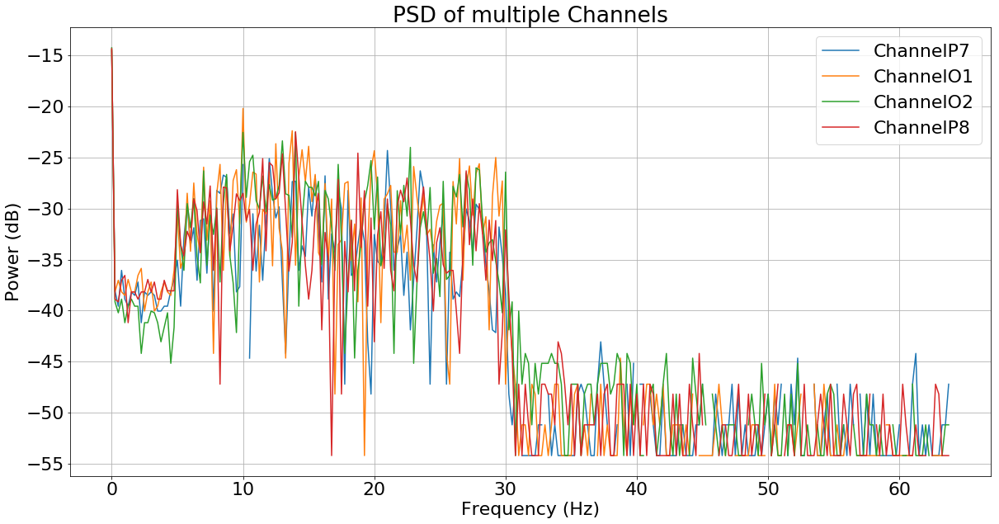

Channel Ouput: [1 2 2 1]
Mode: [0]
Counts: [2]
Iteration 13
POINTER 1664 2176


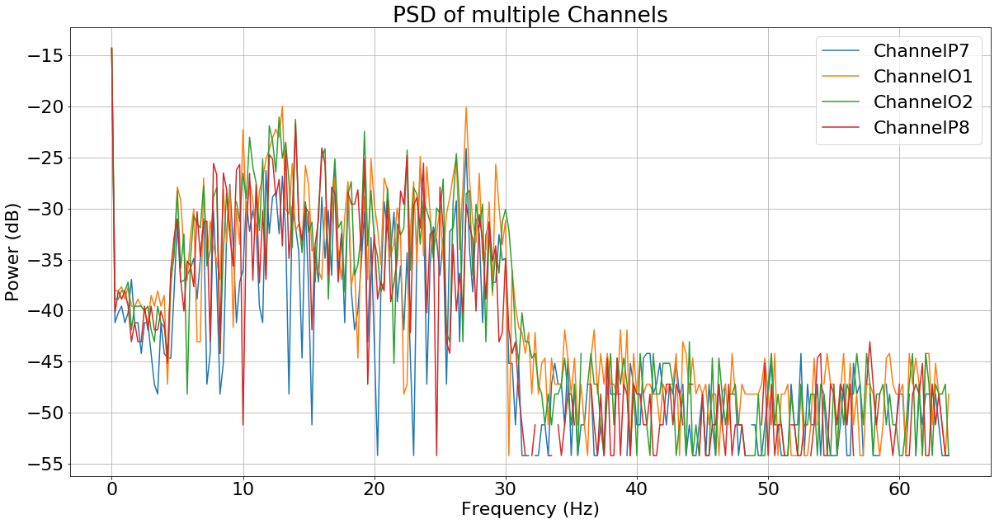

Channel Ouput: [3 2 1 5]
Mode: [0]
Counts: [1]
Iteration 14
POINTER 1792 2304


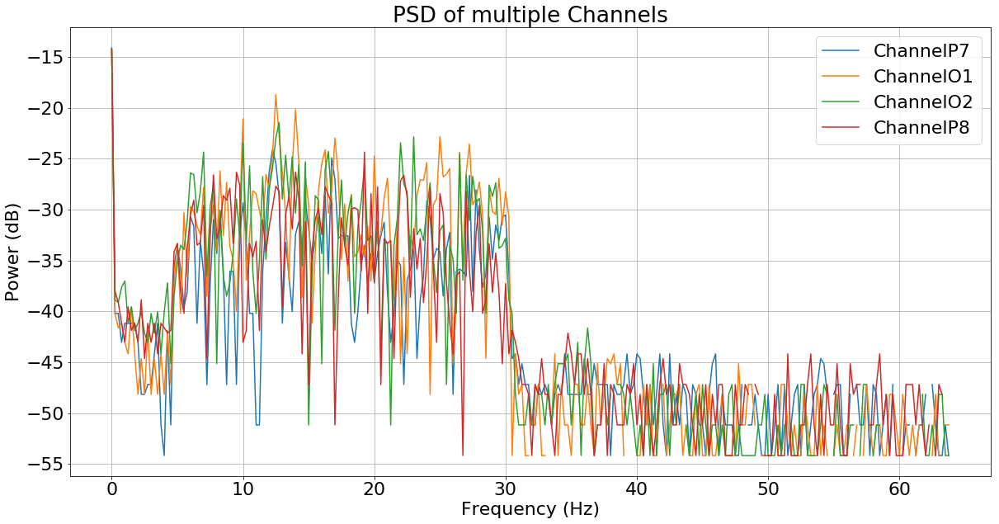

Channel Ouput: [1 2 2 3]
Mode: [1]
Counts: [2]
Iteration 15
POINTER 1920 2432


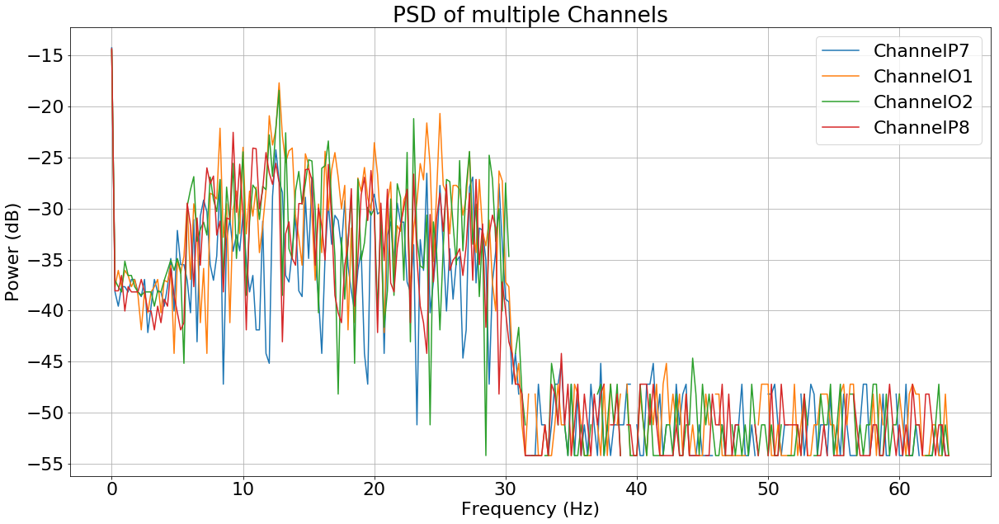

Channel Ouput: [2 1 1 4]
Mode: [0]
Counts: [2]
Iteration 16
POINTER 2048 2560


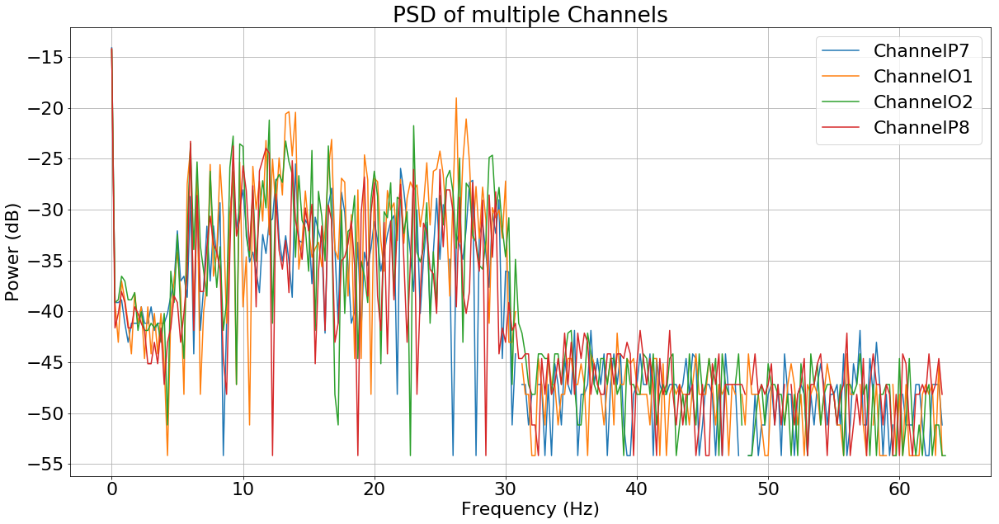

Channel Ouput: [2 5 1 2]
Mode: [1]
Counts: [2]
Iteration 17
POINTER 2176 2688


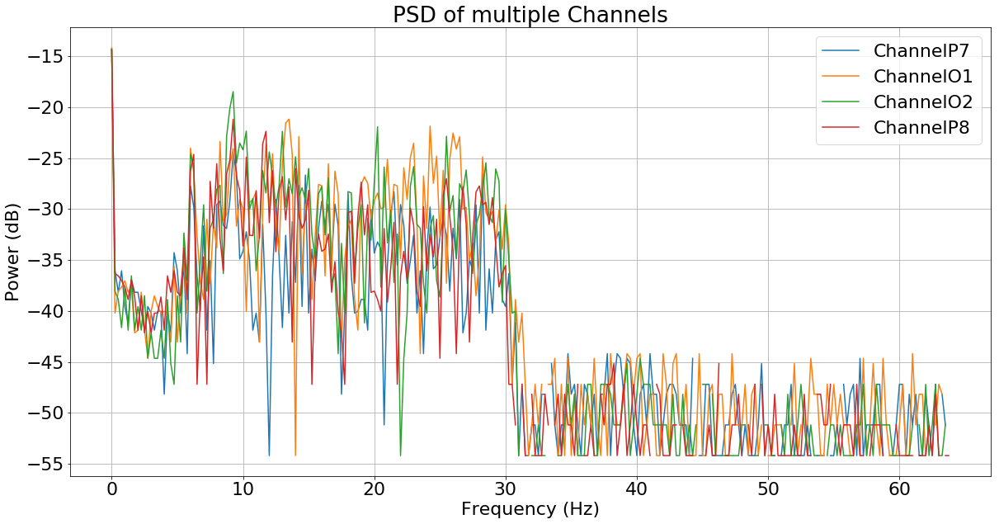

Channel Ouput: [3 5 2 4]
Mode: [1]
Counts: [1]
Iteration 18
POINTER 2304 2816


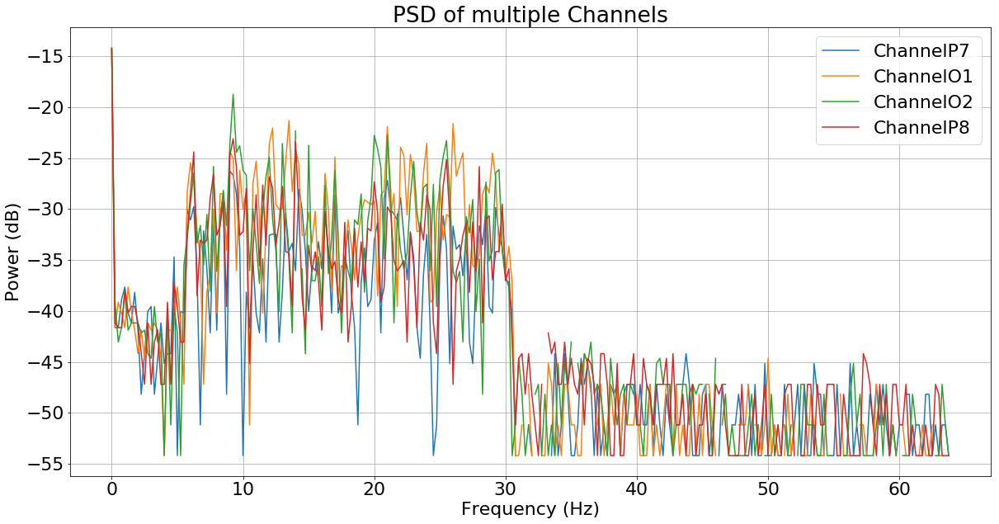

Channel Ouput: [3 1 2 1]
Mode: [0]
Counts: [2]
Iteration 19
POINTER 2432 2944


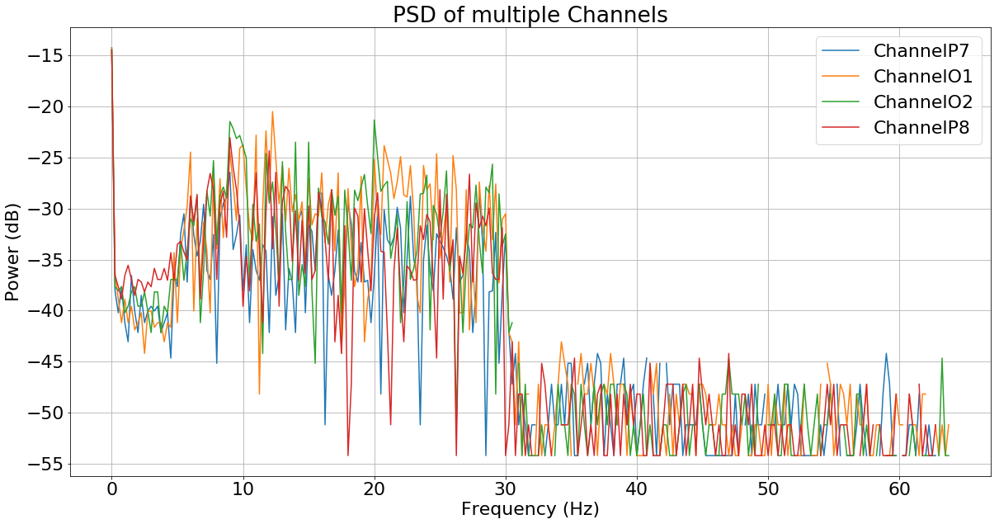

Channel Ouput: [3 2 2 1]
Mode: [1]
Counts: [2]
Iteration 20
POINTER 2560 3072


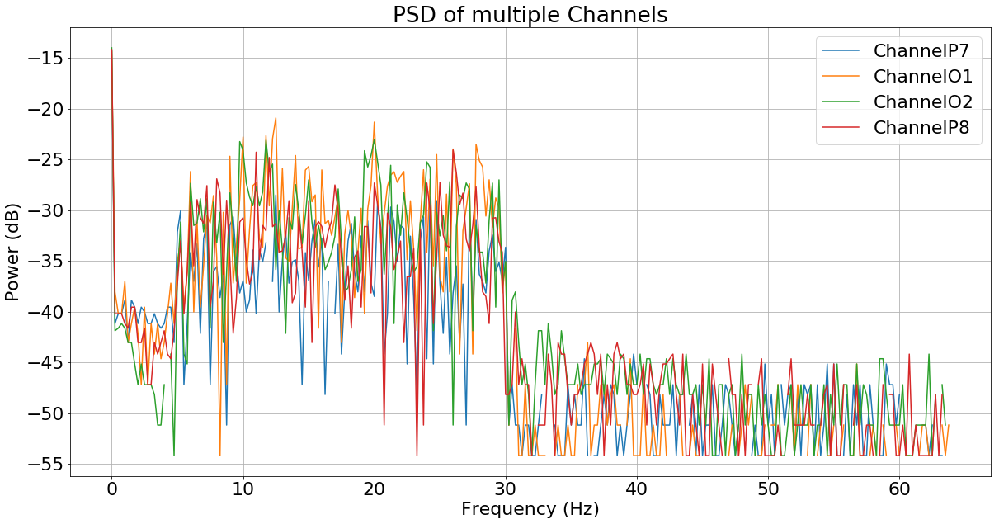

Channel Ouput: [5 2 2 1]
Mode: [1]
Counts: [2]
Iteration 21
POINTER 2688 3200


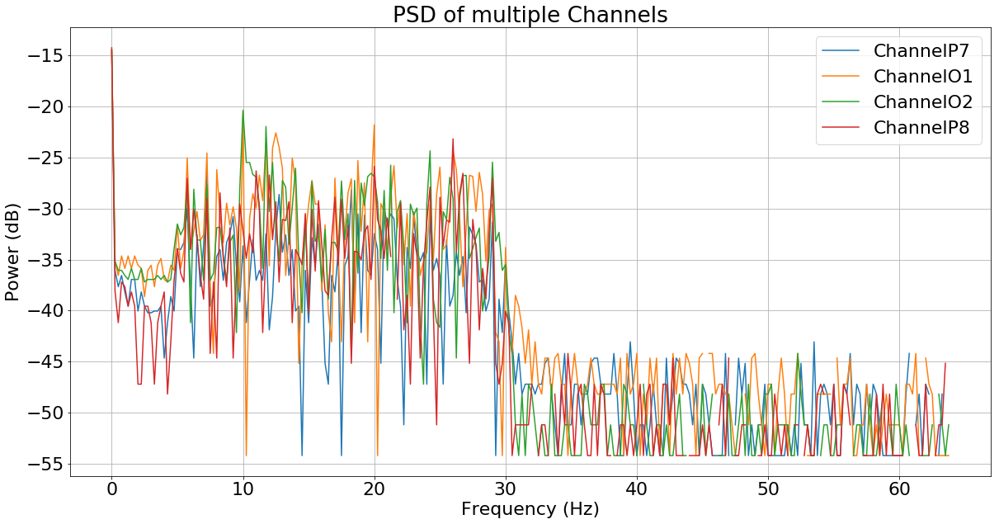

Channel Ouput: [5 2 2 2]
Mode: [1]
Counts: [3]
Detected Class: 2
Iteration 22
POINTER 2816 3328


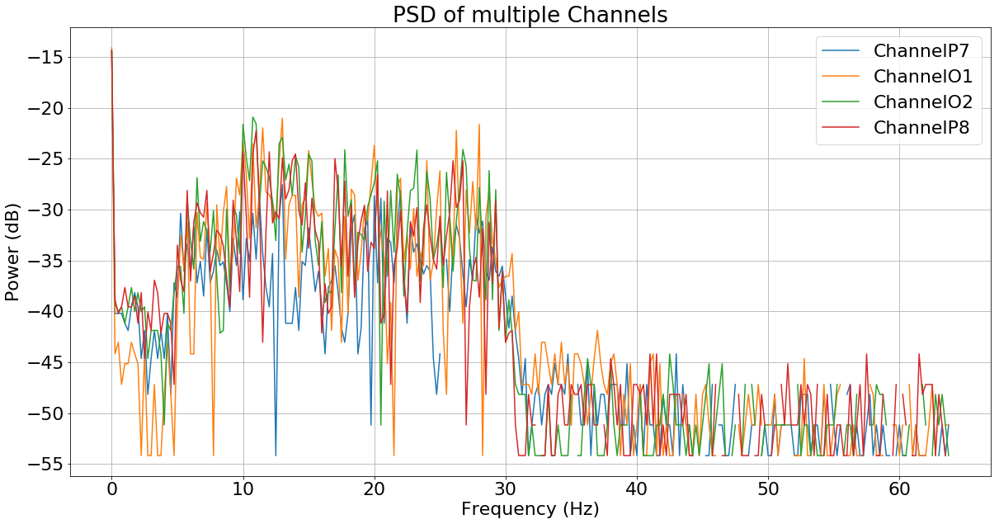

Channel Ouput: [2 2 2 1]
Mode: [1]
Counts: [3]
Detected Class: 2
Iteration 23
POINTER 2944 3456


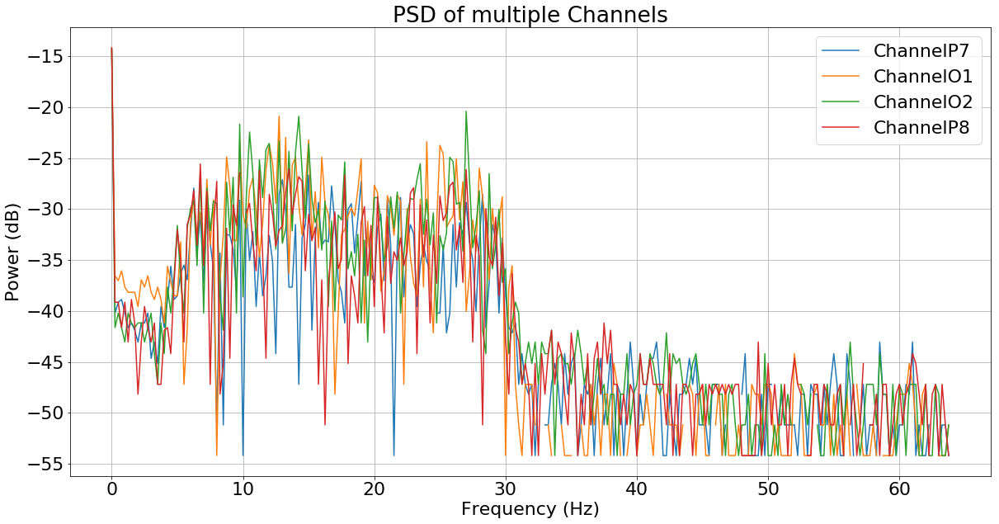

Channel Ouput: [4 1 1 1]
Mode: [0]
Counts: [3]
Detected Class: 1
Iteration 24
POINTER 3072 3584


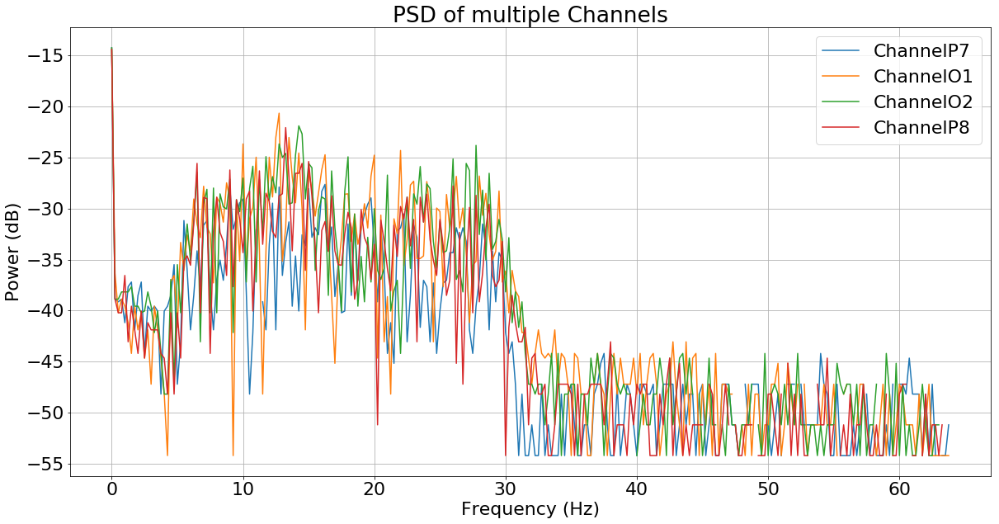

Channel Ouput: [4 2 5 5]
Mode: [4]
Counts: [2]
Iteration 25
POINTER 3200 3712


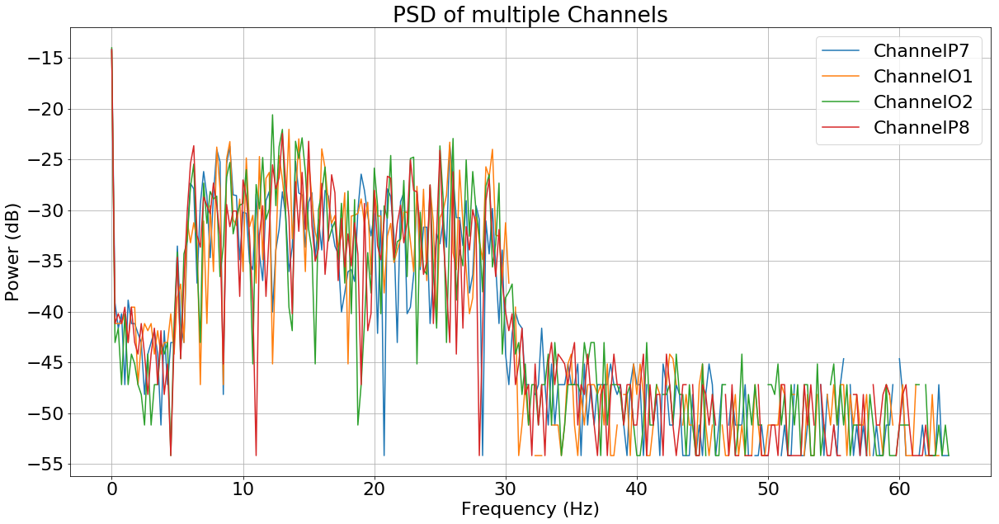

Channel Ouput: [1 4 2 4]
Mode: [3]
Counts: [2]
Iteration 26
POINTER 3328 3840


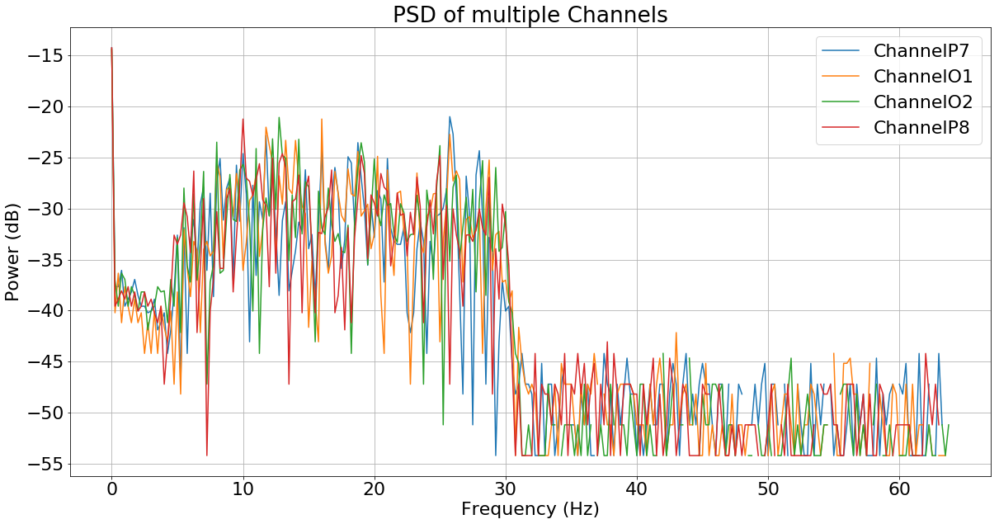

Channel Ouput: [2 5 2 2]
Mode: [1]
Counts: [3]
Detected Class: 2
Iteration 27
POINTER 3456 3968


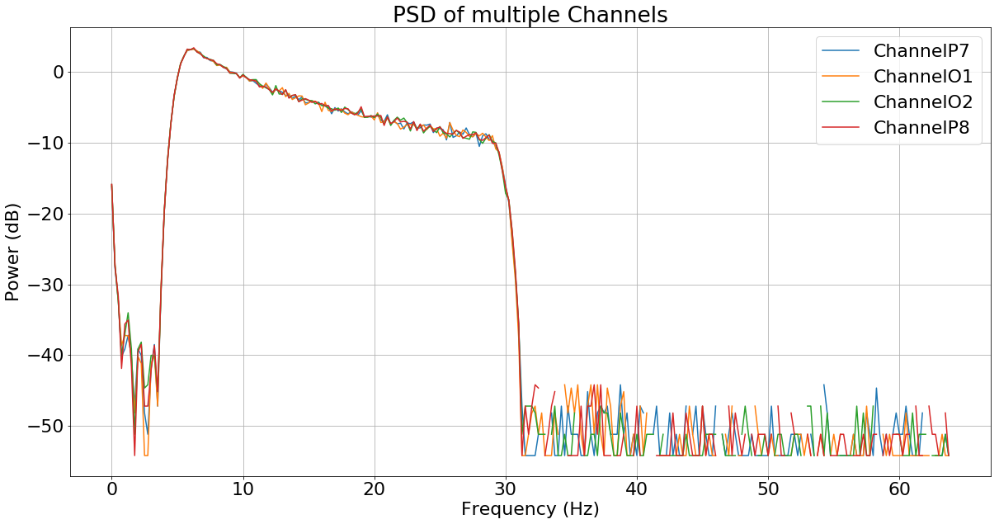

Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 28
POINTER 3584 4096


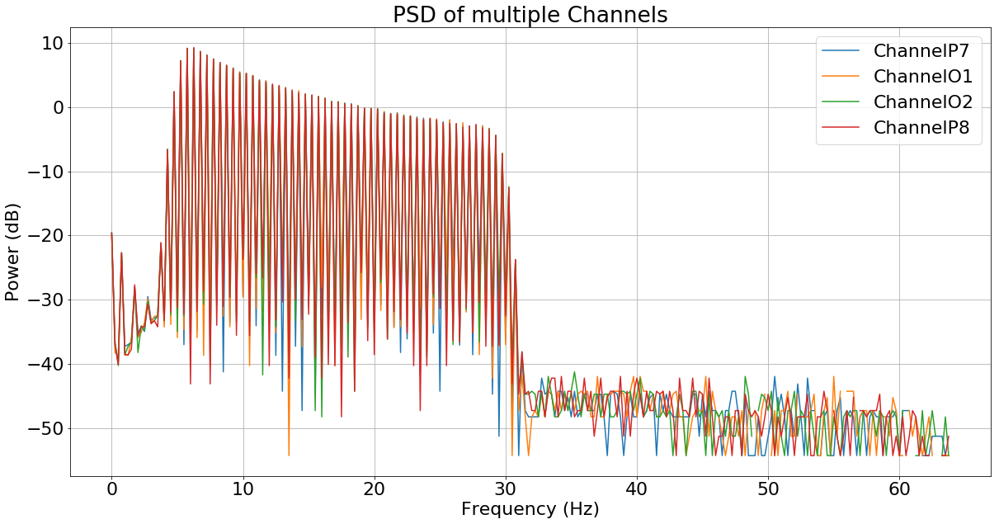

Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 29
POINTER 3712 4224


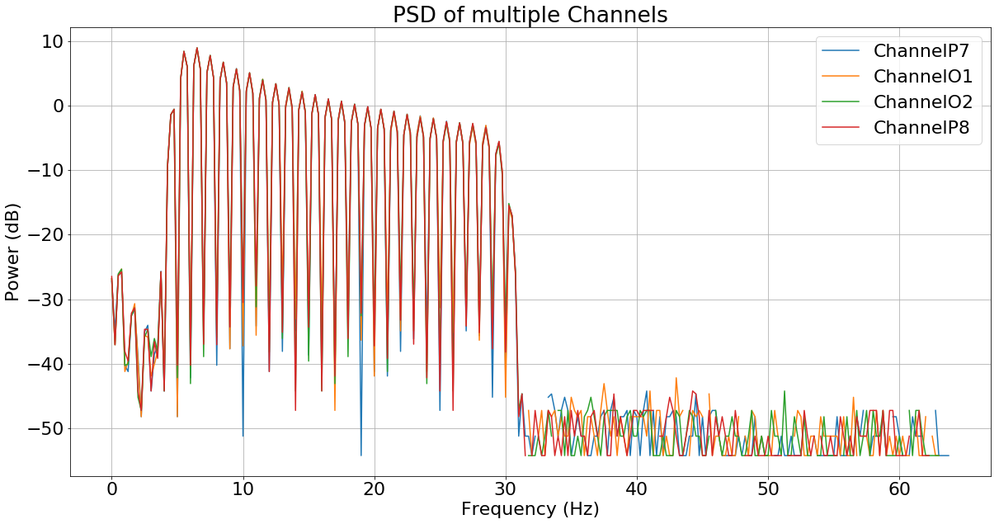

Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 30
POINTER 3840 4352


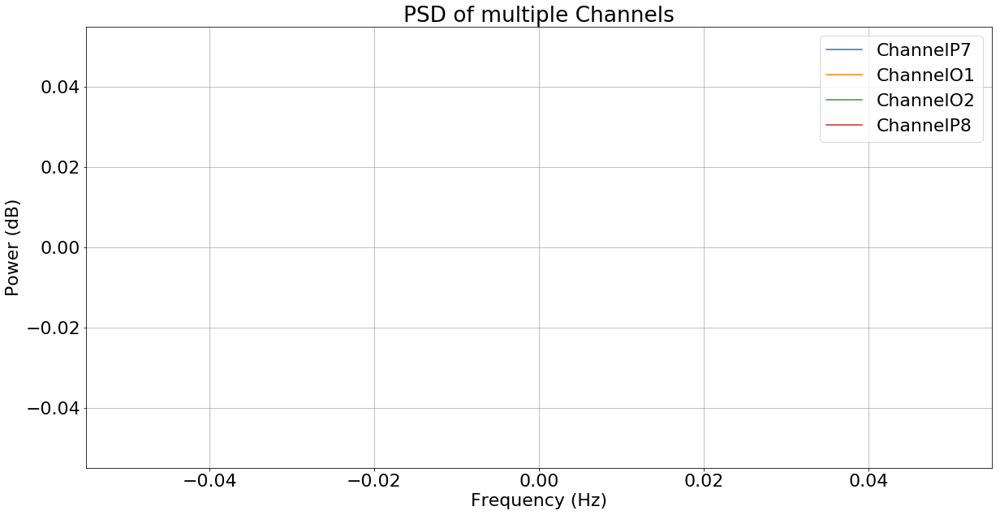

Channel Ouput: [         1 1077149697          1 1076101121]
Mode: [0]
Counts: [2]
Iteration 31
POINTER 3968 4480


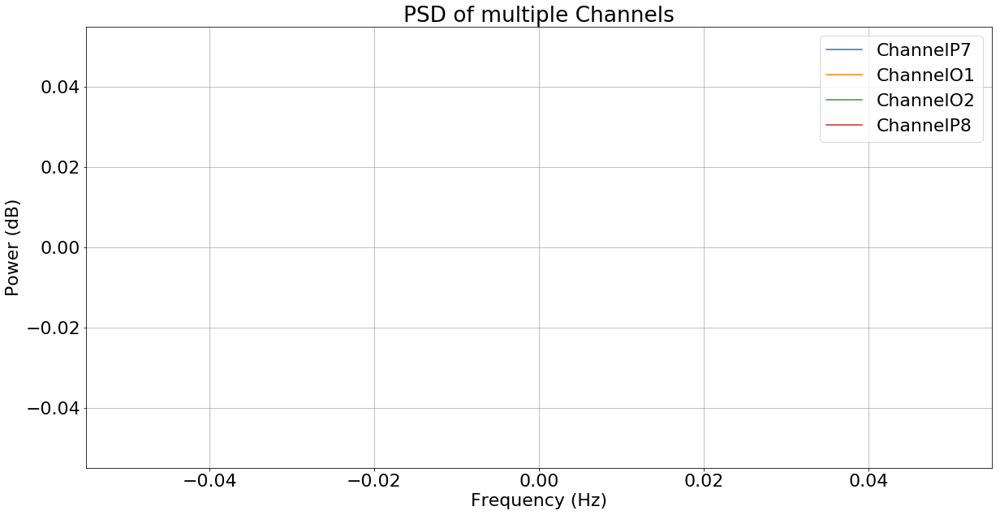

Channel Ouput: [         1 1077149697          1 1076101121]
Mode: [0]
Counts: [2]


In [10]:
processingTime_df = pd.DataFrame([], columns=["Data Pointer","Time stamp", "Frame Duration"])
coeffs = overlay.filter_design(f_samp, 5, 48)
data = np.array([eeg["P7"],eeg["O1"],eeg["O2"],eeg["P8"]])

test_duration = 30

data = data[:,0:f_samp*test_duration] * 100
data = np.asarray(data, np.int32)
overlay.pynq_BCI_DSP(data, NFFT, f_samp, overlap = .25, multichannel=True, plot_data=True)

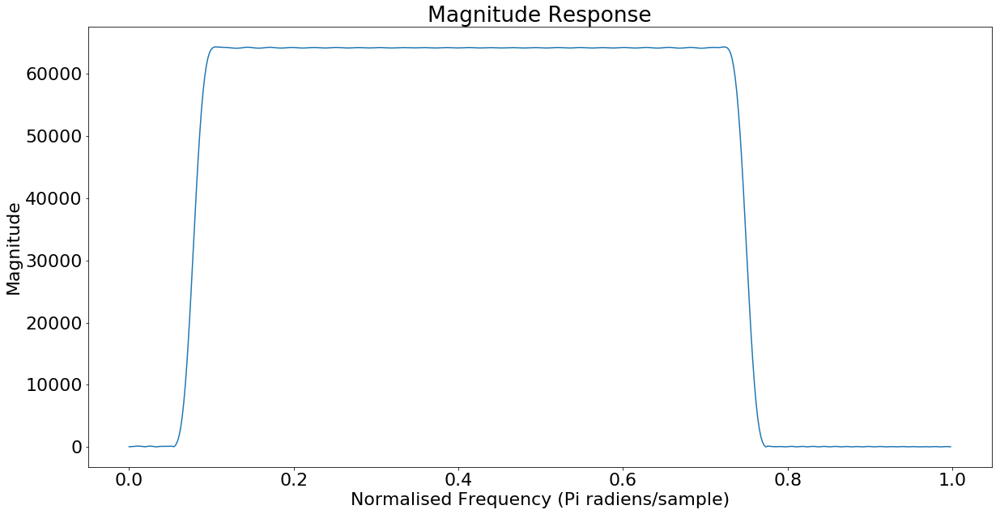

Appending () zeros to the signal
Number of iterations 36.0
Iteration 0
POINTER 0 512
HW FIR excl Transfer latencies: 0.0007669925689697266
HW FIR: 0.11333322525024414
HW FFT excl Transfer latencies: 0.0005102339999893957
HW FFT: 0.07054281234741211
Fundamental Frequency Peaks
[ 152776.  215917.  314522.  374884.  494404.]
1st Harmonic Frequency Peaks
[  36548.   55634.   81412.   96610.  138125.]


AVG PEAK 5 316264.5
AVG PEAK 4 235747.0
AVG PEAK 3 197967.0
AVG PEAK 2 135775.5
AVG PEAK 1 94662.0
Detected Class: [5]
Iteration 1
POINTER 128 640
HW FIR excl Transfer latencies: 0.0009770393371582031
HW FIR: 0.0742342472076416
HW FFT excl Transfer latencies: 0.0009050090000073396
HW FFT: 0.09545612335205078
Fundamental Frequency Peaks
[ 274.  629.  377.   90.   73.]
1st Harmonic Frequency Peaks
[ 250.  596.   97.  394.   25.]


AVG PEAK 5 49.0
AVG PEAK 4 242.0
AVG PEAK 3 237.0
AVG PEAK 2 612.5
AVG PEAK 1 262.0
Iteration 2
POINTER 256 768
HW FIR excl Transfer latencies: 0.0009722709655761719

Detected Class: [2]
Iteration 20
POINTER 2560 3072
HW FIR excl Transfer latencies: 0.0009777545928955078
HW FIR: 0.07348752021789551
HW FFT excl Transfer latencies: 0.0008591509999860136
HW FFT: 0.08706116676330566
Fundamental Frequency Peaks
[  625.  1021.    13.    18.   196.]
1st Harmonic Frequency Peaks
[  784.  1300.   145.   521.    16.]


AVG PEAK 5 106.0
AVG PEAK 4 269.5
AVG PEAK 3 79.0
AVG PEAK 2 1160.5
AVG PEAK 1 704.5
Detected Class: [2]
Iteration 21
POINTER 2688 3200
HW FIR excl Transfer latencies: 0.0009579658508300781
HW FIR: 0.07990288734436035
HW FFT excl Transfer latencies: 0.0008515139999758503
HW FFT: 0.10192108154296875
Fundamental Frequency Peaks
[  245.  2402.    89.    52.   130.]
1st Harmonic Frequency Peaks
[ 289.  538.  122.   25.  425.]


AVG PEAK 5 277.5
AVG PEAK 4 38.5
AVG PEAK 3 105.5
AVG PEAK 2 1470.0
AVG PEAK 1 267.0
Detected Class: [2]
Iteration 22
POINTER 2816 3328
HW FIR excl Transfer latencies: 0.000982522964477539
HW FIR: 0.07295775413513184
HW FFT 

In [11]:
time_df = pd.DataFrame([], columns=["Hardware FIR", "Software FIR", "Hardware FFT", "Software FFT"])
processingTime_df = pd.DataFrame([], columns=["Data Pointer","Time stamp", "Frame Duration"])
coeffs = overlay.filter_design(f_samp, 5, 48)
data = eeg["O2"]

test_duration = 36

data = data[0:f_samp*test_duration] * 100
data = np.asarray(data, np.int32)
overlay.pynq_BCI_DSP(data, NFFT, f_samp, overlap = .25, multichannel=False)
processing_time_single_hw = processingTime_df

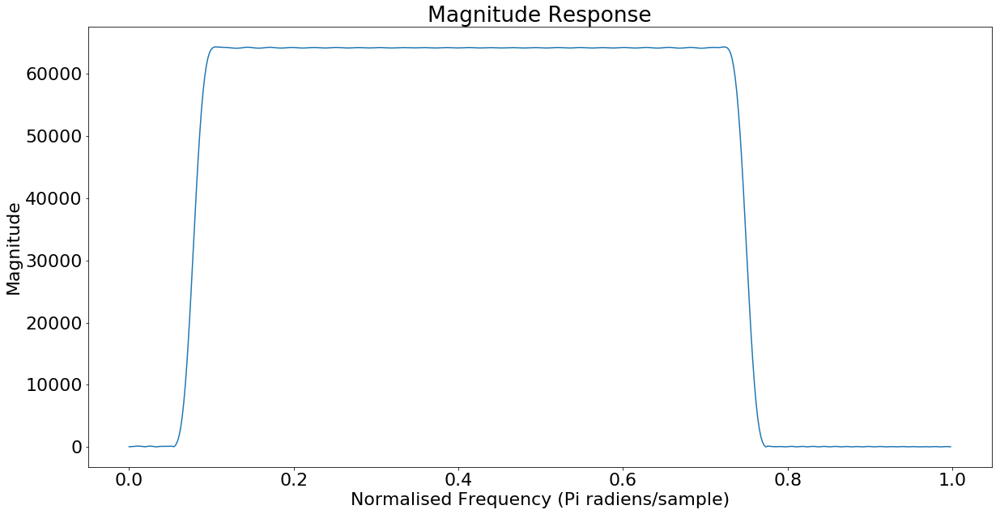

Number of channels: 4
Appending 1 zeros to the signal
Number of iterations 36.0
Iteration 0
POINTER 0 512
Channel Ouput: [2 5 5 5]
Mode: [4]
Counts: [3]
Detected Class: 5
Iteration 1
POINTER 128 640
Channel Ouput: [1 4 2 1]
Mode: [0]
Counts: [2]
Iteration 2
POINTER 256 768
Channel Ouput: [4 1 2 4]
Mode: [3]
Counts: [2]
Iteration 3
POINTER 384 896
Channel Ouput: [1 1 4 4]
Mode: [0]
Counts: [2]
Iteration 4
POINTER 512 1024
Channel Ouput: [3 2 2 3]
Mode: [1]
Counts: [2]
Iteration 5
POINTER 640 1152
Channel Ouput: [3 3 1 4]
Mode: [2]
Counts: [2]
Iteration 6
POINTER 768 1280
Channel Ouput: [3 1 1 2]
Mode: [0]
Counts: [2]
Iteration 7
POINTER 896 1408
Channel Ouput: [2 1 1 2]
Mode: [0]
Counts: [2]
Iteration 8
POINTER 1024 1536
Channel Ouput: [1 4 4 2]
Mode: [3]
Counts: [2]
Iteration 9
POINTER 1152 1664
Channel Ouput: [2 4 4 3]
Mode: [3]
Counts: [2]
Iteration 10
POINTER 1280 1792
Channel Ouput: [3 4 4 1]
Mode: [3]
Counts: [2]
Iteration 11
POINTER 1408 1920
Channel Ouput: [3 4 4 4]
Mode: [3]
Co

In [12]:
processingTime_df = pd.DataFrame([], columns=["Data Pointer","Time stamp", "Frame Duration"])
coeffs = overlay.filter_design(f_samp, 5, 48)
data = np.array([eeg["P7"],eeg["O1"],eeg["O2"],eeg["P8"]])

test_duration = 36

data = data[:,0:f_samp*test_duration] * 100
data = np.asarray(data, np.int32)
overlay.pynq_BCI_DSP(data, NFFT, f_samp, overlap = .25, multichannel=True)
processing_time_multi_hw = processingTime_df

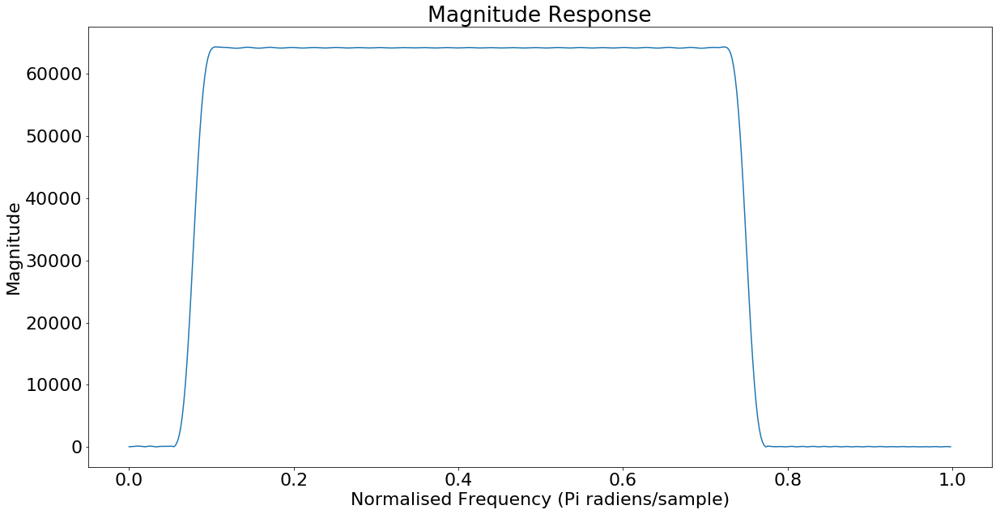

Number of channels: 4
Appending 1 zeros to the signal
Number of iterations 36.0
Iteration 0
POINTER 0 512
Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 1
POINTER 128 640
Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 2
POINTER 256 768
Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 3
POINTER 384 896
Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 4
POINTER 512 1024
Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 5
POINTER 640 1152
Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 6
POINTER 768 1280
Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 7
POINTER 896 1408
Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 8
POINTER 1024 1536
Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
Detected Class: 5
Iteration 9
POINTER 1152 1664
Channel Ouput: [5 5 5 5]
Mode: [4]
Counts: [4]
De

In [13]:
processingTime_df = pd.DataFrame([], columns=["Data Pointer","Time stamp", "Frame Duration"])
coeffs = overlay.filter_design(f_samp, 5, 48)
data = np.array([eeg["P7"],eeg["O1"],eeg["O2"],eeg["P8"]])

test_duration = 36

data = data[:,0:f_samp*test_duration] * 100
data = np.asarray(data, np.int32)
overlay.pynq_BCI_DSP(data, NFFT, f_samp, overlap = .25, multichannel=True, Software_Test=True)
processing_time_multi_sw = processingTime_df

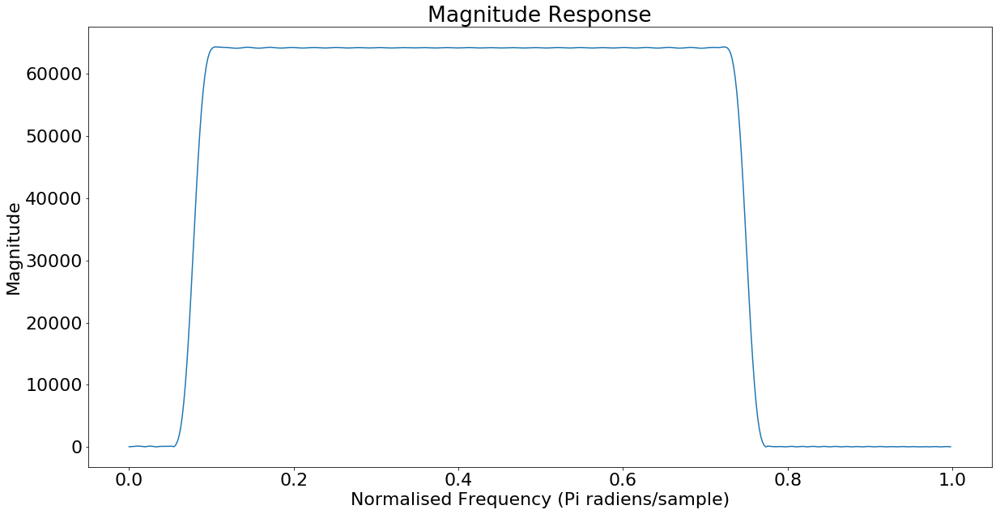

Appending () zeros to the signal
Number of iterations 36.0
Iteration 0
POINTER 0 512
SW FIR: 0.0031239986419677734
SW FFT: 0.0017199516296386719
Fundamental Frequency Peaks
[  2.11767079e+21   3.03245528e+21   4.37727500e+21   5.15426211e+21
   6.94735725e+21]
1st Harmonic Frequency Peaks
[  5.11124809e+20   7.81219724e+20   1.13508079e+21   1.35094411e+21
   1.93766864e+21]


AVG PEAK 5 4.44251294414e+21
AVG PEAK 4 3.25260311244e+21
AVG PEAK 3 2.75617789443e+21
AVG PEAK 2 1.90683750317e+21
AVG PEAK 1 1.31439780011e+21
Detected Class: [5]
Iteration 1
POINTER 128 640
SW FIR: 0.003370523452758789
SW FFT: 0.0016789436340332031
Fundamental Frequency Peaks
[  2.21988241e+21   3.23157591e+21   4.17670192e+21   5.53405615e+21
   7.44915380e+21]
1st Harmonic Frequency Peaks
[  5.55382561e+20   8.75782375e+20   1.09669238e+21   1.27928913e+21
   1.74637533e+21]


AVG PEAK 5 4.59776456611e+21
AVG PEAK 4 3.40667263772e+21
AVG PEAK 3 2.63669714962e+21
AVG PEAK 2 2.05367914451e+21
AVG PEAK 1 1.3876

Fundamental Frequency Peaks
[  2.49965308e+21   2.91438809e+21   4.24134915e+21   5.59107313e+21
   7.17660798e+21]
1st Harmonic Frequency Peaks
[  5.70653014e+20   7.77033793e+20   1.07594805e+21   1.47797401e+21
   1.78301386e+21]


AVG PEAK 5 4.47981091948e+21
AVG PEAK 4 3.53452356854e+21
AVG PEAK 3 2.65864860062e+21
AVG PEAK 2 1.84571094318e+21
AVG PEAK 1 1.53515304501e+21
Detected Class: [5]
Iteration 18
POINTER 2304 2816
SW FIR: 0.0028619766235351562
SW FFT: 0.0016586780548095703
Fundamental Frequency Peaks
[  2.45342614e+21   2.76339209e+21   4.21253744e+21   5.26182185e+21
   7.21267633e+21]
1st Harmonic Frequency Peaks
[  6.67208741e+20   7.63387888e+20   1.24883466e+21   1.63632508e+21
   1.63081239e+21]


AVG PEAK 5 4.42174435773e+21
AVG PEAK 4 3.44907346555e+21
AVG PEAK 3 2.7306860489e+21
AVG PEAK 2 1.76338998726e+21
AVG PEAK 1 1.56031744266e+21
Detected Class: [5]
Iteration 19
POINTER 2432 2944
SW FIR: 0.003259897232055664
SW FFT: 0.0016672611236572266
Fundamental Frequenc

Fundamental Frequency Peaks
[  2.04761893e+21   2.97077029e+21   4.08251758e+21   5.21768576e+21
   7.13237624e+21]
1st Harmonic Frequency Peaks
[  5.96428447e+20   7.74805035e+20   1.08485756e+21   1.48681658e+21
   1.71437570e+21]


AVG PEAK 5 4.42337596984e+21
AVG PEAK 4 3.35225116827e+21
AVG PEAK 3 2.58368757189e+21
AVG PEAK 2 1.87278766132e+21
AVG PEAK 1 1.32202368982e+21
Detected Class: [5]
Iteration 35
POINTER 4480 4992
SW FIR: 0.002409219741821289
SW FFT: 0.0013322830200195312
Fundamental Frequency Peaks
[  2.13489919e+21   3.01309088e+21   4.21904334e+21   5.25519183e+21
   7.33233640e+21]
1st Harmonic Frequency Peaks
[  6.00074002e+20   7.54809972e+20   1.10142440e+21   1.48522171e+21
   1.76789543e+21]


AVG PEAK 5 4.55011591102e+21
AVG PEAK 4 3.37020676773e+21
AVG PEAK 3 2.66023386998e+21
AVG PEAK 2 1.88395042622e+21
AVG PEAK 1 1.36748659592e+21
Detected Class: [5]


In [14]:
processingTime_df = pd.DataFrame([], columns=["Data Pointer","Time stamp", "Frame Duration"])
coeffs = overlay.filter_design(f_samp, 5, 48)
data = eeg["O2"]

test_duration = 36

data = data[0:f_samp*test_duration] * 100
data = np.asarray(data, np.int32)
overlay.pynq_BCI_DSP(data, NFFT, f_samp, overlap = .25, multichannel=False, Software_Test = True)
processing_time_single_sw = processingTime_df

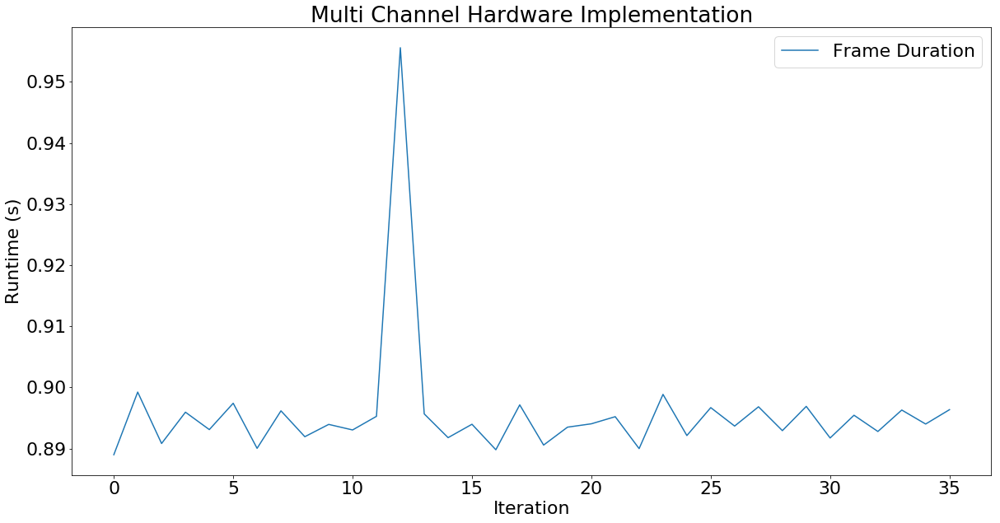

,Data Pointer,Time stamp,Frame Duration
0,0,0.889570,0.888999
1,128,1.810766,0.899246
2,256,2.721466,0.890833
3,384,3.638340,0.895957
4,512,4.551596,0.893109
5,640,5.469185,0.897421
6,768,6.379076,0.890043
7,896,7.295502,0.896180
8,1024,8.207636,0.891948
9,1152,9.121490,0.893960


In [15]:
plt.plot(processing_time_multi_hw["Frame Duration"])
plt.title("Multi Channel Hardware Implementation")
plt.xlabel("Iteration")
plt.ylabel("Runtime (s)")
plt.legend()
plt.show()
processing_time_multi_hw.head(10)

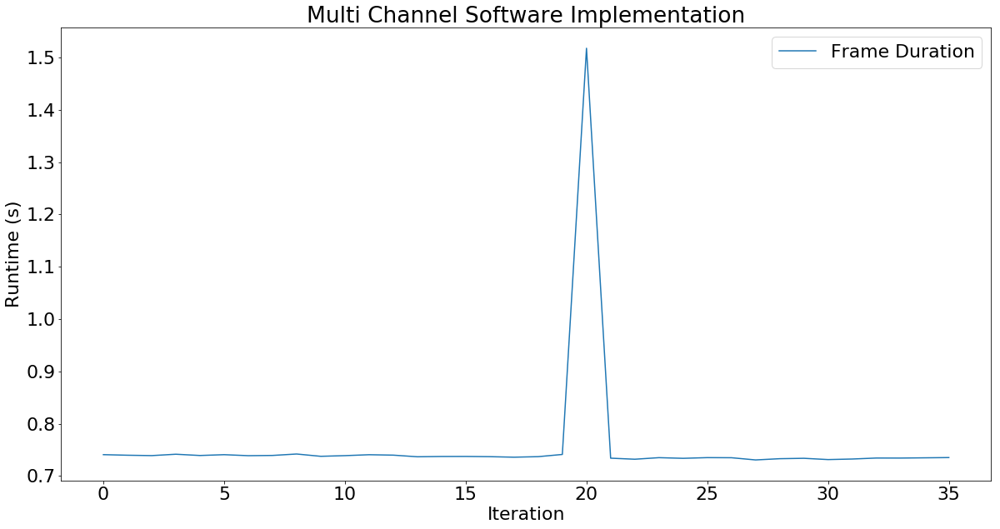

,Data Pointer,Time stamp,Frame Duration
0,0,0.741449,0.740872
1,128,1.503302,0.739764
2,256,2.262295,0.739044
3,384,3.024307,0.741671
4,512,3.783527,0.739253
5,640,4.544453,0.740808
6,768,5.303333,0.738904
7,896,6.063038,0.739357
8,1024,6.825398,0.742094
9,1152,7.583045,0.737697


In [16]:

plt.plot(processing_time_multi_sw["Frame Duration"])
plt.title("Multi Channel Software Implementation")
plt.xlabel("Iteration")
plt.ylabel("Runtime (s)")
plt.legend()
plt.show()
processing_time_multi_sw.head(10)

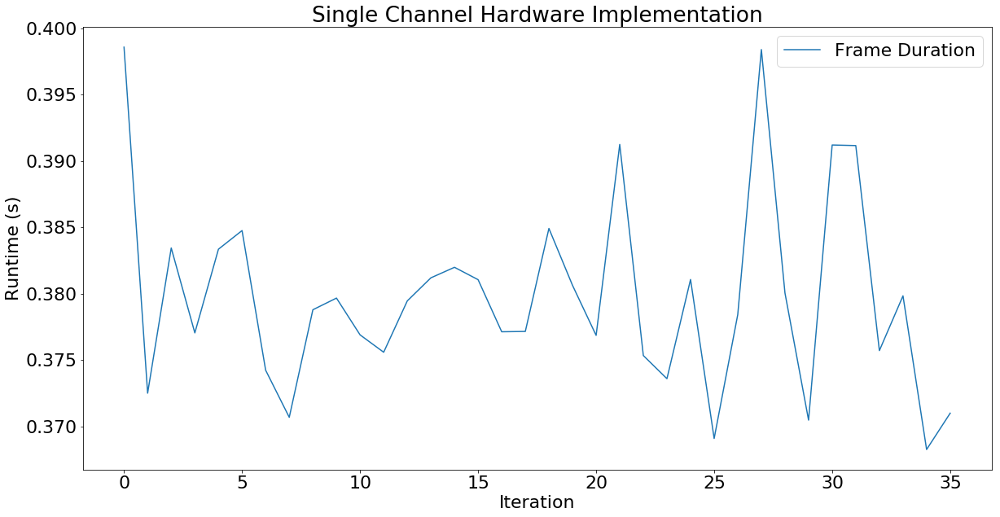

,Data Pointer,Time stamp,Frame Duration
0,0,0.399229,0.398584
1,128,0.792917,0.372517
2,256,1.195916,0.383457
3,384,1.592851,0.377061
4,512,1.996053,0.383364
5,640,2.400319,0.384768
6,768,2.794548,0.374248
7,896,3.185132,0.370700
8,1024,3.586160,0.378802
9,1152,3.985689,0.379681


In [17]:

plt.plot(processing_time_single_hw["Frame Duration"])
plt.title("Single Channel Hardware Implementation")
plt.xlabel("Iteration")
plt.ylabel("Runtime (s)")
plt.legend()
plt.show()
processing_time_single_hw.head(10)

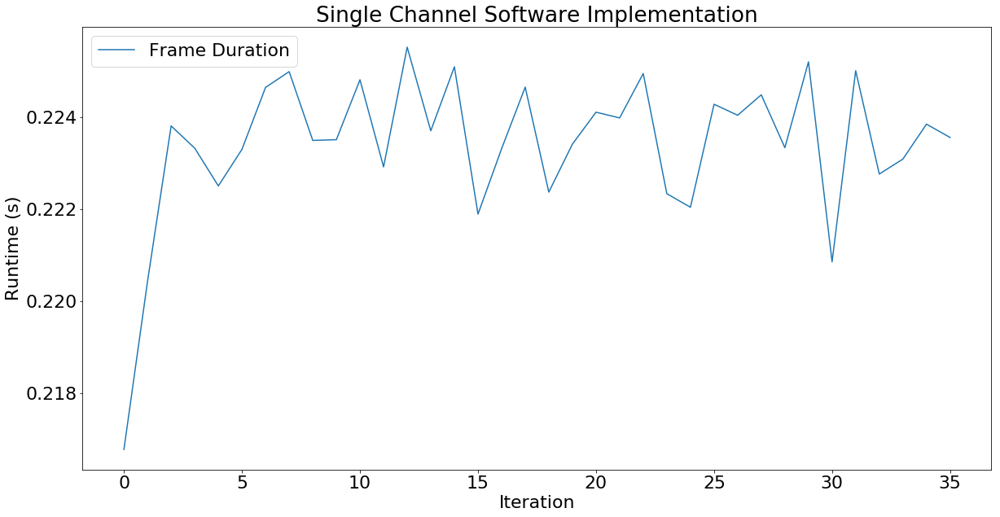

,Data Pointer,Time stamp,Frame Duration
0,0,0.217404,0.216786
1,128,0.460720,0.220438
2,256,0.704833,0.223815
3,384,0.948402,0.223331
4,512,1.191149,0.222512
5,640,1.434816,0.223306
6,768,1.679704,0.224652
7,896,1.924583,0.224995
8,1024,2.168247,0.223500
9,1152,2.411532,0.223516


In [18]:

plt.plot(processing_time_single_sw["Frame Duration"])
plt.title("Single Channel Software Implementation")
plt.xlabel("Iteration")
plt.ylabel("Runtime (s)")
plt.legend()
plt.show()
processing_time_single_sw.head(10)

In [19]:
def get_Labels(matfile):    
    events = matfile["events"]
    event_pos = events[:,2]
    events_typ = events[:,1]
    trialIndices = event_pos[events_typ==33025]
    trialIndices = np.append(trialIndices, event_pos[events_typ==33026])
    trialIndices = np.append(trialIndices, event_pos[events_typ==33027])
    trialIndices = np.append(trialIndices, event_pos[events_typ==33028])
    trialIndices = np.append(trialIndices, event_pos[events_typ==33029])
    trialIndices = np.sort(trialIndices)
    trialIndices = np.vstack((trialIndices, event_pos[events_typ==32779]))
    trialIndices = np.vstack((trialIndices, event_pos[events_typ==32780]))
    trialIndices = np.vstack((trialIndices, [4,   2,  2,  5,     1,  3,     5,     4,   2,  3,      1, 5]))
    trialIndices = np.vstack((trialIndices, [7.5, 10, 10, 6.66,  12, 8.57,  6.66,  7.5, 10,  8.57,  12,6.66]))
    trialIndices = np.vstack((trialIndices, [15,  20, 20, 13.32, 24, 17.14, 13.32, 15,  20,  17.14, 24, 13.32]))
    return pd.DataFrame(trialIndices, ["Prep time", "Begin Time", "End TIme", "Class", "Stim Frequency", "1st Harmonic"]).T

In [20]:
get_Labels(loadmat("/home/xilinx/assets/eeg_data/U001bi.mat"))

,Prep time,Begin Time,End TIme,Class,Stim Frequency,1st Harmonic
0,881.0,1009.0,1649.0,4.0,7.50,15.00
1,2289.0,2417.0,3057.0,2.0,10.00,20.00
2,3697.0,3825.0,4465.0,2.0,10.00,20.00
3,5105.0,5233.0,5873.0,5.0,6.66,13.32
4,6513.0,6641.0,7281.0,1.0,12.00,24.00
5,7921.0,8049.0,8689.0,3.0,8.57,17.14
6,9329.0,9457.0,10097.0,5.0,6.66,13.32
7,10737.0,10865.0,11505.0,4.0,7.50,15.00
8,12145.0,12273.0,12913.0,2.0,10.00,20.00
9,13553.0,13681.0,14321.0,3.0,8.57,17.14


In [21]:
print("Multi Channel HW Run time mean"+str(processing_time_multi_hw.mean()))
print("Single Channel HW Run time mean"+str(processing_time_single_hw.mean()))
print("Multi Channel SW Run time mean"+str(processing_time_multi_sw.mean()))
print("Single Channel SW Run time mean"+str(processing_time_single_sw.mean()))

Multi Channel HW Run time meanData Pointer      2240.000000
Time stamp          16.931498
Frame Duration       0.895783
dtype: float64
Single Channel HW Run time meanData Pointer      2240.000000
Time stamp           7.387889
Frame Duration       0.379757
dtype: float64
Multi Channel SW Run time meanData Pointer      2240.000000
Time stamp          14.359104
Frame Duration       0.758498
dtype: float64
Single Channel SW Run time meanData Pointer      2240.000000
Time stamp           4.487598
Frame Duration       0.223405
dtype: float64


In [22]:
print("Noise Test")

Noise Test


In [23]:
matfile = loadmat("/home/xilinx/assets/eeg_data/EID-S.mat")
data = matfile["eeg_close_8sub_1file"][:,0]
fs = 128

processingTime_df = pd.DataFrame([], columns=["Data Pointer","Time stamp", "Frame Duration"])
coeffs = overlay.filter_design(f_samp, 5, 30)

data = data * 100
data = np.asarray(data, np.int32)
overlay.pynq_BCI_DSP(data, NFFT, f_samp, overlap = .25, multichannel=False, plot_data=True)
print(overlay.hits/overlay.max_iters)

FileNotFoundError: [Errno 2] No such file or directory: '/home/xilinx/assets/eeg_data/EID-S.mat'

In [ ]:
data

In [ ]:
data[0]

In [ ]:
df = overlay.to_freq_dataframe(20*np.log10(np.abs(scipy.fft(data[1152:1664], 512))), 128)

In [ ]:
plt.plot(df["freq"], df["amplitude"])
plt.title("Pre Filtering Signal Spectrum")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power (dB)")